***
# Unsupervised Learning : Discovering Global Patterns in Cancer Mortality Across Countries Via Clustering Analysis

***
### [**John Pauline Pineda**](https://github.com/JohnPaulinePineda) <br> <br> *December 10, 2023*
***

* [**1. Table of Contents**](#TOC)
    * [1.1 Introduction](#1.1)
        * [1.1.1 Study Objectives](#1.1.1)
        * [1.1.2 Outcome](#1.1.2)
        * [1.1.3 Descriptors](#1.1.3)
    * [1.2 Methodology](#1.2)
        * [1.2.1 Data Assessment](#1.2.1)
        * [1.2.2 Feature Selection](#1.2.2)
        * [1.2.3 Model Formulation](#1.2.3)
        * [1.2.4 Model Hyperparameter Tuning](#1.2.4)
        * [1.2.5 Model Performance Evaluation](#1.2.5)
        * [1.2.6 Model Presentation](#1.2.6)
    * [1.3 Results](#1.3)
        * [1.3.1 Data Preparation](#1.3.1)
        * [1.3.2 Data Quality Assessment](#1.3.2)
        * [1.3.3 Data Preprocessing](#1.3.3)
            * [1.3.3.1 Data Cleaning](#1.3.3.1)
            * [1.3.3.2 Outlier Treatment](#1.3.3.2)
            * [1.3.3.3 Collinearity](#1.3.3.3)
            * [1.3.3.4 Shape Transformation](#1.3.3.4)
            * [1.3.3.5 Centering and Scaling](#1.3.3.5)
            * [1.3.3.6 Preprocessed Data Description](#1.3.3.6)
        * [1.3.4 Data Exploration](#1.3.4)
            * [1.3.4.1 Exploratory Data Analysis](#1.3.4.1)
            * [1.3.4.2 Hypothesis Testing](#1.3.4.2)
        * [1.3.5 Model Development](#1.3.5)
            * [1.3.5.1 Premodelling Data Description](#1.3.5.1)
            * [1.3.5.2 K-Means Clustering](#1.3.5.2)
            * [1.3.5.3 Bisecting K-Means Clustering](#1.3.5.3)
            * [1.3.5.4 Gaussian Mixture Clustering](#1.3.5.4)
            * [1.3.5.5 Agglomerative Clustering](#1.3.5.5)
            * [1.3.5.6 Ward Hierarchical Clustering](#1.3.5.6)
        * [1.3.6 Model Selection](#1.3.6) 
        * [1.3.7 Model Presentation](#1.3.7) 
            * [1.3.7.1 Cluster Visualization Plots](#1.3.7.1)
* [**2. Summary**](#Summary)   
* [**3. References**](#References)

***

# 1. Table of Contents <a class="anchor" id="TOC"></a>

## 1.1 Introduction <a class="anchor" id="1.1"></a>

Age-standardized cancer mortality rates refer to the number of deaths attributed to cancer within a specific population over a given period, usually expressed as the number of deaths per 100,000 people adjusted for differences in age distribution. Monitoring cancer mortality rates allows public health authorities to [track the burden of cancer](https://jamanetwork.com/journals/jamaoncology/fullarticle/2787350), [understand the prevalence of different cancer types](https://www.wcrf.org/differences-in-cancer-incidence-and-mortality-across-the-globe/) and [identify variations in different populations](https://ascopubs.org/doi/abs/10.1200/JCO.23.00864). Studying these metrics is essential for making accurate cross-country comparisons, identifying high-risk communities, informing public health policies, and supporting international efforts to address the global burden of cancer. 

Datasets used for the analysis were separately gathered and consolidated from various sources including: 
1. Cancer Deaths by Type from [OurWorldInData.Org](https://ourworldindata.org/cancer) as obtained from the [Institute for Health Metrics and Evaluation](http://ghdx.healthdata.org/gbd-results-tool)
2. Prevalence of Overweight among Adults from [OurWorldInData.Org](https://ourworldindata.org/obesity) as obtained from [WHO, Global Health Observatory](https://ghoapi.azureedge.net/api/)
3. Prevalence of Daily Smoking Among Adults from [OurWorldInData.Org](https://ourworldindata.org/smoking) as obtained from [WHO, Global Health Observatory](https://ghoapi.azureedge.net/api/)
4. Total Alcohol Consumption from [OurWorldInData.Org](https://ourworldindata.org/alcohol-consumption) as obtained from [WHO, Global Health Observatory](https://ghoapi.azureedge.net/api/)
5. Geographic Coordinates from [Geodatos](https://www.geodatos.net/en/coordinates/)
6. Global Map Shape File from [GeoJson-Maps](https://geojson-maps.ash.ms/)

This study hypothesized that mortality rates by major cancer types contain inherent patterns and structures within the data, enabling the grouping of similar countries and the differentiation of dissimilar ones.

Subsequent analysis and modelling steps involving data understanding, data preparation, data exploration, model development, model validation and model presentation were individually detailed below, with all the results consolidated in a [<span style="color: #FF0000"><b>Summary</b></span>](#Summary) provided at the end of the document. 

### 1.1.1 Study Objectives <a class="anchor" id="1.1.1"></a>

**The main objective of the study is to develop a clustering model with an optimal number of clusters that could recognize patterns and relationships among cancer mortality rates across countries, allowing for a deeper understanding of the inherent and underlying data structure when evaluated against supplementary information on lifestyle factors and geolocation.**

Specific objectives are given as follows:

* Obtain an optimal subset of observations and descriptors by conducting data quality assessment and feature selection, excluding cases or variables noted with irregularities and applying preprocessing operations most suitable for the downstream analysis

* Develop multiple clustering models with optimized hyperparameters in terms of the number of clusters through through internal resampling validation

* Select the final clustering model among candidates based on its ability to quantify the compactness and separation of clusters

* Interpret clusters based on inter-cluster patterns and intra-cluster dissimilarities 

* Conduct a post-hoc exploration of the results to provide general insights on the relationship and association among and between the formulated clusters

### 1.1.2 Outcome <a class="anchor" id="1.1.2"></a>

Due to the unspervised learning nature of the analysis, there is no target variable defined for the study.

### 1.1.3 Descriptors <a class="anchor" id="1.1.2"></a>

The clustering descriptors are the primary variables to be evaluated in formulating the clusters for segmenting the countries in the study. 

Detailed descriptions for each individual clustering descriptor are provided as follows:
* <span style="color: #FF0000">PROCAN</span> - Age-standardized prostate cancer death rates, per 100K population (2019)
* <span style="color: #FF0000">BRECAN</span> - Age-standardized breast cancer death rates, per 100K population (2019)
* <span style="color: #FF0000">CERCAN</span> - Age-standardized cervical cancer death rates, per 100K population (2019)
* <span style="color: #FF0000">STOCAN</span> - Age-standardized stomach cancer death rates, per 100K population (2019)
* <span style="color: #FF0000">ESOCAN</span> - Age-standardized esophageal cancer death rates, per 100K population (2019)
* <span style="color: #FF0000">PANCAN</span> - Age-standardized pancreatic cancer death rates, per 100K population (2019)
* <span style="color: #FF0000">LUNCAN</span> - Age-standardized tracheal, bronchus and lung cancer death rates, per 100K population (2019)
* <span style="color: #FF0000">COLCAN</span> - Age-standardized colorectal cancer death rates, per 100K population (2019)
* <span style="color: #FF0000">LIVCAN</span> - Age-standardized liver cancer death rates, per 100K population (2019)

The target descriptors are the secondary variables to where the formulated clusters will be compared with, providing additional context to the findings. 

Detailed descriptions for each individual target descriptor are provided as follows:
* <span style="color: #FF0000">SMPREV</span> - Daily smoking prevalence, proportion of the population for both sexes of all ages, % (2012)
* <span style="color: #FF0000">OWPREV</span> - Age-standardized prevalence of overweight among adults, BMI<=25, % (2016)
* <span style="color: #FF0000">ACSHAR</span> - Total alcohol consumption per capita, liters of pure alcohol, projected estimates, 15+ years of age (2018)

The metadata variables providing geolocation information for the study are:
* <span style="color: #FF0000">COUNTRY</span> - Political unit with sovereignty (legitimate and total political power) over a territory and inhabitants within its borders
* <span style="color: #FF0000">CODE</span> - Unique identifier that represents a geographic entity, by country
* <span style="color: #FF0000">GEOLAT</span> - Latitude coordinates, by country
* <span style="color: #FF0000">GEOLON</span> - Longitude coordinates, by country

## 1.2 Methodology <a class="anchor" id="1.2"></a>


### 1.2.1 Data Assessment <a class="anchor" id="1.2.1"></a>

Preliminary data used in the study was evaluated and prepared for analysis and modelling using the following methods:

[Data Quality Assessment](http://appliedpredictivemodeling.com/) involves profiling and assessing the data to understand its suitability for machine learning tasks. The quality of training data has a huge impact on the efficiency, accuracy and complexity of machine learning tasks. Data remains susceptible to errors or irregularities that may be introduced during collection, aggregation or annotation stage. Issues such as incorrect labels, synonymous categories in a categorical variable or heterogeneity in columns, among others, which might go undetected by standard pre-processing modules in these frameworks can lead to sub-optimal model performance, inaccurate analysis and unreliable decisions.

[Data Preprocessing](http://appliedpredictivemodeling.com/) involves changing the raw feature vectors into a representation that is more suitable for the downstream modelling and estimation processes, including data cleaning, integration, reduction and transformation. Data cleaning aims to identify and correct errors in the dataset that may negatively impact a predictive model such as removing outliers, replacing missing values, smoothing noisy data, and correcting inconsistent data. Data integration addresses potential issues with redundant and inconsistent data obtained from multiple sources through approaches such as detection of tuple duplication and data conflict. The purpose of data reduction is to have a condensed representation of the data set that is smaller in volume, while maintaining the integrity of the original data set. Data transformation converts the data into the most appropriate form for data modeling.

[Data Exploration](http://appliedpredictivemodeling.com/) involves analyzing and investigating data sets to summarize their main characteristics, often employing data visualization methods. It helps determine how best to manipulate data sources to discover patterns, spot anomalies, test a hypothesis, or check assumptions. This process is primarily used to see what data can reveal beyond the formal modeling or hypothesis testing task and provides a better understanding of data set variables and the relationships between them.

[Yeo-Johnson Transformation](https://academic.oup.com/biomet/article-abstract/87/4/954/232908?redirectedFrom=fulltext&login=false) applies a new family of distributions that can be used without restrictions, extending many of the good properties of the Box-Cox power family. Similar to the Box-Cox transformation, the method also estimates the optimal value of lambda but has the ability to transform both positive and negative values by inflating low variance data and deflating high variance data to create a more uniform data set. While there are no restrictions in terms of the applicable values, the interpretability of the transformed values is more diminished as compared to the other methods.

### 1.2.2 Feature Selection <a class="anchor" id="1.2.2"></a>

Statistical test measure assessed for the numeric descriptors in the study to determine the most optimal subset of variables for the subsequent modelling process included the following:

[Pearson’s Correlation Coefficient](https://royalsocietypublishing.org/doi/10.1098/rsta.1896.0007) is a parametric measure of the linear correlation for a pair of features by calculating the ratio between their covariance and the product of their standard deviations. The presence of high absolute correlation values indicate the univariate association among the numeric decriptors.

### 1.2.3 Model Formulation <a class="anchor" id="1.2.3"></a>

[Cluster Analysis](https://link.springer.com/book/10.1007/978-1-4614-6849-3?page=1) is a form of unsupervised learning method aimed at identifying similar structural patterns in an unlabeled data set by segmenting the observations into clusters with shared characteristics as compared to those in other clusters.

This study implemented clustering algorithms which formulated partitioned segments from the data set through the hierarchical (either agglomeratively when smaller clusters are merged into the larger clusters or divisively when larger clusters are divided into smaller clusters) and non-hierarchical (when each observation is placed in exactly one of the mutually exclusive clusters) methods. Models applied in the analysis for clustering high-dimensional were the following:

[K-Means Clustering](https://onlinelibrary.wiley.com/doi/book/10.1002/9780470316801) groups similar data points together into clusters by minimizing the mean distance between geometric points. The algorithm iteratively partitions data sets into a fixed number of non-overlapping k subgroups or clusters wherein each data point belongs to the cluster with the nearest mean cluster center. The process begins by initializing all the coordinates into a pre-defined k number of cluster centers. With every pass of the algorithm, each point is assigned to its nearest cluster center. The cluster centers are then updated to be the centers of all the points assigned to it in that pass. This is performed by re-calculating the cluster centers as the average of the points in each respective cluster. The algorithm repeats until there’s a minimum change of the cluster centers from the last iteration.

[Bisecting K-Means Clustering](https://www.semanticscholar.org/paper/A-Comparison-of-Document-Clustering-Techniques-Steinbach-Karypis/9378a3797d5f815babe7b392a199ea9d8d4f1dcf) is a variant of the traditional K-Means algorithm which iteratively splits clusters into two parts until the desired number of clusters is reached. It is a hierarchical clustering approach that uses a divisive strategy to build a hierarchy of clusters. The algorithm starts with the entire dataset as the initial cluster. The standard K-Means algorithm is implemented to the selected cluster, splitting it into two sub-clusters. Both steps are repeated until the desired number of clusters is reached. In cases when there are multiple clusters present, the algorithm selects the cluster with the largest variance. This results in a hierarchical structure of clusters, and the process can be stopped at any desired level of granularity.

[Gaussian Mixture Clustering](https://www.semanticscholar.org/paper/A-Comparison-of-Document-Clustering-Techniques-Steinbach-Karypis/9378a3797d5f815babe7b392a199ea9d8d4f1dcf) is a probabilistic model that assumes all the data points are generated from a mixture of a finite number of Gaussian distributions with unknown parameters incorporating information about the covariance structure of the data as well as the centers of the latent Gaussians. The algorithm involves initializing the parameters of the Gaussian components using K-means clustering to get initial estimates for the means and the identity matrix as a starting point for the covariance matrices. The expectation-maximization process is applied by calculating the probability of each data point belonging to each Gaussian component using the Bayes' theorem for the expectation step, and updating the parameters of the Gaussian components based on the weighted sum of the data points based on the probabilities determined for the maximization step. Convergence is checked by evaluating whether the log-likelihood of the data has stabilized or reached a maximum. Both steps are iterated until the criteria is met. After convergence, each data point is assigned to the cluster with the highest probability.

[Agglomerative Clustering](https://link.springer.com/book/10.1007/978-981-19-0420-2) builds a hierarchy of clusters. In this algorithm, each data point starts as its own cluster, and the algorithm merges clusters iteratively until a stopping criterion is met. The algorithm starts with each data point as a singleton cluster with the number of initial clusters is equal to the number of data points. The pairwise distance matrix is calculated between all clusters using complete linkage determined as the maximum distance between any two points in the two clusters. The two clusters that have the minimum distance according to the linkage criterion are identified and merged in the next step. The distances between new clusters and all other clusters are recalculated. All previous steps are repeated until the desired number of clusters is reached or until a stopping criterion is met.

[Ward Hierarchical Clustering](https://link.springer.com/book/10.1007/978-981-19-0420-2) creates compact, well-separated clusters by minimizing the variance within each cluster during the merging process. In this algorithm, each data point starts as its own cluster, and the algorithm merges clusters iteratively until a stopping criterion is met. The algorithm starts with each data point as a singleton cluster with the number of initial clusters is equal to the number of data points. The pairwise distance matrix is calculated between all clusters and used as a measure of dissimilarity. For each cluster, the within-cluster variance is computed which evaluates how tightly the data points within a cluster are grouped. The two clusters that, when merged, result in the smallest increase in the within-cluster variance are identified and merged in the next step. The within-cluster variance for the newly formed cluster  are recalculated and the pairwise distance matrix updated. All previous steps are repeated until the desired number of clusters is reached or until a stopping criterion is met.

### 1.2.4 Model Hyperparameter Tuning <a class="anchor" id="1.2.4"></a>

The optimal combination of hyperparameter values which maximized the performance of the various clustering models in the study used the following hyperparameter tuning strategy:

[K-Fold Cross-Validation](http://appliedpredictivemodeling.com/) involves dividing the training set after a random shuffle into a user-defined K number of smaller non-overlapping sets called folds. Each unique fold is assigned as the hold-out test data to assess the model trained from the data set collected from all the remaining K-1 folds. The evaluation score is retained but the model is discarded. The process is recursively performed resulting to a total of K fitted models and evaluated on the K hold-out test sets. All K-computed performance measures reported from the process are then averaged to represent the estimated performance of the model. This approach can be computationally expensive and may be highly dependent on how the data was randomly assigned to their respective folds, but does not waste too much data which is a major advantage in problems where the number of samples is very small.

### 1.2.5 Model Performance Evaluation <a class="anchor" id="1.2.5"></a>

The segmentation performance of the formulated clustering models in the study were compared and evaluated using the following metrics:

[Silhouette Score](https://www.packtpub.com/product/training-systems-using-python-statistical-modeling/9781838823733) assesses the quality of clusters created by a clustering algorithm. It measures how well-separated the clusters are and how similar each data point in a cluster is to the other points in the same cluster compared to the nearest neighboring cluster. The silhouette score ranges from -1 to 1, where a higher value indicates better-defined clusters. The silhouette method requires the computation of the silhouette scores for each data point which is the average dissimilarity of the data point with all other data points in the next-nearest cluster minus the average dissimilarity of the data point to points in the same cluster and divided by the larger of the two numbers. The overall silhouette score for the clustering is the average of the silhouette scores for all data points.

### 1.2.6 Model Presentation <a class="anchor" id="1.2.6"></a>

Model presentation was conducted post-hoc to interpret the formulated clusters based on segmentation patterns and obtain insights based on their  relationship and association. These methods were described as follows:

[Cluster Visualization Plots](https://link.springer.com/book/10.1007/978-1-4614-6849-3?page=1) are graphical representations designed to provide insight into the structure, distribution, and characteristics of clusters formed by clustering algorithms including but not limited to pair plots, heat maps and geographic plots. Pair plots (scatterplot matrices) can be used to visualize relationships between pairs of features within clusters. They provide a comprehensive view of feature distributions and correlations within and between clusters. Heatmaps are useful for visualizing the distribution of features within clusters. They provide a color-coded representation of feature values across clusters, allowing users to identify patterns and differences in the feature profiles of clusters. Geographic maps divide the space into regions based on geolocation data including latitude and longitude. Each region is color-coded to a specific cluster, providing a spatial representation of cluster boundaries.

## 1.3. Results <a class="anchor" id="1.3"></a>

### 1.3.1. Data Preparation <a class="anchor" id="1.3.1"></a>

1. The initial tabular dataset was comprised of 208 observations and 16 variables (including 4 metadata and 12 descriptors).
    * **208 rows** (observations)
    * **16 columns** (variables)
        * **2/16 metadata** (object)
            * <span style="color: #FF0000">COUNTRY</span>
            * <span style="color: #FF0000">CODE</span>
        * **2/16 metadata** (numeric)
            * <span style="color: #FF0000">GEOLAT</span>
            * <span style="color: #FF0000">GEOLON</span>
        * **9/16 clustering descriptors** (numeric)
             * <span style="color: #FF0000">PROCAN</span>
             * <span style="color: #FF0000">BRECAN</span>
             * <span style="color: #FF0000">CERCAN</span>
             * <span style="color: #FF0000">STOCAN</span>
             * <span style="color: #FF0000">ESOCAN</span>
             * <span style="color: #FF0000">PANCAN</span>
             * <span style="color: #FF0000">LUNCAN</span>
             * <span style="color: #FF0000">COLCAN</span>
             * <span style="color: #FF0000">LIVCAN</span>    
        * **3/16 target descriptors** (numeric)
             * <span style="color: #FF0000">SMPREV</span>
             * <span style="color: #FF0000">OWPREV</span>
             * <span style="color: #FF0000">ACSHAR</span>
             

In [1]:
##################################
# Setting the Python Environment
##################################
import os
os.environ["OMP_NUM_THREADS"] = '1'

##################################
# Loading Python Libraries
##################################
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import itertools
%matplotlib inline

from operator import add,mul,truediv
from scipy import stats

from sklearn.preprocessing import PowerTransformer, StandardScaler
from sklearn.model_selection import KFold
from sklearn.cluster import KMeans, AffinityPropagation, MeanShift, SpectralClustering, AgglomerativeClustering, Birch, BisectingKMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score

import geopandas as gpd

In [2]:
##################################
# Setting Global Options
##################################
np.set_printoptions(suppress=True, precision=4)
pd.options.display.float_format = '{:.4f}'.format

In [3]:
##################################
# Defining file paths
##################################
DATASETS_ORIGINAL_PATH = r"datasets\original"
REFERENCES_PATH = r"references"

In [4]:
##################################
# Loading the dataset
# from the DATASETS_ORIGINAL_PATH
##################################
cancer_death_rate = pd.read_csv(os.path.join("..", DATASETS_ORIGINAL_PATH, "CancerDeathsByCountryCode.csv"))

In [5]:
##################################
# Performing a general exploration of the dataset
##################################
print('Dataset Dimensions: ')
display(cancer_death_rate.shape)

Dataset Dimensions: 


(208, 16)

In [6]:
##################################
# Listing the column names and data types
##################################
print('Column Names and Data Types:')
display(cancer_death_rate.dtypes)

Column Names and Data Types:


COUNTRY     object
CODE        object
PROCAN     float64
BRECAN     float64
CERCAN     float64
STOCAN     float64
ESOCAN     float64
PANCAN     float64
LUNCAN     float64
COLCAN     float64
LIVCAN     float64
SMPREV     float64
OWPREV     float64
ACSHAR     float64
GEOLAT     float64
GEOLON     float64
dtype: object

In [7]:
##################################
# Taking a snapshot of the dataset
##################################
cancer_death_rate.head()

,COUNTRY,CODE,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,SMPREV,OWPREV,ACSHAR,GEOLAT,GEOLON
0,Afghanistan,AFG,6.3700,8.6700,3.9000,29.3000,6.9600,2.7200,12.5300,8.4300,10.2700,11.9000,23.0000,0.2100,33.9391,67.7100
1,Albania,ALB,8.8700,6.5000,1.6400,10.6800,1.4400,6.6800,26.6300,9.1500,6.8400,20.5000,57.7000,7.1700,41.1533,20.1683
2,Algeria,DZA,5.3300,7.5800,2.1800,5.1000,1.1500,4.2700,10.4600,8.0500,2.2000,11.2000,62.0000,0.9500,28.0339,1.6596
3,American Samoa,ASM,20.9400,16.8100,5.0200,15.7900,1.5200,5.1900,28.0100,16.5500,7.0200,NaN,NaN,NaN,-14.2710,-170.1322
4,Andorra,AND,9.6800,9.0200,2.0400,8.3000,3.5600,10.2600,34.1800,22.9700,9.4400,26.6000,63.7000,11.0200,42.5462,1.6016


In [8]:
##################################
# Performing a general exploration of the numeric variables
##################################
if (len(cancer_death_rate.select_dtypes(include='number').columns)==0):
    print('No numeric columns identified from the data.')
else:
    print('Numeric Variable Summary:')
    display(cancer_death_rate.describe(include='number').transpose())

Numeric Variable Summary:


,count,mean,std,min,25%,50%,75%,max
PROCAN,208.0000,11.7260,7.6965,2.8100,6.5875,10.0050,13.9900,54.1500
BRECAN,208.0000,11.3350,4.3649,4.6900,8.3975,10.5600,13.0950,37.1000
CERCAN,208.0000,6.0651,5.1204,0.7100,1.8575,4.4800,9.0575,39.9500
STOCAN,208.0000,10.5975,5.8993,3.4000,6.6350,9.1550,13.6725,46.0400
ESOCAN,208.0000,4.8946,4.1320,0.9600,2.3350,3.3100,5.4150,25.7600
PANCAN,208.0000,6.6004,3.0552,1.6000,4.2300,6.1150,8.7450,19.2900
LUNCAN,208.0000,21.0217,11.4489,5.9500,11.3800,20.0200,27.5125,78.2300
COLCAN,208.0000,13.6945,5.5475,4.9400,9.2775,12.7950,17.1325,31.3800
LIVCAN,208.0000,5.9826,9.0501,0.6500,2.8400,3.8950,6.0750,115.2300
SMPREV,186.0000,17.0140,8.0416,3.3000,10.4250,16.4000,22.8500,41.1000


In [9]:
##################################
# Performing a general exploration of the object variable
##################################
if (len(cancer_death_rate.select_dtypes(include='object').columns)==0):
    print('No object columns identified from the data.')
else:
    print('Object Variable Summary:')
    display(cancer_death_rate.describe(include='object').transpose())

Object Variable Summary:


,count,unique,top,freq
COUNTRY,208,208,Afghanistan,1
CODE,203,203,AFG,1


In [10]:
##################################
# Performing a general exploration of the categorical variables
##################################
if (len(cancer_death_rate.select_dtypes(include='category').columns)==0):
    print('No categorical columns identified from the data.')
else:
    print('Categorical Variable Summary:')
    display(cancer_rate.describe(include='category').transpose())

No categorical columns identified from the data.


### 1.3.2 Data Quality Assessment <a class="anchor" id="1.3.2"></a>

Data quality findings based on assessment are as follows:
1. No duplicated rows observed.
2. Missing data noted for 4 variables with Null.Count>0 and Fill.Rate<1.0.
    * <span style="color: #FF0000">CODE</span>: Null.Count = 5, Fill.Rate = 0.976
    * <span style="color: #FF0000">SMPREV</span>: Null.Count = 22, Fill.Rate = 0.894
    * <span style="color: #FF0000">OWPREV</span>: Null.Count = 17, Fill.Rate = 0.918
    * <span style="color: #FF0000">ACSHAR</span>: Null.Count = 21, Fill.Rate = 0.899
3. Missing data noted for 25 observations noted with Missing.Rate>0.0.
    * <span style="color: #FF0000">COUNTRY=Wales</span>: Missing.Rate= 0.250
    * <span style="color: #FF0000">COUNTRY=Northern Ireland</span>: Missing.Rate= 0.250
    * <span style="color: #FF0000">COUNTRY=England</span>: Missing.Rate= 0.250
    * <span style="color: #FF0000">COUNTRY=Tokelau</span>: Missing.Rate= 0.250
    * <span style="color: #FF0000">COUNTRY=Scotland</span>: Missing.Rate= 0.250
    * <span style="color: #FF0000">COUNTRY=American Samoa</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=United States Virgin Islands</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=South Sudan</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=San Marino</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=Puerto Rico</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=Bermuda</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=Northern Mariana Islands</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=Monaco</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=Guam</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=Greenland</span>: Missing.Rate= 0.187
    * <span style="color: #FF0000">COUNTRY=Niue</span>: Missing.Rate= 0.125
    * <span style="color: #FF0000">COUNTRY=Palau</span>: Missing.Rate= 0.125
    * <span style="color: #FF0000">COUNTRY=Palestine</span>: Missing.Rate= 0.125
    * <span style="color: #FF0000">COUNTRY=Taiwan</span>: Missing.Rate= 0.125
    * <span style="color: #FF0000">COUNTRY=Cook Islands</span>: Missing.Rate= 0.125
    * <span style="color: #FF0000">COUNTRY=Nauru</span>: Missing.Rate= 0.062
    * <span style="color: #FF0000">COUNTRY=Micronesia</span>: Missing.Rate= 0.062
    * <span style="color: #FF0000">COUNTRY=Saint Kitts and Nevis</span>: Missing.Rate= 0.062
    * <span style="color: #FF0000">COUNTRY=Marshall Islands</span>: Missing.Rate= 0.062
    * <span style="color: #FF0000">COUNTRY=Tuvalu</span>: Missing.Rate= 0.062
4. No low variance observed for any variable with First.Second.Mode.Ratio>5.
5. No low variance observed for any variable with Unique.Count.Ratio>10.
6. High skewness observed for 1 variable with Skewness>3 or Skewness<(-3).
    * <span style="color: #FF0000">LIVCAN</span>: Skewness = +9.113

In [11]:
##################################
# Counting the number of duplicated rows
##################################
cancer_death_rate.duplicated().sum()

np.int64(0)

In [12]:
##################################
# Gathering the data types for each column
##################################
data_type_list = list(cancer_death_rate.dtypes)

In [13]:
##################################
# Gathering the variable names for each column
##################################
variable_name_list = list(cancer_death_rate.columns)

In [14]:
##################################
# Gathering the number of observations for each column
##################################
row_count_list = list([len(cancer_death_rate)] * len(cancer_death_rate.columns))

In [15]:
##################################
# Gathering the number of missing data for each column
##################################
null_count_list = list(cancer_death_rate.isna().sum(axis=0))

In [16]:
##################################
# Gathering the number of non-missing data for each column
##################################
non_null_count_list = list(cancer_death_rate.count())

In [17]:
##################################
# Gathering the missing data percentage for each column
##################################
fill_rate_list = map(truediv, non_null_count_list, row_count_list)

In [18]:
##################################
# Formulating the summary
# for all columns
##################################
all_column_quality_summary = pd.DataFrame(zip(variable_name_list,
                                              data_type_list,
                                              row_count_list,
                                              non_null_count_list,
                                              null_count_list,
                                              fill_rate_list), 
                                        columns=['Column.Name',
                                                 'Column.Type',
                                                 'Row.Count',
                                                 'Non.Null.Count',
                                                 'Null.Count',                                                 
                                                 'Fill.Rate'])
display(all_column_quality_summary)

,Column.Name,Column.Type,Row.Count,Non.Null.Count,Null.Count,Fill.Rate
0,COUNTRY,object,208,208,0,1.0000
1,CODE,object,208,203,5,0.9760
2,PROCAN,float64,208,208,0,1.0000
3,BRECAN,float64,208,208,0,1.0000
4,CERCAN,float64,208,208,0,1.0000
5,STOCAN,float64,208,208,0,1.0000
6,ESOCAN,float64,208,208,0,1.0000
7,PANCAN,float64,208,208,0,1.0000
8,LUNCAN,float64,208,208,0,1.0000
9,COLCAN,float64,208,208,0,1.0000


In [19]:
##################################
# Counting the number of columns
# with Fill.Rate < 1.00
##################################
len(all_column_quality_summary[(all_column_quality_summary['Fill.Rate']<1)])

4

In [20]:
##################################
# Identifying the columns
# with Fill.Rate < 1.00
##################################
if (len(all_column_quality_summary[(all_column_quality_summary['Fill.Rate']<1)])==0):
    print('No columns with Fill.Rate < 1.00.')
else:
    display(all_column_quality_summary[(all_column_quality_summary['Fill.Rate']<1)].sort_values(by=['Fill.Rate'], ascending=True))

,Column.Name,Column.Type,Row.Count,Non.Null.Count,Null.Count,Fill.Rate
11,SMPREV,float64,208,186,22,0.8942
13,ACSHAR,float64,208,187,21,0.8990
12,OWPREV,float64,208,191,17,0.9183
1,CODE,object,208,203,5,0.9760


In [21]:
##################################
# Identifying the columns
# with Fill.Rate < 1.00
##################################
column_low_fill_rate = all_column_quality_summary[(all_column_quality_summary['Fill.Rate']<1.00)]

In [22]:
##################################
# Gathering the metadata labels for each observation
##################################
row_metadata_list = cancer_death_rate["COUNTRY"].values.tolist()

In [23]:
##################################
# Gathering the number of columns for each observation
##################################
column_count_list = list([len(cancer_death_rate.columns)] * len(cancer_death_rate))

In [24]:
##################################
# Gathering the number of missing data for each row
##################################
null_row_list = list(cancer_death_rate.isna().sum(axis=1))

In [25]:
##################################
# Gathering the missing data percentage for each column
##################################
missing_rate_list = map(truediv, null_row_list, column_count_list)

In [26]:
##################################
# Identifying the rows
# with missing data
##################################
all_row_quality_summary = pd.DataFrame(zip(row_metadata_list,
                                           column_count_list,
                                           null_row_list,
                                           missing_rate_list), 
                                        columns=['Row.Name',
                                                 'Column.Count',
                                                 'Null.Count',                                                 
                                                 'Missing.Rate'])
display(all_row_quality_summary)

,Row.Name,Column.Count,Null.Count,Missing.Rate
0,Afghanistan,16,0,0.0000
1,Albania,16,0,0.0000
2,Algeria,16,0,0.0000
3,American Samoa,16,3,0.1875
4,Andorra,16,0,0.0000
...,...,...,...,...
203,Vietnam,16,0,0.0000
204,Wales,16,4,0.2500
205,Yemen,16,0,0.0000
206,Zambia,16,0,0.0000


In [27]:
##################################
# Counting the number of rows
# with Missing.Rate > 0.00
##################################
len(all_row_quality_summary[(all_row_quality_summary['Missing.Rate']>0.00)])

25

In [28]:
##################################
# Identifying the rows
# with Missing.Rate > 0.00
##################################
row_missing_rate = all_row_quality_summary[(all_row_quality_summary['Missing.Rate']>0.00)]

In [29]:
##################################
# Identifying the rows
# with Missing.Rate > 0.00
##################################
if (len(all_row_quality_summary[(all_row_quality_summary['Missing.Rate']>0.00)])==0):
    print('No rows with Missing.Rate > 0.00.')
else:
    display(all_row_quality_summary[(all_row_quality_summary['Missing.Rate']>0.00)].sort_values(by=['Missing.Rate'], ascending=False))

,Row.Name,Column.Count,Null.Count,Missing.Rate
57,England,16,4,0.2500
161,Scotland,16,4,0.2500
186,Tokelau,16,4,0.2500
204,Wales,16,4,0.2500
135,Northern Ireland,16,4,0.2500
3,American Samoa,16,3,0.1875
20,Bermuda,16,3,0.1875
72,Greenland,16,3,0.1875
74,Guam,16,3,0.1875
173,South Sudan,16,3,0.1875


In [30]:
##################################
# Formulating the dataset
# with numeric columns only
##################################
cancer_death_rate_numeric = cancer_death_rate.select_dtypes(include='number')

In [31]:
##################################
# Gathering the variable names for each numeric column
##################################
numeric_variable_name_list = cancer_death_rate_numeric.columns

In [32]:
##################################
# Gathering the minimum value for each numeric column
##################################
numeric_minimum_list = cancer_death_rate_numeric.min()

In [33]:
##################################
# Gathering the mean value for each numeric column
##################################
numeric_mean_list = cancer_death_rate_numeric.mean()

In [34]:
##################################
# Gathering the median value for each numeric column
##################################
numeric_median_list = cancer_death_rate_numeric.median()

In [35]:
##################################
# Gathering the maximum value for each numeric column
##################################
numeric_maximum_list = cancer_death_rate_numeric.max()

In [36]:
##################################
# Gathering the first mode values for each numeric column
##################################
numeric_first_mode_list = [cancer_death_rate[x].value_counts(dropna=True).index.tolist()[0] for x in cancer_death_rate_numeric]

In [37]:
##################################
# Gathering the second mode values for each numeric column
##################################
numeric_second_mode_list = [cancer_death_rate[x].value_counts(dropna=True).index.tolist()[1] for x in cancer_death_rate_numeric]

In [38]:
##################################
# Gathering the count of first mode values for each numeric column
##################################
numeric_first_mode_count_list = [cancer_death_rate_numeric[x].isin([cancer_death_rate[x].value_counts(dropna=True).index.tolist()[0]]).sum() for x in cancer_death_rate_numeric]

In [39]:
##################################
# Gathering the count of second mode values for each numeric column
##################################
numeric_second_mode_count_list = [cancer_death_rate_numeric[x].isin([cancer_death_rate[x].value_counts(dropna=True).index.tolist()[1]]).sum() for x in cancer_death_rate_numeric]

In [40]:
##################################
# Gathering the first mode to second mode ratio for each numeric column
##################################
numeric_first_second_mode_ratio_list = map(truediv, numeric_first_mode_count_list, numeric_second_mode_count_list)

In [41]:
##################################
# Gathering the count of unique values for each numeric column
##################################
numeric_unique_count_list = cancer_death_rate_numeric.nunique(dropna=True)

In [42]:
##################################
# Gathering the number of observations for each numeric column
##################################
numeric_row_count_list = list([len(cancer_death_rate_numeric)] * len(cancer_death_rate_numeric.columns))

In [43]:
##################################
# Gathering the unique to count ratio for each numeric column
##################################
numeric_unique_count_ratio_list = map(truediv, numeric_unique_count_list, numeric_row_count_list)

In [44]:
##################################
# Gathering the skewness value for each numeric column
##################################
numeric_skewness_list = cancer_death_rate_numeric.skew()

In [45]:
##################################
# Gathering the kurtosis value for each numeric column
##################################
numeric_kurtosis_list = cancer_death_rate_numeric.kurtosis()

In [46]:
numeric_column_quality_summary = pd.DataFrame(zip(numeric_variable_name_list,
                                                numeric_minimum_list,
                                                numeric_mean_list,
                                                numeric_median_list,
                                                numeric_maximum_list,
                                                numeric_first_mode_list,
                                                numeric_second_mode_list,
                                                numeric_first_mode_count_list,
                                                numeric_second_mode_count_list,
                                                numeric_first_second_mode_ratio_list,
                                                numeric_unique_count_list,
                                                numeric_row_count_list,
                                                numeric_unique_count_ratio_list,
                                                numeric_skewness_list,
                                                numeric_kurtosis_list), 
                                        columns=['Numeric.Column.Name',
                                                 'Minimum',
                                                 'Mean',
                                                 'Median',
                                                 'Maximum',
                                                 'First.Mode',
                                                 'Second.Mode',
                                                 'First.Mode.Count',
                                                 'Second.Mode.Count',
                                                 'First.Second.Mode.Ratio',
                                                 'Unique.Count',
                                                 'Row.Count',
                                                 'Unique.Count.Ratio',
                                                 'Skewness',
                                                 'Kurtosis'])

if (len(cancer_death_rate_numeric.columns)==0):
    print('No numeric columns identified from the data.')
else:
    display(numeric_column_quality_summary)

,Numeric.Column.Name,Minimum,Mean,Median,Maximum,First.Mode,Second.Mode,First.Mode.Count,Second.Mode.Count,First.Second.Mode.Ratio,Unique.Count,Row.Count,Unique.Count.Ratio,Skewness,Kurtosis
0,PROCAN,2.8100,11.7260,10.0050,54.1500,8.8700,15.4100,2,2,1.0000,198,208,0.9519,2.1250,6.1837
1,BRECAN,4.6900,11.3350,10.5600,37.1000,10.2900,11.4800,3,2,1.5000,190,208,0.9135,1.5844,5.4634
2,CERCAN,0.7100,6.0651,4.4800,39.9500,4.6200,1.5200,3,3,1.0000,189,208,0.9087,1.9715,8.3399
3,STOCAN,3.4000,10.5975,9.1550,46.0400,16.2400,14.1100,2,2,1.0000,196,208,0.9423,2.0526,7.3909
4,ESOCAN,0.9600,4.8946,3.3100,25.7600,1.6800,2.5200,3,3,1.0000,180,208,0.8654,2.0659,5.2990
5,PANCAN,1.6000,6.6004,6.1150,19.2900,3.1300,9.5900,3,2,1.5000,187,208,0.8990,0.9127,1.5264
6,LUNCAN,5.9500,21.0217,20.0200,78.2300,10.7500,10.8000,3,2,1.5000,200,208,0.9615,1.2646,2.8631
7,COLCAN,4.9400,13.6945,12.7950,31.3800,16.5500,18.0100,2,2,1.0000,199,208,0.9567,0.7739,0.1459
8,LIVCAN,0.6500,5.9826,3.8950,115.2300,2.7500,2.7400,6,4,1.5000,173,208,0.8317,9.1131,104.2327
9,SMPREV,3.3000,17.0140,16.4000,41.1000,22.4000,26.5000,4,4,1.0000,141,208,0.6779,0.4096,-0.4815


In [47]:
##################################
# Counting the number of numeric columns
# with First.Second.Mode.Ratio > 5.00
##################################
len(numeric_column_quality_summary[(numeric_column_quality_summary['First.Second.Mode.Ratio']>5)])

0

In [48]:
##################################
# Identifying the numeric columns
# with First.Second.Mode.Ratio > 5.00
##################################
if (len(numeric_column_quality_summary[(numeric_column_quality_summary['First.Second.Mode.Ratio']>5)])==0):
    print('No numeric columns with First.Second.Mode.Ratio > 5.00.')
else:
    display(numeric_column_quality_summary[(numeric_column_quality_summary['First.Second.Mode.Ratio']>5)].sort_values(by=['First.Second.Mode.Ratio'], ascending=False))

No numeric columns with First.Second.Mode.Ratio > 5.00.


In [49]:
##################################
# Counting the number of numeric columns
# with Unique.Count.Ratio > 10.00
##################################
len(numeric_column_quality_summary[(numeric_column_quality_summary['Unique.Count.Ratio']>10)])

0

In [50]:
##################################
# Counting the number of numeric columns
# with Skewness > 3.00 or Skewness < -3.00
##################################
len(numeric_column_quality_summary[(numeric_column_quality_summary['Skewness']>3)|(numeric_column_quality_summary['Skewness']<(-3))])

1

In [51]:
yy = numeric_column_quality_summary[(numeric_column_quality_summary['Skewness']>3) | (numeric_column_quality_summary['Skewness']<(-3))]
len(yy)

1

In [52]:
##################################
# Identifying the numeric columns
# with Skewness > 3.00 or Skewness < -3.00
##################################
if (len(numeric_column_quality_summary[(numeric_column_quality_summary['Skewness']>3) | (numeric_column_quality_summary['Skewness']<(-3))])==0):
    print('No numeric columns with Skewness > 3.00 or Skewness < -3.00.')
else:
    display(numeric_column_quality_summary[(numeric_column_quality_summary['Skewness']>3) | (numeric_column_quality_summary['Skewness']<(-3))].sort_values(by=['Skewness'], ascending=False))

,Numeric.Column.Name,Minimum,Mean,Median,Maximum,First.Mode,Second.Mode,First.Mode.Count,Second.Mode.Count,First.Second.Mode.Ratio,Unique.Count,Row.Count,Unique.Count.Ratio,Skewness,Kurtosis
8,LIVCAN,0.6500,5.9826,3.8950,115.2300,2.7500,2.7400,6,4,1.5000,173,208,0.8317,9.1131,104.2327


In [53]:
##################################
# Formulating the dataset
# with object column only
##################################
cancer_death_rate_object = cancer_death_rate.select_dtypes(include='object')

In [54]:
##################################
# Gathering the variable names for the object column
##################################
object_variable_name_list = cancer_death_rate_object.columns

In [55]:
##################################
# Gathering the first mode values for the object column
##################################
object_first_mode_list = [cancer_death_rate[x].value_counts().index.tolist()[0] for x in cancer_death_rate_object]

In [56]:
##################################
# Gathering the second mode values for each object column
##################################
object_second_mode_list = [cancer_death_rate[x].value_counts().index.tolist()[1] for x in cancer_death_rate_object]

In [57]:
##################################
# Gathering the count of first mode values for each object column
##################################
object_first_mode_count_list = [cancer_death_rate_object[x].isin([cancer_death_rate[x].value_counts(dropna=True).index.tolist()[0]]).sum() for x in cancer_death_rate_object]

In [58]:
##################################
# Gathering the count of second mode values for each object column
##################################
object_second_mode_count_list = [cancer_death_rate_object[x].isin([cancer_death_rate[x].value_counts(dropna=True).index.tolist()[1]]).sum() for x in cancer_death_rate_object]

In [59]:
##################################
# Gathering the first mode to second mode ratio for each object column
##################################
object_first_second_mode_ratio_list = map(truediv, object_first_mode_count_list, object_second_mode_count_list)

In [60]:
##################################
# Gathering the count of unique values for each object column
##################################
object_unique_count_list = cancer_death_rate_object.nunique(dropna=True)

In [61]:
##################################
# Gathering the number of observations for each object column
##################################
object_row_count_list = list([len(cancer_death_rate_object)] * len(cancer_death_rate_object.columns))

In [62]:
##################################
# Gathering the unique to count ratio for each object column
##################################
object_unique_count_ratio_list = map(truediv, object_unique_count_list, object_row_count_list)

In [63]:
object_column_quality_summary = pd.DataFrame(zip(object_variable_name_list,
                                                 object_first_mode_list,
                                                 object_second_mode_list,
                                                 object_first_mode_count_list,
                                                 object_second_mode_count_list,
                                                 object_first_second_mode_ratio_list,
                                                 object_unique_count_list,
                                                 object_row_count_list,
                                                 object_unique_count_ratio_list), 
                                        columns=['Object.Column.Name',
                                                 'First.Mode',
                                                 'Second.Mode',
                                                 'First.Mode.Count',
                                                 'Second.Mode.Count',
                                                 'First.Second.Mode.Ratio',
                                                 'Unique.Count',
                                                 'Row.Count',
                                                 'Unique.Count.Ratio'])
if (len(cancer_death_rate_object.columns)==0):
    print('No object columns identified from the data.')
else:
    display(object_column_quality_summary)

,Object.Column.Name,First.Mode,Second.Mode,First.Mode.Count,Second.Mode.Count,First.Second.Mode.Ratio,Unique.Count,Row.Count,Unique.Count.Ratio
0,COUNTRY,Afghanistan,Albania,1,1,1.0000,208,208,1.0000
1,CODE,AFG,ALB,1,1,1.0000,203,208,0.9760


In [64]:
##################################
# Counting the number of object columns
# with First.Second.Mode.Ratio > 5.00
##################################
len(object_column_quality_summary[(object_column_quality_summary['First.Second.Mode.Ratio']>5)])

0

In [65]:
##################################
# Counting the number of object columns
# with Unique.Count.Ratio > 10.00
##################################
len(object_column_quality_summary[(object_column_quality_summary['Unique.Count.Ratio']>10)])

0

In [66]:
##################################
# Formulating the dataset
# with categorical columns only
##################################
cancer_death_rate_categorical = cancer_death_rate.select_dtypes(include='category')

In [67]:
##################################
# Gathering the variable names for the categorical column
##################################
categorical_variable_name_list = cancer_death_rate_categorical.columns

In [68]:
##################################
# Gathering the first mode values for each categorical column
##################################
categorical_first_mode_list = [cancer_death_rate[x].value_counts().index.tolist()[0] for x in cancer_death_rate_categorical]

In [69]:
##################################
# Gathering the second mode values for each categorical column
##################################
categorical_second_mode_list = [cancer_death_rate[x].value_counts().index.tolist()[1] for x in cancer_death_rate_categorical]

In [70]:
##################################
# Gathering the count of first mode values for each categorical column
##################################
categorical_first_mode_count_list = [cancer_death_rate_categorical[x].isin([cancer_death_rate[x].value_counts(dropna=True).index.tolist()[0]]).sum() for x in cancer_death_rate_categorical]

In [71]:
##################################
# Gathering the count of second mode values for each categorical column
##################################
categorical_second_mode_count_list = [cancer_death_rate_categorical[x].isin([cancer_death_rate[x].value_counts(dropna=True).index.tolist()[1]]).sum() for x in cancer_death_rate_categorical]

In [72]:
##################################
# Gathering the first mode to second mode ratio for each categorical column
##################################
categorical_first_second_mode_ratio_list = map(truediv, categorical_first_mode_count_list, categorical_second_mode_count_list)

In [73]:
##################################
# Gathering the count of unique values for each categorical column
##################################
categorical_unique_count_list = cancer_death_rate_categorical.nunique(dropna=True)

In [74]:
##################################
# Gathering the number of observations for each categorical column
##################################
categorical_row_count_list = list([len(cancer_death_rate_categorical)] * len(cancer_death_rate_categorical.columns))

In [75]:
##################################
# Gathering the unique to count ratio for each categorical column
##################################
categorical_unique_count_ratio_list = map(truediv, categorical_unique_count_list, categorical_row_count_list)

In [76]:
categorical_column_quality_summary = pd.DataFrame(zip(categorical_variable_name_list,
                                                    categorical_first_mode_list,
                                                    categorical_second_mode_list,
                                                    categorical_first_mode_count_list,
                                                    categorical_second_mode_count_list,
                                                    categorical_first_second_mode_ratio_list,
                                                    categorical_unique_count_list,
                                                    categorical_row_count_list,
                                                    categorical_unique_count_ratio_list), 
                                        columns=['Categorical.Column.Name',
                                                 'First.Mode',
                                                 'Second.Mode',
                                                 'First.Mode.Count',
                                                 'Second.Mode.Count',
                                                 'First.Second.Mode.Ratio',
                                                 'Unique.Count',
                                                 'Row.Count',
                                                 'Unique.Count.Ratio'])

if (len(cancer_death_rate_categorical.columns)==0):
    print('No categorical columns identified from the data.')
else:
    display(categorical_column_quality_summary)

No categorical columns identified from the data.


In [77]:
##################################
# Counting the number of categorical columns
# with First.Second.Mode.Ratio > 5.00
##################################
len(categorical_column_quality_summary[(categorical_column_quality_summary['First.Second.Mode.Ratio']>5)])

0

In [78]:
##################################
# Counting the number of categorical columns
# with Unique.Count.Ratio > 10.00
##################################
len(categorical_column_quality_summary[(categorical_column_quality_summary['Unique.Count.Ratio']>10)])

0

### 1.3.3. Data Preprocessing <a class="anchor" id="1.3.3"></a>


#### 1.3.3.1 Data Cleaning <a class="anchor" id="1.3.3.1"></a>

1. Subsets of rows with high rates of missing data were removed from the dataset:
    * 25 rows with Missing.Rate>0.0 were exluded for subsequent analysis.
        * <span style="color: #FF0000">COUNTRY=Wales</span>: Missing.Rate= 0.250
        * <span style="color: #FF0000">COUNTRY=Northern Ireland</span>: Missing.Rate= 0.250
        * <span style="color: #FF0000">COUNTRY=England</span>: Missing.Rate= 0.250
        * <span style="color: #FF0000">COUNTRY=Tokelau</span>: Missing.Rate= 0.250
        * <span style="color: #FF0000">COUNTRY=Scotland</span>: Missing.Rate= 0.250
        * <span style="color: #FF0000">COUNTRY=American Samoa</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=United States Virgin Islands</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=South Sudan</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=San Marino</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=Puerto Rico</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=Bermuda</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=Northern Mariana Islands</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=Monaco</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=Guam</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=Greenland</span>: Missing.Rate= 0.187
        * <span style="color: #FF0000">COUNTRY=Niue</span>: Missing.Rate= 0.125
        * <span style="color: #FF0000">COUNTRY=Palau</span>: Missing.Rate= 0.125
        * <span style="color: #FF0000">COUNTRY=Palestine</span>: Missing.Rate= 0.125
        * <span style="color: #FF0000">COUNTRY=Taiwan</span>: Missing.Rate= 0.125
        * <span style="color: #FF0000">COUNTRY=Cook Islands</span>: Missing.Rate= 0.125
        * <span style="color: #FF0000">COUNTRY=Nauru</span>: Missing.Rate= 0.062
        * <span style="color: #FF0000">COUNTRY=Micronesia</span>: Missing.Rate= 0.062
        * <span style="color: #FF0000">COUNTRY=Saint Kitts and Nevis</span>: Missing.Rate= 0.062
        * <span style="color: #FF0000">COUNTRY=Marshall Islands</span>: Missing.Rate= 0.062
        * <span style="color: #FF0000">COUNTRY=Tuvalu</span>: Missing.Rate= 0.062
2. No variables were removed due to zero or near-zero variance.
3. The cleaned dataset is comprised of:
    * **183 rows** (observations)
    * **16 columns** (variables)
        * **2/16 metadata** (object)
            * <span style="color: #FF0000">COUNTRY</span>
            * <span style="color: #FF0000">CODE</span>
        * **2/16 metadata** (numeric)
            * <span style="color: #FF0000">GEOLAT</span>
            * <span style="color: #FF0000">GEOLON</span>
        * **9/16 clustering descriptors** (numeric)
             * <span style="color: #FF0000">PROCAN</span>
             * <span style="color: #FF0000">BRECAN</span>
             * <span style="color: #FF0000">CERCAN</span>
             * <span style="color: #FF0000">STOCAN</span>
             * <span style="color: #FF0000">ESOCAN</span>
             * <span style="color: #FF0000">PANCAN</span>
             * <span style="color: #FF0000">LUNCAN</span>
             * <span style="color: #FF0000">COLCAN</span>
             * <span style="color: #FF0000">LIVCAN</span>    
        * **3/16 target descriptors** (numeric)
             * <span style="color: #FF0000">SMPREV</span>
             * <span style="color: #FF0000">OWPREV</span>
             * <span style="color: #FF0000">ACSHAR</span>
        

In [79]:
##################################
# Performing a general exploration of the original dataset
##################################
print('Dataset Dimensions: ')
display(cancer_death_rate.shape)

Dataset Dimensions: 


(208, 16)

In [80]:
##################################
# Filtering out the rows with
# with Missing.Rate > 0.00
##################################
cancer_death_rate_filtered_row = cancer_death_rate.drop(cancer_death_rate[cancer_death_rate.COUNTRY.isin(row_missing_rate['Row.Name'].values.tolist())].index)

In [81]:
##################################
# Performing a general exploration of the filtered dataset
##################################
print('Dataset Dimensions: ')
display(cancer_death_rate_filtered_row.shape)

Dataset Dimensions: 


(183, 16)

In [82]:
##################################
# Re-evaluating the missing data summary
# for the filtered data
##################################
variable_name_list = list(cancer_death_rate_filtered_row.columns)
null_count_list = list(cancer_death_rate_filtered_row.isna().sum(axis=0))
all_column_quality_summary = pd.DataFrame(zip(variable_name_list,
                                              null_count_list), 
                                        columns=['Column.Name',
                                                 'Null.Count'])
display(all_column_quality_summary)

,Column.Name,Null.Count
0,COUNTRY,0
1,CODE,0
2,PROCAN,0
3,BRECAN,0
4,CERCAN,0
5,STOCAN,0
6,ESOCAN,0
7,PANCAN,0
8,LUNCAN,0
9,COLCAN,0


In [83]:
##################################
# Identifying the columns
# with Null.Count > 1.00
##################################
len(all_column_quality_summary[(all_column_quality_summary['Null.Count']>1.00)])

0

In [84]:
##################################
# Formulating a new dataset object
# for the cleaned data
##################################
cancer_death_rate_cleaned = cancer_death_rate_filtered_row
cancer_death_rate_cleaned.reset_index(drop=True,inplace=True)

In [85]:
##################################
# Performing a general exploration of the filtered dataset
##################################
print('Dataset Dimensions: ')
display(cancer_death_rate_cleaned.shape)

Dataset Dimensions: 


(183, 16)

#### 1.3.3.2 Outlier Detection <a class="anchor" id="1.3.3.2"></a>

1. High number of outliers observed for 2 numeric variables with Outlier.Ratio>0.10 and marginal to high Skewness.
    * <span style="color: #FF0000">ESOCAN</span>: Outlier.Count = 24, Outlier.Ratio = 0.131, Skewness=+2.092
    * <span style="color: #FF0000">LIVCAN</span>: Outlier.Count = 19, Outlier.Ratio = 0.104, Skewness=+8.716
2. Minimal number of outliers observed for 8 numeric variables with Outlier.Ratio<0.10 and normal Skewness.
    * <span style="color: #FF0000">PROCAN</span>: Outlier.Count = 11, Outlier.Ratio = 0.060, Skewness=+2.246
    * <span style="color: #FF0000">BRECAN</span>: Outlier.Count = 8, Outlier.Ratio = 0.044, Skewness=+1.958
    * <span style="color: #FF0000">STOCAN</span>: Outlier.Count = 6, Outlier.Ratio = 0.033, Skewness=+2.086
    * <span style="color: #FF0000">CERCAN</span>: Outlier.Count = 2, Outlier.Ratio = 0.011, Skewness=+1.989
    * <span style="color: #FF0000">LUNCAN</span>: Outlier.Count = 2, Outlier.Ratio = 0.011, Skewness=+0.857
    * <span style="color: #FF0000">COLCAN</span>: Outlier.Count = 2, Outlier.Ratio = 0.011, Skewness=+0.820
    * <span style="color: #FF0000">PANCAN</span>: Outlier.Count = 1, Outlier.Ratio = 0.006, Skewness=+0.599
    * <span style="color: #FF0000">ACSHAR</span>: Outlier.Count = 1, Outlier.Ratio = 0.006, Skewness=+0.337
    

In [86]:
##################################
# Formulating the cleaned dataset
# with geolocation data
##################################
cancer_death_rate_cleaned_numeric = cancer_death_rate_cleaned.select_dtypes(include='number')
cancer_death_rate_cleaned_numeric_geolocation = cancer_death_rate_cleaned_numeric[['GEOLAT','GEOLON']]

In [87]:
##################################
# Formulating the cleaned dataset
# with numeric columns only
# without the geolocation data
##################################
cancer_death_rate_cleaned_numeric.drop(['GEOLAT','GEOLON'], inplace=True, axis=1)

In [88]:
##################################
# Gathering the variable names for each numeric column
##################################
numeric_variable_name_list = list(cancer_death_rate_cleaned_numeric.columns)

In [89]:
##################################
# Gathering the skewness value for each numeric column
##################################
numeric_skewness_list = cancer_death_rate_cleaned_numeric.skew()

In [90]:
##################################
# Computing the interquartile range
# for all columns
##################################
cancer_death_rate_cleaned_numeric_q1 = cancer_death_rate_cleaned_numeric.quantile(0.25)
cancer_death_rate_cleaned_numeric_q3 = cancer_death_rate_cleaned_numeric.quantile(0.75)
cancer_death_rate_cleaned_numeric_iqr = cancer_death_rate_cleaned_numeric_q3 - cancer_death_rate_cleaned_numeric_q1

In [91]:
##################################
# Gathering the outlier count for each numeric column
# based on the interquartile range criterion
##################################
numeric_outlier_count_list = ((cancer_death_rate_cleaned_numeric < (cancer_death_rate_cleaned_numeric_q1 - 1.5 * cancer_death_rate_cleaned_numeric_iqr)) | (cancer_death_rate_cleaned_numeric > (cancer_death_rate_cleaned_numeric_q3 + 1.5 * cancer_death_rate_cleaned_numeric_iqr))).sum()

In [92]:
##################################
# Gathering the number of observations for each column
##################################
numeric_row_count_list = list([len(cancer_death_rate_cleaned_numeric)] * len(cancer_death_rate_cleaned_numeric.columns))

In [93]:
##################################
# Gathering the unique to count ratio for each categorical column
##################################
numeric_outlier_ratio_list = map(truediv, numeric_outlier_count_list, numeric_row_count_list)

In [94]:
##################################
# Formulating the outlier summary
# for all numeric columns
##################################
numeric_column_outlier_summary = pd.DataFrame(zip(numeric_variable_name_list,
                                                  numeric_skewness_list,
                                                  numeric_outlier_count_list,
                                                  numeric_row_count_list,
                                                  numeric_outlier_ratio_list), 
                                        columns=['Numeric.Column.Name',
                                                 'Skewness',
                                                 'Outlier.Count',
                                                 'Row.Count',
                                                 'Outlier.Ratio'])
display(numeric_column_outlier_summary)

,Numeric.Column.Name,Skewness,Outlier.Count,Row.Count,Outlier.Ratio
0,PROCAN,2.2461,11,183,0.0601
1,BRECAN,1.9575,8,183,0.0437
2,CERCAN,1.9896,2,183,0.0109
3,STOCAN,2.0858,6,183,0.0328
4,ESOCAN,2.0918,24,183,0.1311
5,PANCAN,0.5992,1,183,0.0055
6,LUNCAN,0.8574,2,183,0.0109
7,COLCAN,0.8201,2,183,0.0109
8,LIVCAN,8.7158,19,183,0.1038
9,SMPREV,0.4165,0,183,0.0000


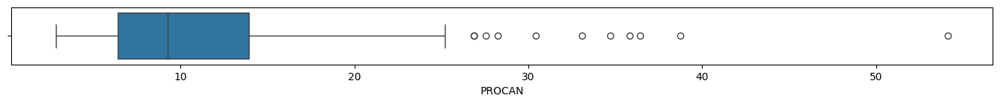

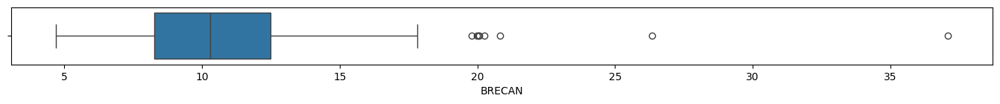

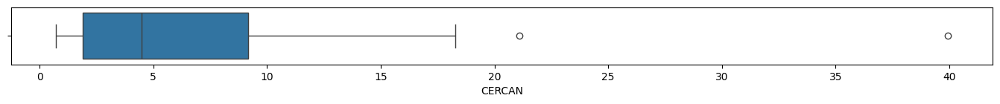

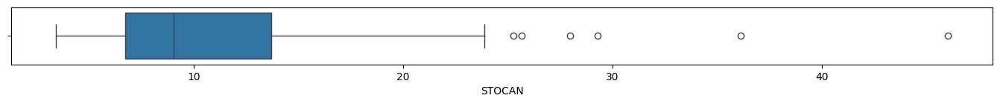

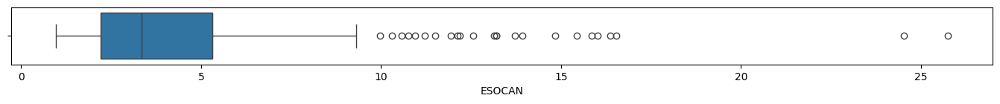

...

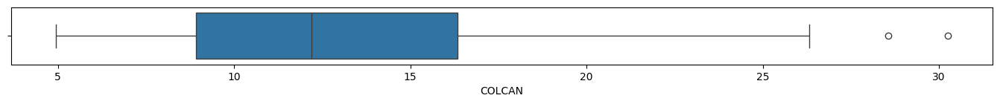

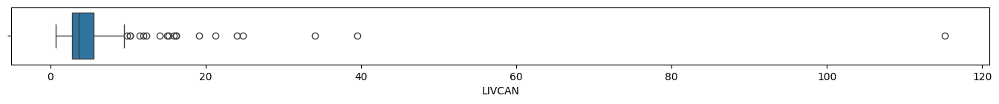

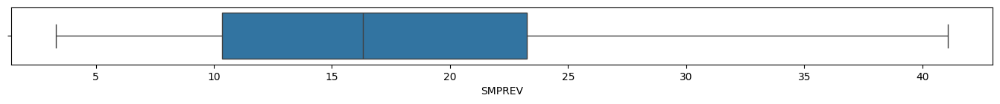

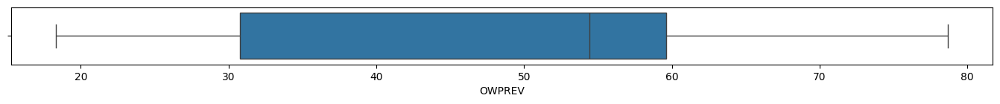

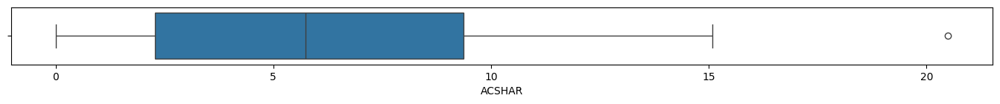

In [95]:
##################################
# Formulating the individual boxplots
# for all numeric columns
##################################
for column in cancer_death_rate_cleaned_numeric:
        plt.figure(figsize=(17,1))
        sns.boxplot(data=cancer_death_rate_cleaned_numeric, x=column)

#### 1.3.3.3 Collinearity <a class="anchor" id="1.3.3.3"></a>

1. Majority of the numeric variables reported moderate to high correlation which were statistically significant.
2. Among pairwise combinations of numeric variables on cancer death rates, high Pearson.Correlation.Coefficient values were noted for:
    * <span style="color: #FF0000">PANCAN</span> and <span style="color: #FF0000">COLCAN</span>: Pearson.Correlation.Coefficient = +0.754
    * <span style="color: #FF0000">LUNCAN</span> and <span style="color: #FF0000">COLCAN</span>: Pearson.Correlation.Coefficient = +0.701
3. Among the numeric variables on cancer death rates, the highest Pearson.Correlation.Coefficient values against the <span style="color: #FF0000">SMPREV</span> variable were noted for:
    * <span style="color: #FF0000">SMPREV</span> and <span style="color: #FF0000">LUNCAN</span>: Pearson.Correlation.Coefficient = +0.642
    * <span style="color: #FF0000">SMPREV</span> and <span style="color: #FF0000">COLCAN</span>: Pearson.Correlation.Coefficient = +0.413
4. Among the numeric variables on cancer death rates, the highest Pearson.Correlation.Coefficient values against the <span style="color: #FF0000">OWPREV</span> variable were noted for:
    * <span style="color: #FF0000">OWPREV</span> and <span style="color: #FF0000">PANCAN</span>: Pearson.Correlation.Coefficient = +0.521
    * <span style="color: #FF0000">OWPREV</span> and <span style="color: #FF0000">COLCAN</span>: Pearson.Correlation.Coefficient = +0.410
5. Among the numeric variables on cancer death rates, the highest Pearson.Correlation.Coefficient values against the <span style="color: #FF0000">ACSHAR</span> variable were noted for:
    * <span style="color: #FF0000">ACSHAR</span> and <span style="color: #FF0000">COLCAN</span>: Pearson.Correlation.Coefficient = +0.582
    * <span style="color: #FF0000">ACSHAR</span> and <span style="color: #FF0000">PANCAN</span>: Pearson.Correlation.Coefficient = +0.575
6. No any variable was removed due to extreme multicollinearity. 


In [96]:
##################################
# Formulating a function 
# to plot the correlation matrix
# for all pairwise combinations
# of numeric columns
##################################
def plot_correlation_matrix(corr, mask=None):
    f, ax = plt.subplots(figsize=(11, 9))
    sns.heatmap(corr, 
                ax=ax,
                mask=mask,
                annot=True, 
                vmin=-1, 
                vmax=1, 
                center=0,
                cmap='coolwarm', 
                linewidths=1, 
                linecolor='gray', 
                cbar_kws={'orientation': 'horizontal'})  

In [97]:
##################################
# Computing the correlation coefficients
# and correlation p-values
# among pairs of numeric columns
##################################
cancer_death_rate_cleaned_numeric_correlation_pairs = {}
cancer_death_rate_cleaned_numeric_columns = cancer_death_rate_cleaned_numeric.columns.tolist()
for numeric_column_a, numeric_column_b in itertools.combinations(cancer_death_rate_cleaned_numeric_columns, 2):
    cancer_death_rate_cleaned_numeric_correlation_pairs[numeric_column_a + '_' + numeric_column_b] = stats.pearsonr(
        cancer_death_rate_cleaned_numeric.loc[:, numeric_column_a], 
        cancer_death_rate_cleaned_numeric.loc[:, numeric_column_b])

In [98]:
##################################
# Formulating the pairwise correlation summary
# for all numeric columns
##################################
cancer_death_rate_cleaned_numeric_summary = cancer_death_rate_cleaned_numeric.from_dict(cancer_death_rate_cleaned_numeric_correlation_pairs, orient='index')
cancer_death_rate_cleaned_numeric_summary.columns = ['Pearson.Correlation.Coefficient', 'Correlation.PValue']
display(cancer_death_rate_cleaned_numeric_summary.sort_values(by=['Pearson.Correlation.Coefficient'], ascending=False).head(20))

,Pearson.Correlation.Coefficient,Correlation.PValue
PANCAN_COLCAN,0.7537,0.0000
LUNCAN_COLCAN,0.7010,0.0000
LUNCAN_SMPREV,0.6415,0.0000
PANCAN_LUNCAN,0.6367,0.0000
COLCAN_ACSHAR,0.5819,0.0000
PANCAN_ACSHAR,0.5750,0.0000
PANCAN_OWPREV,0.5212,0.0000
CERCAN_ESOCAN,0.4803,0.0000
LUNCAN_ACSHAR,0.4330,0.0000
STOCAN_LIVCAN,0.4291,0.0000


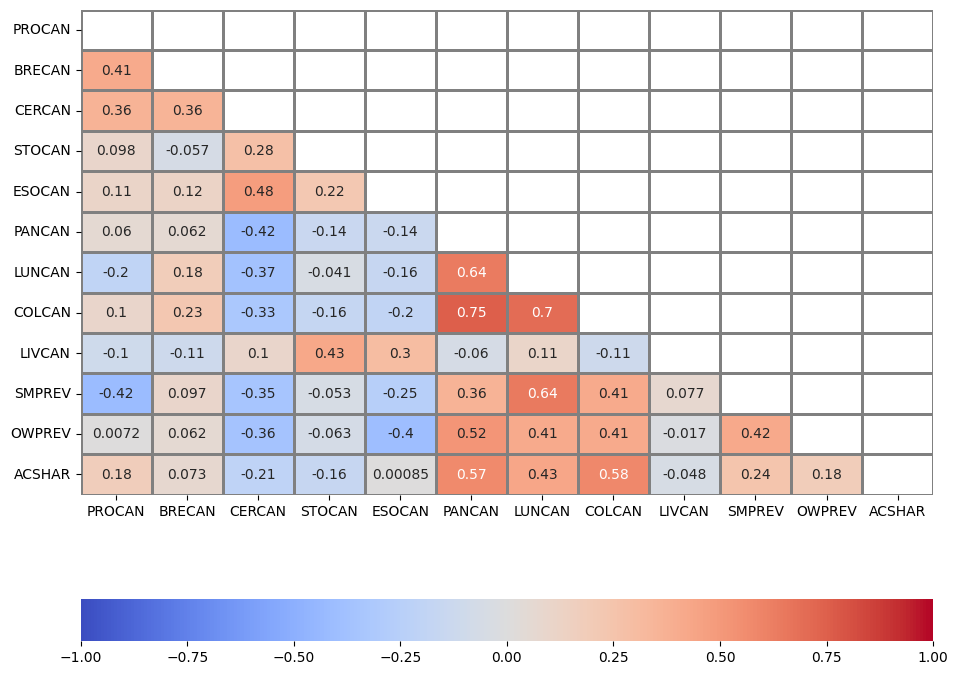

In [99]:
##################################
# Plotting the correlation matrix
# for all pairwise combinations
# of numeric columns
##################################
cancer_death_rate_cleaned_numeric_correlation = cancer_death_rate_cleaned_numeric.corr()
mask = np.triu(cancer_death_rate_cleaned_numeric_correlation)
plot_correlation_matrix(cancer_death_rate_cleaned_numeric_correlation,mask)
plt.show()

In [100]:
##################################
# Formulating a function 
# to plot the correlation matrix
# for all pairwise combinations
# of numeric columns
# with significant p-values only
##################################
def correlation_significance(df=None):
    p_matrix = np.zeros(shape=(df.shape[1],df.shape[1]))
    for col in df.columns:
        for col2 in df.drop(col,axis=1).columns:
            _ , p = stats.pearsonr(df[col],df[col2])
            p_matrix[df.columns.to_list().index(col),df.columns.to_list().index(col2)] = p
    return p_matrix

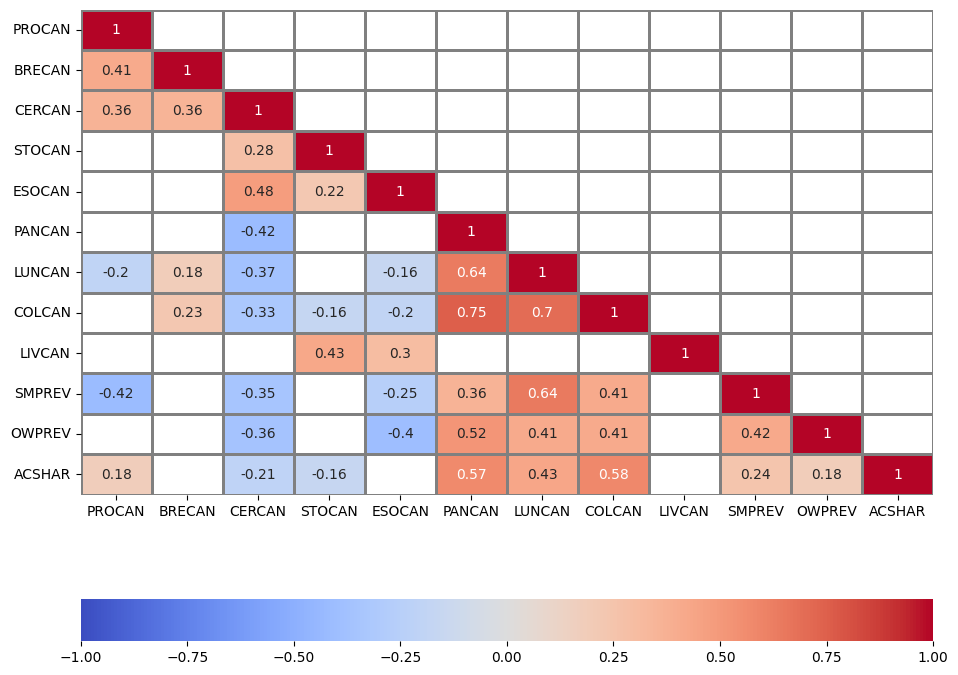

In [101]:
##################################
# Plotting the correlation matrix
# for all pairwise combinations
# of numeric columns
# with significant p-values only
##################################
cancer_death_rate_cleaned_numeric_correlation_p_values = correlation_significance(cancer_death_rate_cleaned_numeric)                     
mask = np.invert(np.tril(cancer_death_rate_cleaned_numeric_correlation_p_values<0.05)) 
plot_correlation_matrix(cancer_death_rate_cleaned_numeric_correlation,mask)  

In [102]:
##################################
# Performing a general exploration of the filtered dataset
##################################
print('Dataset Dimensions: ')
display(cancer_death_rate_cleaned_numeric.shape)

Dataset Dimensions: 


(183, 12)

#### 1.3.3.4 Shape Transformation <a class="anchor" id="1.3.3.4"></a>

1. A Yeo-Johnson transformation was applied to all numeric variables to improve distributional shape.
2. All variables achieved symmetrical distributions with minimal outliers after transformation.


In [103]:
##################################
# Conducting a Yeo-Johnson Transformation
# to address the distributional
# shape of the variables
##################################
yeo_johnson_transformer = PowerTransformer(method='yeo-johnson',
                                          standardize=False)
cancer_death_rate_cleaned_numeric_array = yeo_johnson_transformer.fit_transform(cancer_death_rate_cleaned_numeric)

In [104]:
##################################
# Formulating a new dataset object
# for the transformed data
##################################
cancer_death_rate_transformed_numeric = pd.DataFrame(cancer_death_rate_cleaned_numeric_array,
                                               columns=cancer_death_rate_cleaned_numeric.columns)

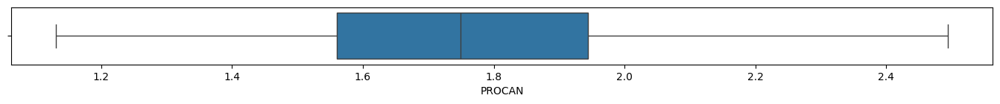

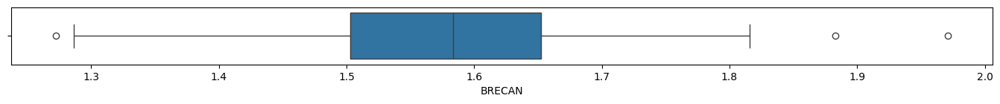

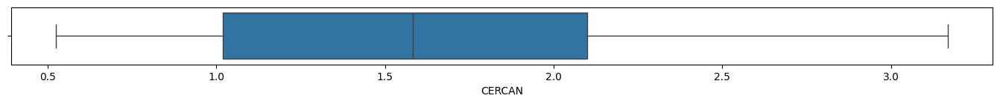

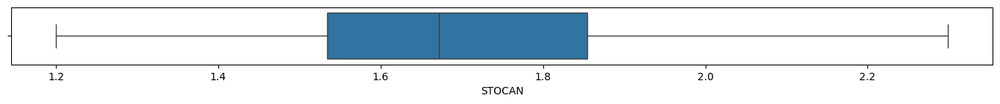

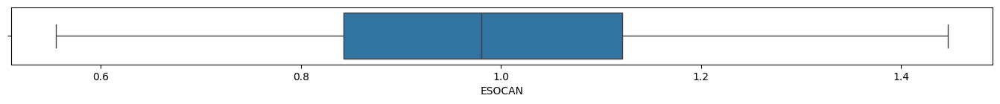

...

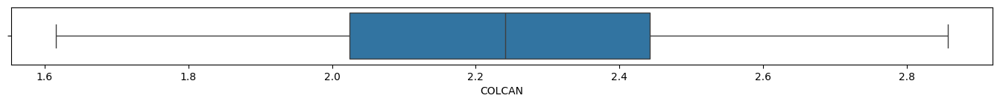

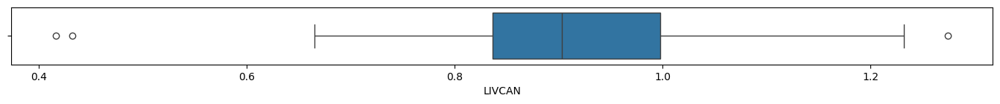

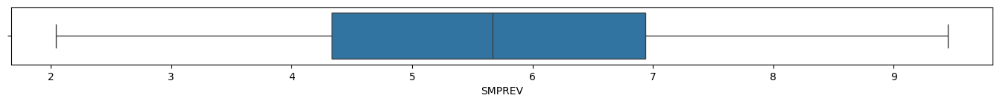

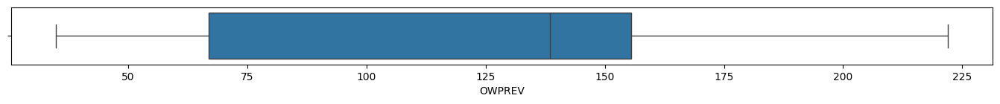

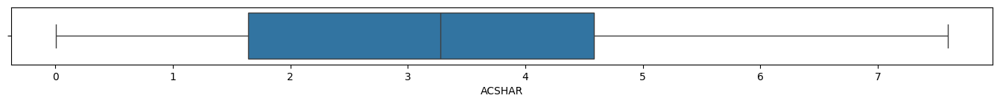

In [105]:
##################################
# Formulating the individual boxplots
# for all transformed numeric columns
##################################
for column in cancer_death_rate_transformed_numeric:
        plt.figure(figsize=(17,1))
        sns.boxplot(data=cancer_death_rate_transformed_numeric, x=column)

In [106]:
##################################
# Performing a general exploration of the filtered dataset
##################################
print('Dataset Dimensions: ')
display(cancer_death_rate_transformed_numeric.shape)

Dataset Dimensions: 


(183, 12)

In [107]:
cancer_death_rate_transformed_numeric

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,SMPREV,OWPREV,ACSHAR
0,1.5595,1.5203,1.4836,2.1487,1.1939,1.5456,2.4417,1.9846,1.1035,4.7108,46.3969,0.2004
1,1.7272,1.4076,0.9307,1.7470,0.6928,2.6330,3.0570,2.0417,1.0378,6.4628,149.2448,3.8224
2,1.4670,1.4686,1.1002,1.4007,0.6154,2.0444,2.2954,1.9526,0.7708,4.5421,163.6112,0.7992
3,1.7704,1.5352,1.0595,1.6330,1.0009,3.2883,3.2603,2.6740,1.0911,7.4729,169.3720,5.1050
4,1.9120,1.6229,2.2285,1.6682,1.2514,1.7808,2.5816,2.0787,0.8161,3.8904,58.1402,3.7374
...,...,...,...,...,...,...,...,...,...,...,...,...
178,1.9905,1.5533,1.9988,1.8183,0.8160,2.4509,2.8083,2.1890,0.7997,5.7294,168.3522,2.5885
179,1.2905,1.6500,1.6597,1.7169,0.9307,2.1167,3.0677,2.4898,0.8322,6.4983,34.8080,4.3473
180,1.5002,1.4362,1.0565,2.0113,1.0697,1.3550,2.3069,1.8210,0.8885,5.2531,120.5007,0.0504
181,1.9556,1.6259,2.3874,1.6536,1.3591,2.2641,2.3685,2.2649,0.8543,4.5909,58.9437,3.5868


#### 1.3.3.5 Centering and Scaling <a class="anchor" id="1.3.3.5"></a>

1. All numeric variables were transformed using the standardization method to achieve a comparable scale between values.


In [108]:
##################################
# Conducting standardization
# to transform the values of the 
# variables into comparable scale
##################################
standardization_scaler = StandardScaler()
cancer_death_rate_transformed_numeric_array = standardization_scaler.fit_transform(cancer_death_rate_transformed_numeric)

In [109]:
##################################
# Formulating a new dataset object
# for the scaled data
##################################
cancer_death_rate_scaled_numeric = pd.DataFrame(cancer_death_rate_transformed_numeric_array,
                                          columns=cancer_death_rate_transformed_numeric.columns)

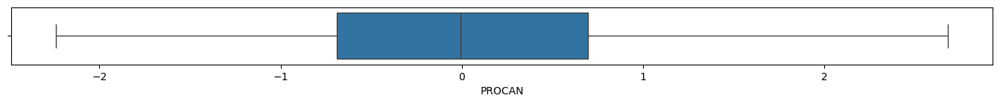

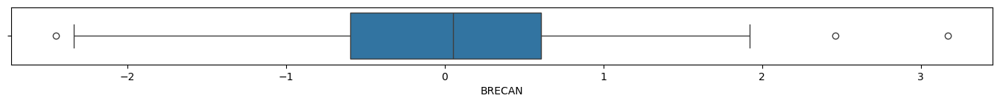

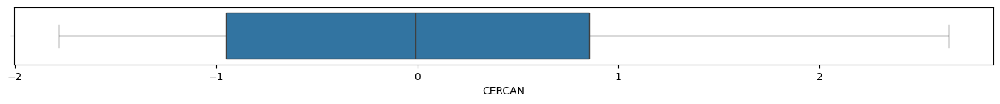

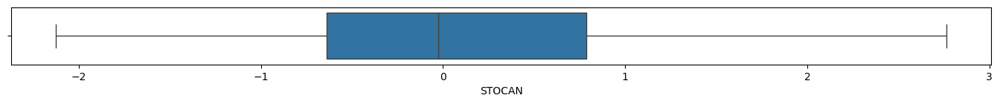

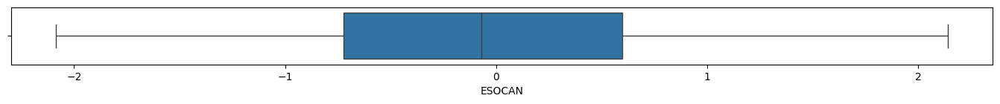

...

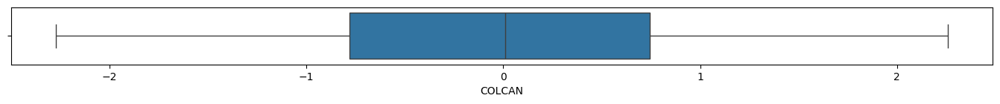

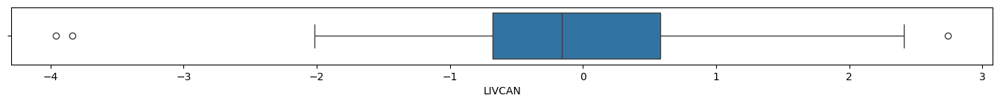

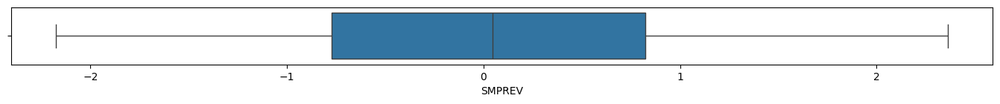

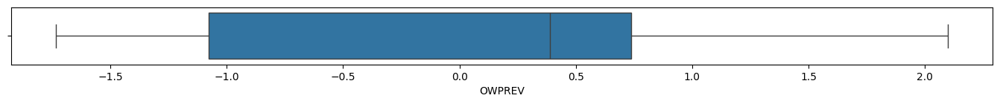

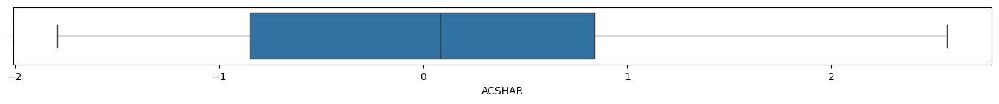

In [110]:
##################################
# Formulating the individual boxplots
# for all transformed numeric columns
##################################
for column in cancer_death_rate_scaled_numeric:
        plt.figure(figsize=(17,1))
        sns.boxplot(data=cancer_death_rate_scaled_numeric, x=column)

### 1.3.3.6 Preprocessed Data Description <a class="anchor" id="1.3.3.6"></a>

1. The preprocessed dataset is comprised of:
    * **183 rows** (observations)
    * **16 columns** (variables)
        * **1/16 metadata** (object)
            * <span style="color: #FF0000">COUNTRY</span>
            * <span style="color: #FF0000">CODE</span>
        * **2/16 metadata** (numeric)
            * <span style="color: #FF0000">GEOLAT</span>
            * <span style="color: #FF0000">GEOLON</span>
        * **9/16 clustering descriptors** (numeric)
             * <span style="color: #FF0000">PROCAN</span>
             * <span style="color: #FF0000">BRECAN</span>
             * <span style="color: #FF0000">CERCAN</span>
             * <span style="color: #FF0000">STOCAN</span>
             * <span style="color: #FF0000">ESOCAN</span>
             * <span style="color: #FF0000">PANCAN</span>
             * <span style="color: #FF0000">LUNCAN</span>
             * <span style="color: #FF0000">COLCAN</span>
             * <span style="color: #FF0000">LIVCAN</span>    
        * **3/16 target descriptors** (numeric)
             * <span style="color: #FF0000">SMPREV</span>
             * <span style="color: #FF0000">OWPREV</span>
             * <span style="color: #FF0000">ACSHAR</span>
             

In [111]:
##################################
# Consolidating both numeric columns
# and geolocation data
##################################
cancer_death_rate_preprocessed = pd.concat([cancer_death_rate_scaled_numeric,cancer_death_rate_cleaned_numeric_geolocation], axis=1, join='inner')  

In [112]:
##################################
# Performing a general exploration of the consolidated dataset
##################################
print('Dataset Dimensions: ')
display(cancer_death_rate_preprocessed.shape)

Dataset Dimensions: 


(183, 14)

### 1.3.4 Data Exploration <a class="anchor" id="1.3.4"></a>

#### 1.3.4.1 Exploratory Data Analysis <a class="anchor" id="1.3.4.1"></a>

1. Bivariate analysis identified individual descriptors with generally linear relationship to the target descriptor based on visual inspection.
2. Linear relationships for the following descriptors and <span style="color: #FF0000">SMPREV</span> variables were observed: 
    * <span style="color: #FF0000">LUNCAN</span>
    * <span style="color: #FF0000">COLCAN</span>    
3. Linear relationships for the following descriptors and <span style="color: #FF0000">OWPREV</span> variables were observed: 
    * <span style="color: #FF0000">PANCAN</span>
    * <span style="color: #FF0000">COLCAN</span>  
4. Linear relationships for the following descriptors and <span style="color: #FF0000">ACSHAR</span> variables were observed: 
    * <span style="color: #FF0000">COLCAN</span>
    * <span style="color: #FF0000">PANCAN</span>  
    

In [113]:
##################################
# Segregating the target
# and descriptor variable lists
##################################
cancer_death_rate_preprocessed_target_SMPREV = ['SMPREV']
cancer_death_rate_preprocessed_target_OWPREV = ['OWPREV']
cancer_death_rate_preprocessed_target_ACSHAR = ['ACSHAR']
cancer_death_rate_preprocessed_descriptors = cancer_death_rate_preprocessed.drop(['SMPREV','OWPREV','ACSHAR','GEOLAT','GEOLON'], axis=1).columns

In [114]:
##################################
# Segregating the target using SMPREV
# and descriptor variable names
##################################
y_variable = 'SMPREV'
x_variables = cancer_death_rate_preprocessed_descriptors

In [115]:
##################################
# Defining the number of 
# rows and columns for the subplots
##################################
num_rows = 3
num_cols = 3

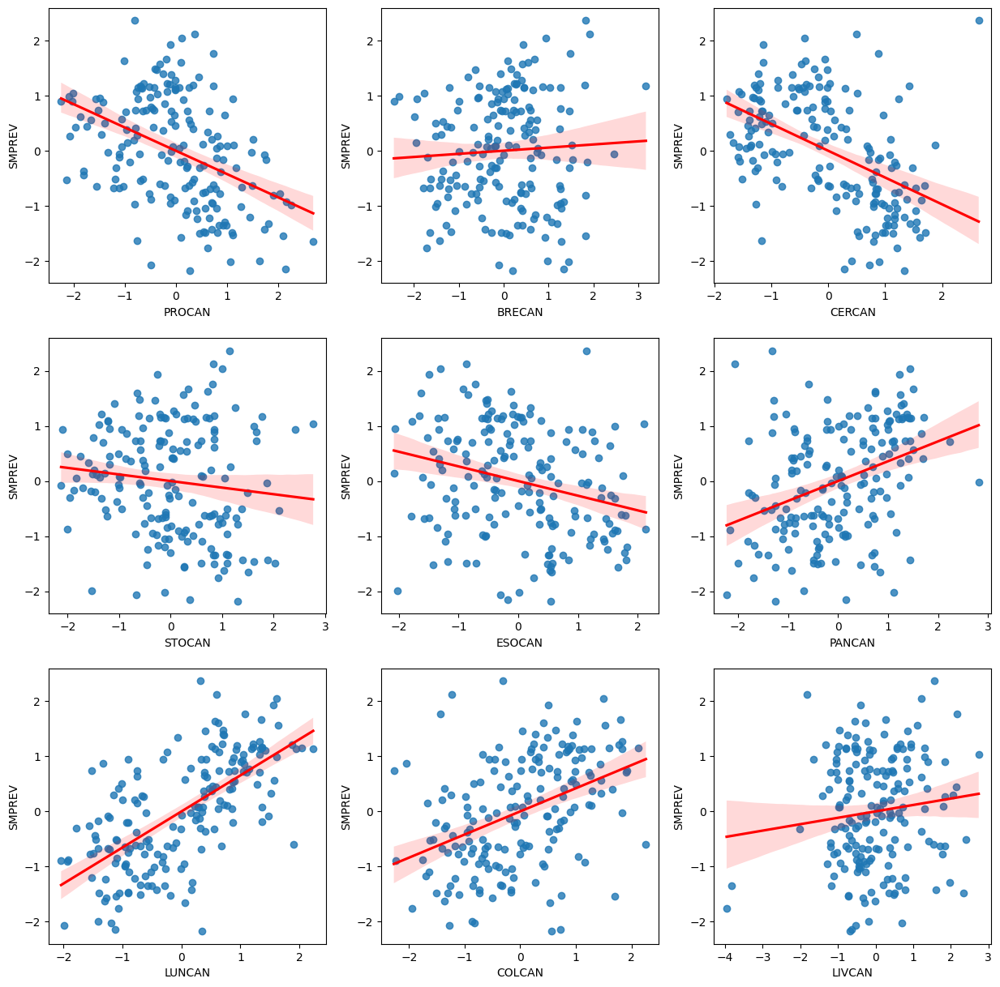

In [116]:
##################################
# Formulating the individual scatterplots
# for all scaled numeric columns
##################################
plt.figure(figsize=[15,15])
for i, x_variable in enumerate(x_variables):
    plt.subplot(num_rows,num_cols,i+1)
    sns.regplot(data=cancer_death_rate_preprocessed,x=x_variable,y=y_variable, line_kws={"color":'red'})    
plt.show()

In [117]:
##################################
# Segregating the target using OWPREV
# and descriptor variable names
##################################
y_variable = 'OWPREV'
x_variables = cancer_death_rate_preprocessed_descriptors

In [118]:
##################################
# Defining the number of 
# rows and columns for the subplots
##################################
num_rows = 3
num_cols = 3

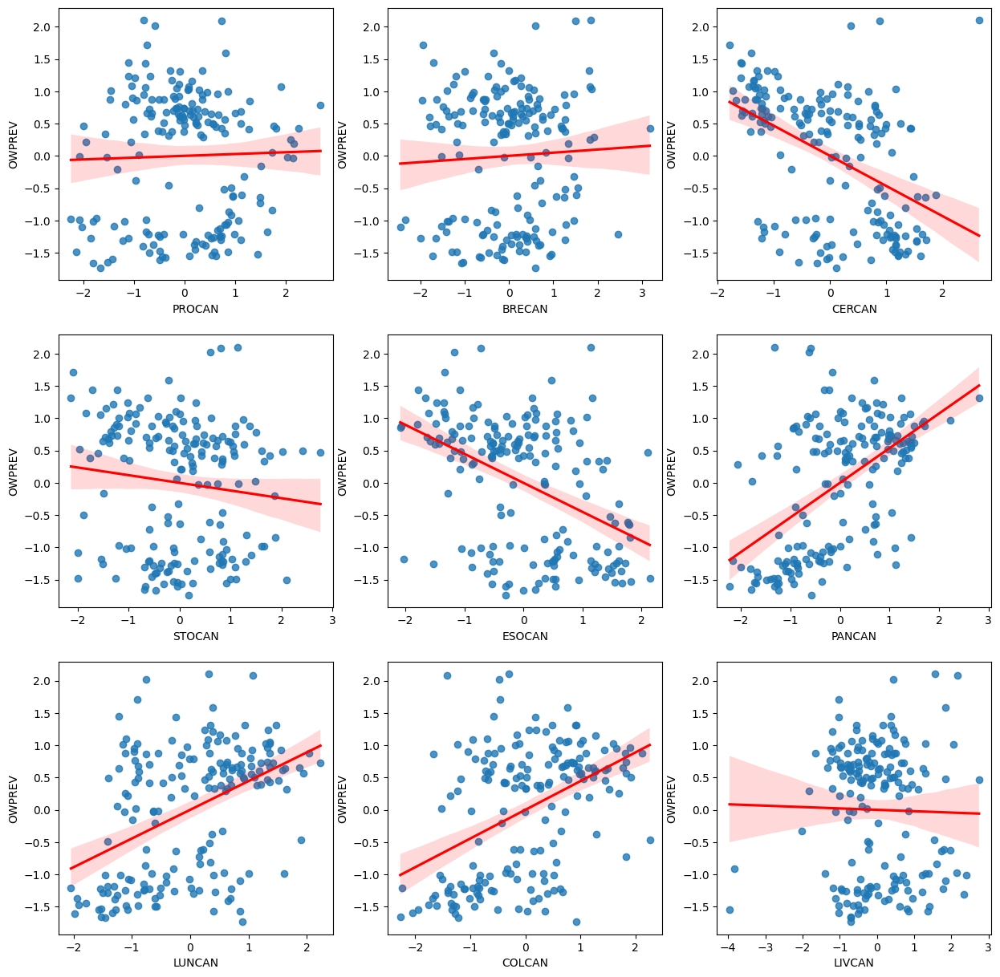

In [119]:
##################################
# Formulating the individual scatterplots
# for all scaled numeric columns
##################################
plt.figure(figsize=[15,15])
for i, x_variable in enumerate(x_variables):
    plt.subplot(num_rows,num_cols,i+1)
    sns.regplot(data=cancer_death_rate_preprocessed,x=x_variable,y=y_variable, line_kws={"color":'red'})    
plt.show()

In [120]:
##################################
# Segregating the target using ACSHAR
# and descriptor variable names
##################################
y_variable = 'ACSHAR'
x_variables = cancer_death_rate_preprocessed_descriptors

In [121]:
##################################
# Defining the number of 
# rows and columns for the subplots
##################################
num_rows = 3
num_cols = 3

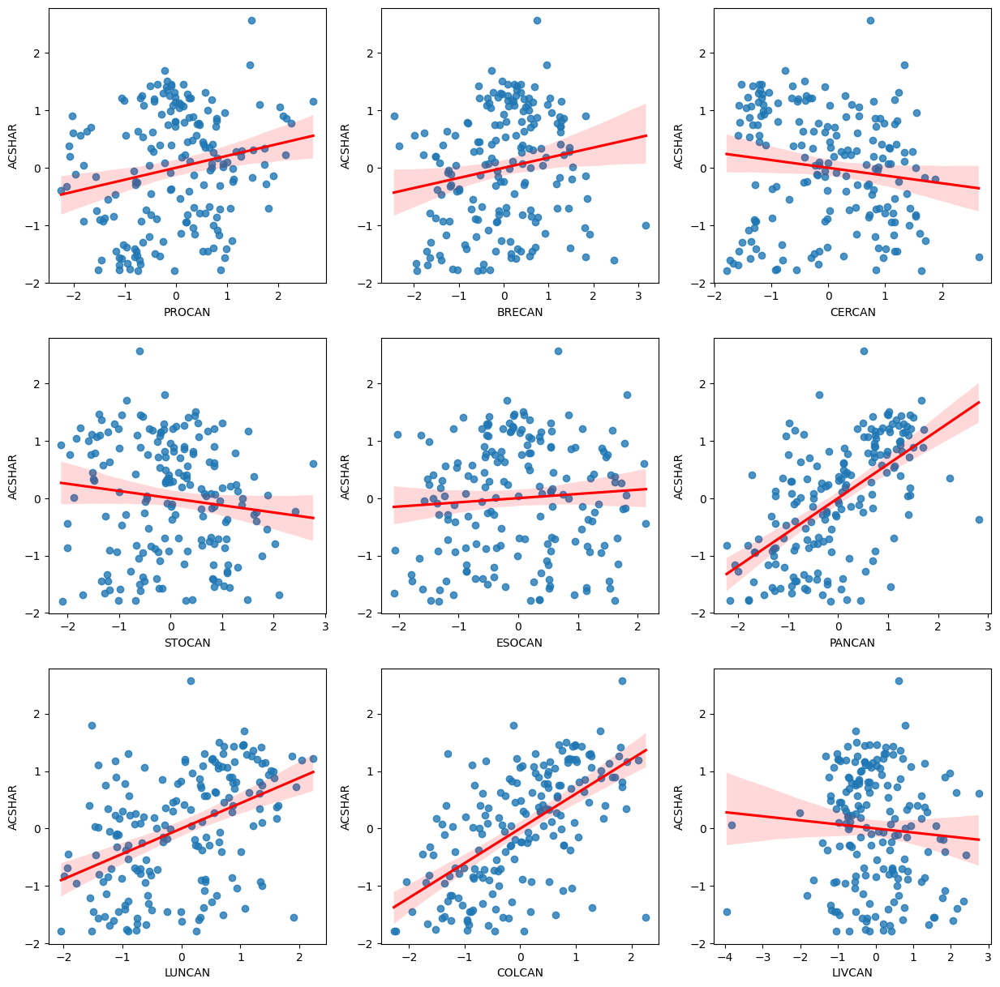

In [122]:
##################################
# Formulating the individual scatterplots
# for all scaled numeric columns
##################################
plt.figure(figsize=[15,15])
for i, x_variable in enumerate(x_variables):
    plt.subplot(num_rows,num_cols,i+1)
    sns.regplot(data=cancer_death_rate_preprocessed,x=x_variable,y=y_variable, line_kws={"color":'red'})    
plt.show()

#### 1.3.4.2 Hypothesis Testing <a class="anchor" id="1.3.4.2"></a>

1. The relationship between the numeric descriptors to the <span style="color: #FF0000">SMPREV</span>, <span style="color: #FF0000">OWPREV</span> and <span style="color: #FF0000">ACSHAR</span> target descriptors were statistically evaluated using the following hypotheses:
    * **Null**: Pearson correlation coefficient is equal to zero 
    * **Alternative**: Pearson correlation coefficient is not equal to zero    
2. There is sufficient evidence to conclude of a statistically significant linear relationship between the <span style="color: #FF0000">SMPREV</span> target descriptor and 6 of the 9 numeric descriptors given their high Pearson correlation coefficient values with reported low p-values less than the significance level of 0.05.
    * <span style="color: #FF0000">LUNCAN</span>: Pearson.Correlation.Coefficient=+0.684, Correlation.PValue=0.000
    * <span style="color: #FF0000">CERCAN</span>: Pearson.Correlation.Coefficient=-0.494, Correlation.PValue=0.000   
    * <span style="color: #FF0000">PROCAN</span>: Pearson.Correlation.Coefficient=-0.438, Correlation.PValue=0.000 
    * <span style="color: #FF0000">COLCAN</span>: Pearson.Correlation.Coefficient=+0.420, Correlation.PValue=0.000 
    * <span style="color: #FF0000">PANCAN</span>: Pearson.Correlation.Coefficient=+0.343, Correlation.PValue=0.000 
    * <span style="color: #FF0000">ESOCAN</span>: Pearson.Correlation.Coefficient=-0.262, Correlation.PValue=0.001 
3. There is sufficient evidence to conclude of a statistically significant linear relationship between the <span style="color: #FF0000">OWPREV</span> target descriptor and 5 of the 9 numeric descriptors given their high Pearson correlation coefficient values with reported low p-values less than the significance level of 0.05.
    * <span style="color: #FF0000">PANCAN</span>: Pearson.Correlation.Coefficient=+0.684, Correlation.PValue=0.000
    * <span style="color: #FF0000">CERCAN</span>: Pearson.Correlation.Coefficient=-0.494, Correlation.PValue=0.000   
    * <span style="color: #FF0000">LUNCAN</span>: Pearson.Correlation.Coefficient=+0.438, Correlation.PValue=0.000 
    * <span style="color: #FF0000">COLCAN</span>: Pearson.Correlation.Coefficient=+0.420, Correlation.PValue=0.000 
    * <span style="color: #FF0000">ESOCAN</span>: Pearson.Correlation.Coefficient=-0.343, Correlation.PValue=0.000 
4. There is sufficient evidence to conclude of a statistically significant linear relationship between the <span style="color: #FF0000">ACSHAR</span> target descriptor and 5 of the 9 numeric descriptors given their high Pearson correlation coefficient values with reported low p-values less than the significance level of 0.05.
    * <span style="color: #FF0000">PANCAN</span>: Pearson.Correlation.Coefficient=+0.567, Correlation.PValue=0.000
    * <span style="color: #FF0000">COLCAN</span>: Pearson.Correlation.Coefficient=+0.564, Correlation.PValue=0.000   
    * <span style="color: #FF0000">LUNCAN</span>: Pearson.Correlation.Coefficient=+0.399, Correlation.PValue=0.000 
    * <span style="color: #FF0000">PROCAN</span>: Pearson.Correlation.Coefficient=+0.201, Correlation.PValue=0.010 
    * <span style="color: #FF0000">BRECAN</span>: Pearson.Correlation.Coefficient=+0.174, Correlation.PValue=0.026


In [123]:
##################################
# Computing the correlation coefficients
# and correlation p-values
# between the target descriptor using SMPREV
# and numeric descriptor columns
##################################
cancer_death_rate_preprocessed_numeric_correlation_target = {}
cancer_death_rate_preprocessed_numeric = cancer_death_rate_preprocessed.drop(['OWPREV','ACSHAR','GEOLAT','GEOLON'], axis=1)
cancer_death_rate_preprocessed_numeric_columns = cancer_death_rate_preprocessed_numeric.columns.tolist()
for numeric_column in cancer_death_rate_preprocessed_numeric_columns:
    cancer_death_rate_preprocessed_numeric_correlation_target['SMPREV_' + numeric_column] = stats.pearsonr(
        cancer_death_rate_preprocessed_numeric.loc[:, 'SMPREV'], 
        cancer_death_rate_preprocessed_numeric.loc[:, numeric_column])

In [124]:
##################################
# Formulating the pairwise correlation summary
# between the target descriptor
# and numeric descriptor columns
##################################
cancer_death_rate_preprocessed_numeric_summary = cancer_death_rate_preprocessed_numeric.from_dict(cancer_death_rate_preprocessed_numeric_correlation_target, orient='index')
cancer_death_rate_preprocessed_numeric_summary.columns = ['Pearson.Correlation.Coefficient', 'Correlation.PValue']
display(cancer_death_rate_preprocessed_numeric_summary.sort_values(by=['Correlation.PValue'], ascending=True).head(10))

,Pearson.Correlation.Coefficient,Correlation.PValue
SMPREV_SMPREV,1.0000,0.0000
SMPREV_LUNCAN,0.6538,0.0000
SMPREV_CERCAN,-0.4866,0.0000
SMPREV_PROCAN,-0.4232,0.0000
SMPREV_COLCAN,0.4198,0.0000
SMPREV_PANCAN,0.3604,0.0000
SMPREV_ESOCAN,-0.2655,0.0003
SMPREV_STOCAN,-0.1196,0.1070
SMPREV_LIVCAN,0.1163,0.1171
SMPREV_BRECAN,0.0566,0.4465


In [125]:
##################################
# Computing the correlation coefficients
# and correlation p-values
# between the target descriptor using OWPREV
# and numeric descriptor columns
##################################
cancer_death_rate_preprocessed_numeric_correlation_target = {}
cancer_death_rate_preprocessed_numeric = cancer_death_rate_preprocessed.drop(['SMPREV','ACSHAR','GEOLAT','GEOLON'], axis=1)
cancer_death_rate_preprocessed_numeric_columns = cancer_death_rate_preprocessed_numeric.columns.tolist()
for numeric_column in cancer_death_rate_preprocessed_numeric_columns:
    cancer_death_rate_preprocessed_numeric_correlation_target['OWPREV_' + numeric_column] = stats.pearsonr(
        cancer_death_rate_preprocessed_numeric.loc[:, 'OWPREV'], 
        cancer_death_rate_preprocessed_numeric.loc[:, numeric_column])

In [126]:
##################################
# Formulating the pairwise correlation summary
# between the target descriptor
# and numeric descriptor columns
##################################
cancer_death_rate_preprocessed_numeric_summary = cancer_death_rate_preprocessed_numeric.from_dict(cancer_death_rate_preprocessed_numeric_correlation_target, orient='index')
cancer_death_rate_preprocessed_numeric_summary.columns = ['Pearson.Correlation.Coefficient', 'Correlation.PValue']
display(cancer_death_rate_preprocessed_numeric_summary.sort_values(by=['Correlation.PValue'], ascending=True).head(10))

,Pearson.Correlation.Coefficient,Correlation.PValue
OWPREV_OWPREV,1.0000,0.0000
OWPREV_PANCAN,0.5360,0.0000
OWPREV_CERCAN,-0.4677,0.0000
OWPREV_ESOCAN,-0.4489,0.0000
OWPREV_LUNCAN,0.4445,0.0000
OWPREV_COLCAN,0.4442,0.0000
OWPREV_STOCAN,-0.1189,0.1088
OWPREV_BRECAN,0.0490,0.5105
OWPREV_PROCAN,0.0280,0.7072
OWPREV_LIVCAN,-0.0214,0.7737


In [127]:
##################################
# Computing the correlation coefficients
# and correlation p-values
# between the target descriptor using ACSHAR
# and numeric descriptor columns
##################################
cancer_death_rate_preprocessed_numeric_correlation_target = {}
cancer_death_rate_preprocessed_numeric = cancer_death_rate_preprocessed.drop(['SMPREV','OWPREV','GEOLAT','GEOLON'], axis=1)
cancer_death_rate_preprocessed_numeric_columns = cancer_death_rate_preprocessed_numeric.columns.tolist()
for numeric_column in cancer_death_rate_preprocessed_numeric_columns:
    cancer_death_rate_preprocessed_numeric_correlation_target['ACSHAR_' + numeric_column] = stats.pearsonr(
        cancer_death_rate_preprocessed_numeric.loc[:, 'ACSHAR'], 
        cancer_death_rate_preprocessed_numeric.loc[:, numeric_column])

In [128]:
##################################
# Formulating the pairwise correlation summary
# between the target descriptor
# and numeric descriptor columns
##################################
cancer_death_rate_preprocessed_numeric_summary = cancer_death_rate_preprocessed_numeric.from_dict(cancer_death_rate_preprocessed_numeric_correlation_target, orient='index')
cancer_death_rate_preprocessed_numeric_summary.columns = ['Pearson.Correlation.Coefficient', 'Correlation.PValue']
display(cancer_death_rate_preprocessed_numeric_summary.sort_values(by=['Correlation.PValue'], ascending=True).head(10))

,Pearson.Correlation.Coefficient,Correlation.PValue
ACSHAR_ACSHAR,1.0000,0.0000
ACSHAR_COLCAN,0.6039,0.0000
ACSHAR_PANCAN,0.5929,0.0000
ACSHAR_LUNCAN,0.4403,0.0000
ACSHAR_PROCAN,0.2083,0.0047
ACSHAR_BRECAN,0.1759,0.0172
ACSHAR_CERCAN,-0.1347,0.0690
ACSHAR_STOCAN,-0.1249,0.0921
ACSHAR_ESOCAN,0.0732,0.3248
ACSHAR_LIVCAN,-0.0709,0.3401


## 1.3.5 Model Development <a class="anchor" id="1.3.5"></a>

### 1.3.5.1 Premodelling Data Description <a class="anchor" id="1.3.5.1"></a>

1. Among the 9 numeric descriptors, <span style="color: #FF0000">LIVCAN</span> and <span style="color: #FF0000">STOCAN</span> have not demonstrated a statistically significant linear relationship between the <span style="color: #FF0000">SMPREV</span>, <span style="color: #FF0000">OWPREV</span> nad , <span style="color: #FF0000">ACSHAR</span> target descriptors.
2. All 9 numeric descriptors were however retained for the clustering analysis.


In [129]:
##################################
# Consolidating relevant numeric columns
# after hypothesis testing
##################################
cancer_death_rate_premodelling = cancer_death_rate_preprocessed.drop(['GEOLAT','GEOLON'], axis=1)

In [130]:
##################################
# Performing a general exploration of the premodelling dataset
##################################
print('Dataset Dimensions: ')
display(cancer_death_rate_premodelling.shape)

Dataset Dimensions: 


(183, 12)

In [131]:
##################################
# Listing the column names and data types
##################################
print('Column Names and Data Types:')
display(cancer_death_rate_premodelling.dtypes)

Column Names and Data Types:


PROCAN    float64
BRECAN    float64
CERCAN    float64
STOCAN    float64
ESOCAN    float64
PANCAN    float64
LUNCAN    float64
COLCAN    float64
LIVCAN    float64
SMPREV    float64
OWPREV    float64
ACSHAR    float64
dtype: object

In [132]:
##################################
# Taking a snapshot of the dataset
##################################
cancer_death_rate_premodelling.head()

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,SMPREV,OWPREV,ACSHAR
0,-0.6922,-0.4550,-0.1771,2.0964,0.9425,-1.4794,-0.6095,-0.9258,1.4059,-0.5405,-1.4979,-1.6782
1,-0.0867,-1.3608,-1.1020,0.3084,-1.4329,0.2506,0.8754,-0.7177,0.8924,0.5329,0.6090,0.4008
2,-1.0261,-0.8704,-0.8184,-1.2331,-1.8001,-0.6858,-0.9625,-1.0428,-1.1914,-0.6438,0.9033,-1.3345
3,0.0691,-0.3352,-0.8866,-0.1990,0.0272,1.2933,1.3658,1.5903,1.3091,1.1517,1.0213,1.1371
4,0.5801,0.3703,1.0686,-0.0427,1.2150,-1.1052,-0.2718,-0.5826,-0.8379,-1.0431,-1.2574,0.3520


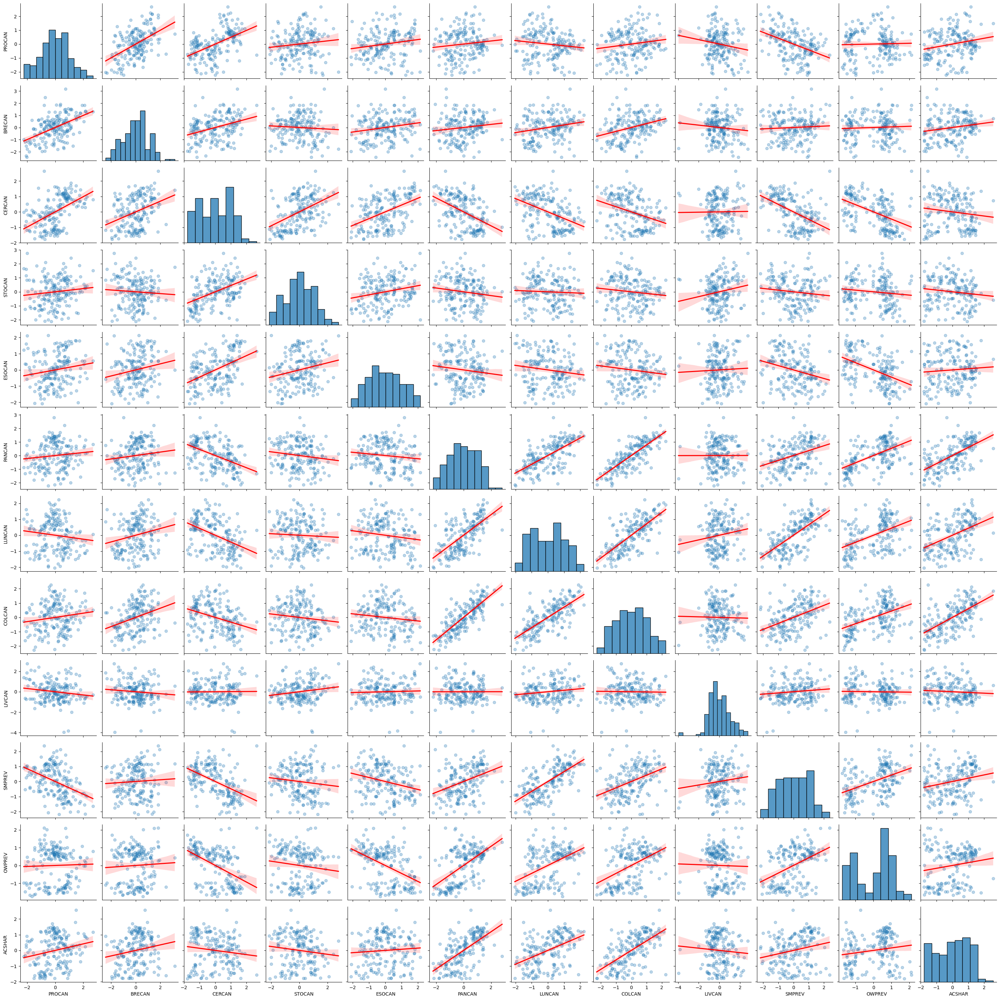

In [133]:
##################################
# Gathering the pairplot for all variables
##################################
sns.pairplot(cancer_death_rate_premodelling, 
             kind='reg',
             plot_kws={'scatter_kws': {'alpha': 0.3}, 
                       'line_kws':{'color':'red'}})
plt.show()

In [134]:
##################################
# Preparing the clustering dataset
##################################
cancer_death_rate_premodelling_clustering = cancer_death_rate_premodelling.drop(['SMPREV','OWPREV','ACSHAR'], axis=1)
cancer_death_rate_premodelling_clustering.head()

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN
0,-0.6922,-0.4550,-0.1771,2.0964,0.9425,-1.4794,-0.6095,-0.9258,1.4059
1,-0.0867,-1.3608,-1.1020,0.3084,-1.4329,0.2506,0.8754,-0.7177,0.8924
2,-1.0261,-0.8704,-0.8184,-1.2331,-1.8001,-0.6858,-0.9625,-1.0428,-1.1914
3,0.0691,-0.3352,-0.8866,-0.1990,0.0272,1.2933,1.3658,1.5903,1.3091
4,0.5801,0.3703,1.0686,-0.0427,1.2150,-1.1052,-0.2718,-0.5826,-0.8379


### 1.3.5.2 K-Means Clustering <a class="anchor" id="1.3.5.2"></a>

1. The [k-means clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans) from the <mark style="background-color: #CCECFF"><b>sklearn.cluster</b></mark> Python library API was implemented. 
2. The model contains 3 hyperparameters:
    * <span style="color: #FF0000">n_clusters</span> = number of clusters to form as well as the number of centroids to generate made to vary between 2 to 9
    * <span style="color: #FF0000">n_init</span> = number of times the k-means algorithm is run with different centroid seeds held constant at a value of auto
    * <span style="color: #FF0000">init</span> = method for initialization held constant at a value equal to k-means++
3. Hyperparameter tuning was conducted on the data with optimal model performance using the silhouette score determined for: 
    * <span style="color: #FF0000">n_clusters</span> = 2
    * <span style="color: #FF0000">n_init</span> = auto
    * <span style="color: #FF0000">init</span> = k-means++
4. The 5-fold cross-validated model performance of the optimal model is summarized as follows:
    * **Silhouette Score** = 0.2315
5. To increase coverage for improved interpretability, the apparent model performance of the optimal model with 2 clusters was obtained as follows:
    * **Silhouette Score** = 0.2355


In [135]:
##################################
# Preparing the cross-validation data
# and parameters to be evaluated
# for the K-Means Clustering algorithm
##################################
X = cancer_death_rate_premodelling_clustering.copy()
kmeans_kfold_cluster_list = range(2, 10)
kmeans_kfold_cluster_silhouette_score = []

In [136]:
##################################
# Conducting the 5-fold cross-validation
# using the defined parameters
# for the K-Means Clustering algorithm
# for each individual cluster count
##################################
for k in kmeans_kfold_cluster_list:
    ##################################
    # Defining the hyperparameters
    ##################################
    km = KMeans(n_clusters=k, 
                random_state=88888888, 
                n_init='auto', 
                init='k-means++')
    ##################################
    # Defining the 5-fold groups
    ##################################
    kfold = KFold(n_splits=5, 
                  shuffle=True, 
                  random_state=88888888)
    scores = []

    for train_index, test_index in kfold.split(X):
        ##################################
        # Formulating 5-fold groups
        ##################################
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        ##################################
        # Fitting the K-Means Clustering algorithm
        # on the train data
        ##################################
        km.fit(X_train)
        ##################################
        # Assigning clusters for the test data
        ##################################
        labels = km.predict(X_test)
        ##################################
        # Computing for the silhouette score
        # on the test data
        ##################################
        score = silhouette_score(X_test, labels)
        scores.append(score)

    ##################################
    # Calculating the average silhouette score
    # for the given cluster count
    ##################################
    average_score = np.mean(scores)
    kmeans_kfold_cluster_silhouette_score.append(average_score)

In [137]:
##################################
# Consolidating the model performance metrics
# for the K-Means Clustering algorithm
# using a range of K values
##################################
kmeans_clustering_kfold_summary = pd.DataFrame(zip(kmeans_kfold_cluster_list,
                                                   kmeans_kfold_cluster_silhouette_score),
                                               columns=['KMeans.KFold.Cluster.Count',
                                                        'KMeans.KFold.Cluster.Average.Silhouette.Score'])
kmeans_clustering_kfold_summary

,KMeans.KFold.Cluster.Count,KMeans.KFold.Cluster.Average.Silhouette.Score
0,2,0.2285
1,3,0.2181
2,4,0.1503
3,5,0.1445
4,6,0.1454
5,7,0.0993
6,8,0.1181
7,9,0.0887


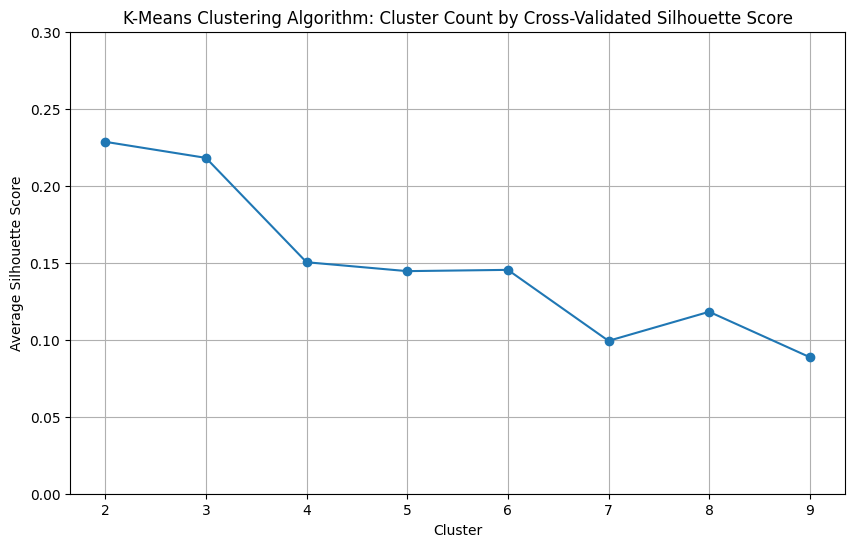

In [138]:
###################################
# Plotting the Average Silhouette Score performance
# by cluster count using the 5-fold results
# for the K-Means Clustering algorithm
##################################
kmeans_kfold_cluster_count_values = np.array(kmeans_clustering_kfold_summary['KMeans.KFold.Cluster.Count'].values)
kmeans_kfold_silhouette_score_values = np.array(kmeans_clustering_kfold_summary['KMeans.KFold.Cluster.Average.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(kmeans_kfold_cluster_count_values, kmeans_kfold_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("K-Means Clustering Algorithm: Cluster Count by Cross-Validated Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Average Silhouette Score")
plt.show()

In [139]:
##################################
# Fitting the K-Means Clustering algorithm
# using a range of K values
# for the complete dataset
##################################
kmeans_cluster_list = list()
kmeans_cluster_inertia = list()
kmeans_cluster_silhouette_score = list()
for cluster_count in range(2,10):
    km = KMeans(n_clusters=cluster_count, 
                random_state=88888888,
                n_init='auto',
                init='k-means++')
    km = km.fit(cancer_death_rate_premodelling_clustering)
    kmeans_cluster_list.append(cluster_count)
    kmeans_cluster_inertia.append(km.inertia_)
    kmeans_cluster_silhouette_score.append(silhouette_score(cancer_death_rate_premodelling_clustering, 
                                                            km.predict(cancer_death_rate_premodelling_clustering), 
                                                            metric='euclidean'))

In [140]:
##################################
# Consolidating the model performance metrics
# for the K-Means Clustering algorithm
# using a range of K values
# for the complete dataset
##################################
kmeans_clustering_evaluation_summary = pd.DataFrame(zip(kmeans_cluster_list,
                                                        kmeans_cluster_inertia,
                                                        kmeans_cluster_silhouette_score), 
                                                    columns=['KMeans.Cluster.Count',
                                                             'KMeans.Cluster.Inertia',
                                                             'KMeans.Cluster.Silhouette.Score'])
kmeans_clustering_evaluation_summary

,KMeans.Cluster.Count,KMeans.Cluster.Inertia,KMeans.Cluster.Silhouette.Score
0,2,1238.5327,0.2350
1,3,1027.1577,0.2364
2,4,1025.1634,0.1395
3,5,871.6545,0.2034
4,6,795.0377,0.2186
5,7,775.7324,0.1693
6,8,704.8949,0.1804
7,9,710.5409,0.1596


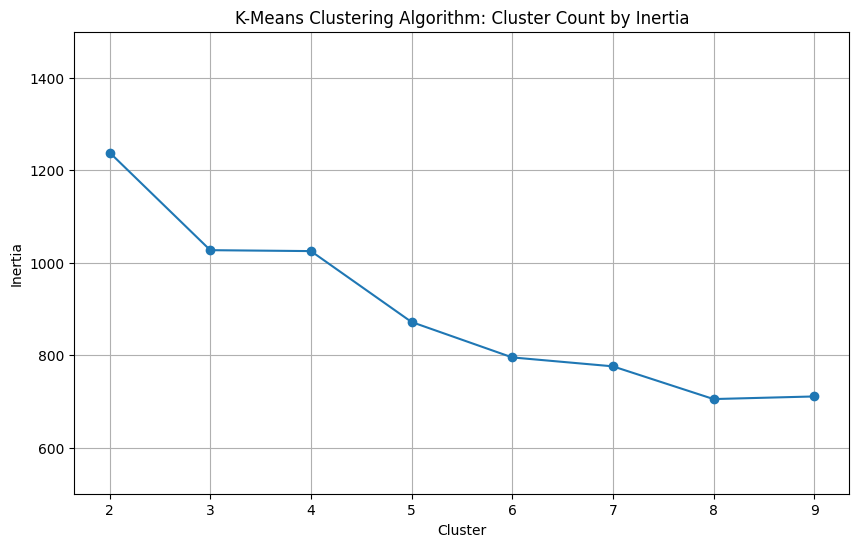

In [141]:
###################################
# Plotting the Inertia performance
# by cluster count using a range of K values
# for the K-Means Clustering algorithm
# for the complete dataset
##################################
kmeans_cluster_count_values = np.array(kmeans_clustering_evaluation_summary['KMeans.Cluster.Count'].values)
kmeans_inertia_values = np.array(kmeans_clustering_evaluation_summary['KMeans.Cluster.Inertia'].values)
plt.figure(figsize=(10, 6))
plt.plot(kmeans_cluster_count_values, kmeans_inertia_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(500,1500)
plt.title("K-Means Clustering Algorithm: Cluster Count by Inertia")
plt.xlabel("Cluster")
plt.ylabel("Inertia")
plt.show()

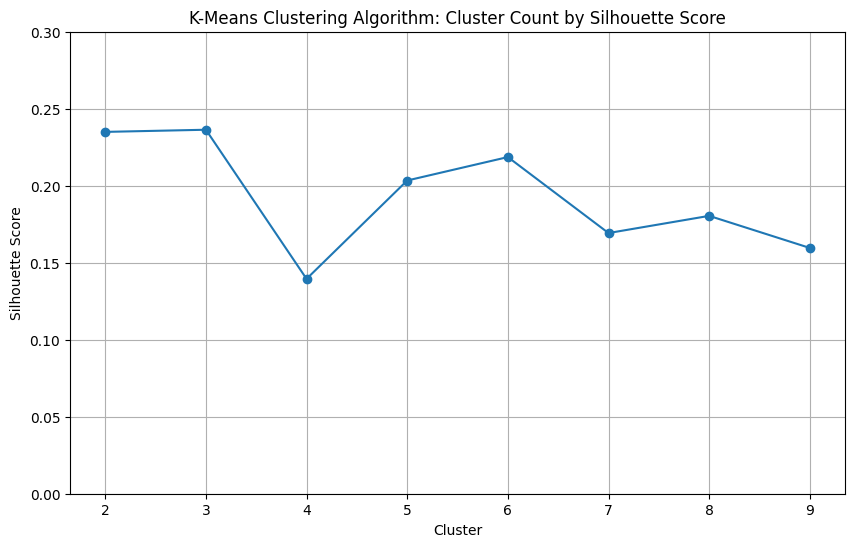

In [142]:
###################################
# Plotting the Silhouette Score performance
# by cluster count using a range of K values
# for the K-Means Clustering algorithm
# for the complete dataset
##################################
kmeans_cluster_count_values = np.array(kmeans_clustering_evaluation_summary['KMeans.Cluster.Count'].values)
kmeans_silhouette_score_values = np.array(kmeans_clustering_evaluation_summary['KMeans.Cluster.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(kmeans_cluster_count_values, kmeans_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("K-Means Clustering Algorithm: Cluster Count by Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Silhouette Score")
plt.show()

In [143]:
###################################
# Formulating the final K-Means Clustering model
# using the optimal cluster count
##################################
kmeans_clustering = KMeans(n_clusters=2, 
                           random_state=88888888,
                           n_init='auto',
                           init='k-means++')
kmeans_clustering = kmeans_clustering.fit(cancer_death_rate_premodelling_clustering)

###################################
# Gathering the Inertia and Silhouette Score
# for the final K-Means Clustering model
##################################
kmeans_clustering_inertia = kmeans_clustering.inertia_
kmeans_clustering_silhouette_score = silhouette_score(cancer_death_rate_premodelling_clustering, 
                                                      kmeans_clustering.predict(cancer_death_rate_premodelling_clustering), 
                                                      metric='euclidean')

In [144]:
##################################
# Plotting the cluster labels
# for the final K-Means Clustering model
##################################
cancer_death_rate_kmeans_clustering = cancer_death_rate_premodelling_clustering.copy()
cancer_death_rate_kmeans_clustering['KMEANS_CLUSTER'] = kmeans_clustering.predict(cancer_death_rate_kmeans_clustering)
cancer_death_rate_kmeans_clustering.head()

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,KMEANS_CLUSTER
0,-0.6922,-0.4550,-0.1771,2.0964,0.9425,-1.4794,-0.6095,-0.9258,1.4059,1
1,-0.0867,-1.3608,-1.1020,0.3084,-1.4329,0.2506,0.8754,-0.7177,0.8924,0
2,-1.0261,-0.8704,-0.8184,-1.2331,-1.8001,-0.6858,-0.9625,-1.0428,-1.1914,0
3,0.0691,-0.3352,-0.8866,-0.1990,0.0272,1.2933,1.3658,1.5903,1.3091,0
4,0.5801,0.3703,1.0686,-0.0427,1.2150,-1.1052,-0.2718,-0.5826,-0.8379,1


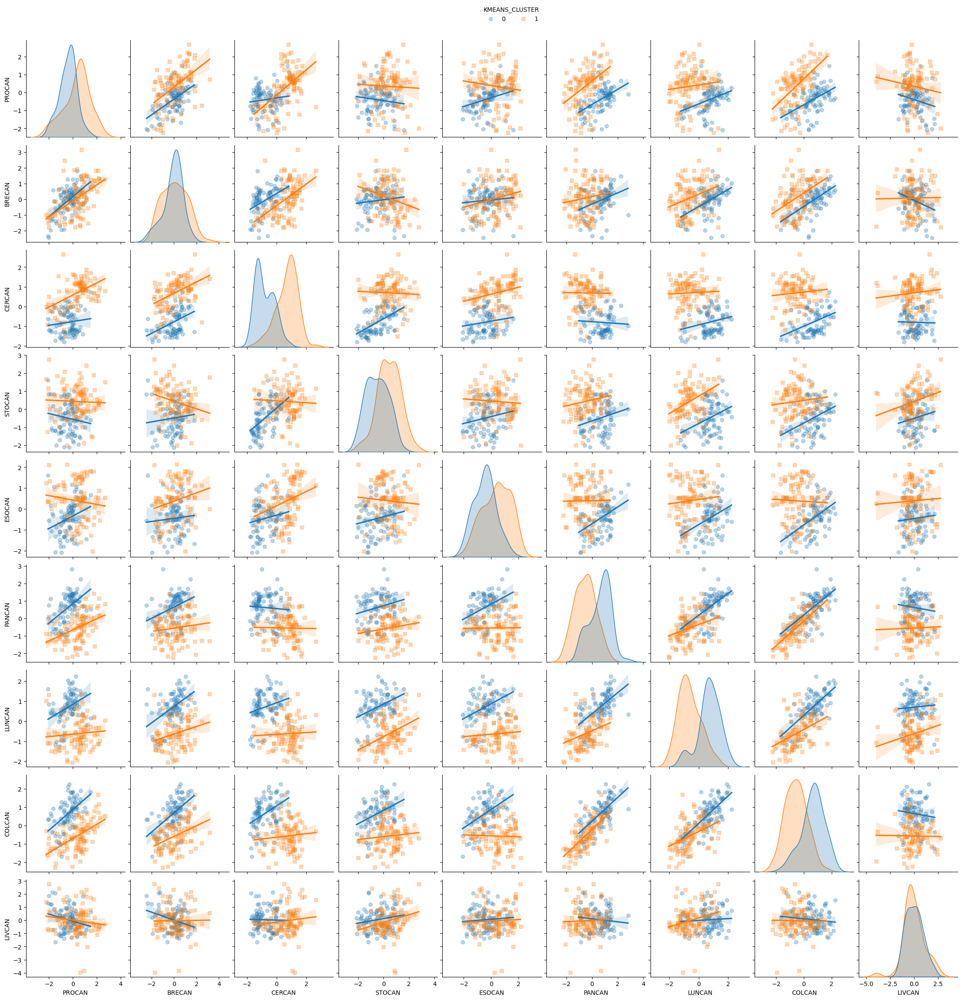

In [145]:
##################################
# Gathering the pairplot for all variables
# labelled using the final K-Means Clustering model
##################################
cancer_death_rate_kmeans_clustering_plot = sns.pairplot(cancer_death_rate_kmeans_clustering,
                                                        kind='reg',
                                                        markers=["o", "s"],
                                                        plot_kws={'scatter_kws': {'alpha': 0.3}},
                                                        hue='KMEANS_CLUSTER');
sns.move_legend(cancer_death_rate_kmeans_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=2, title='KMEANS_CLUSTER', frameon=False)
plt.show()

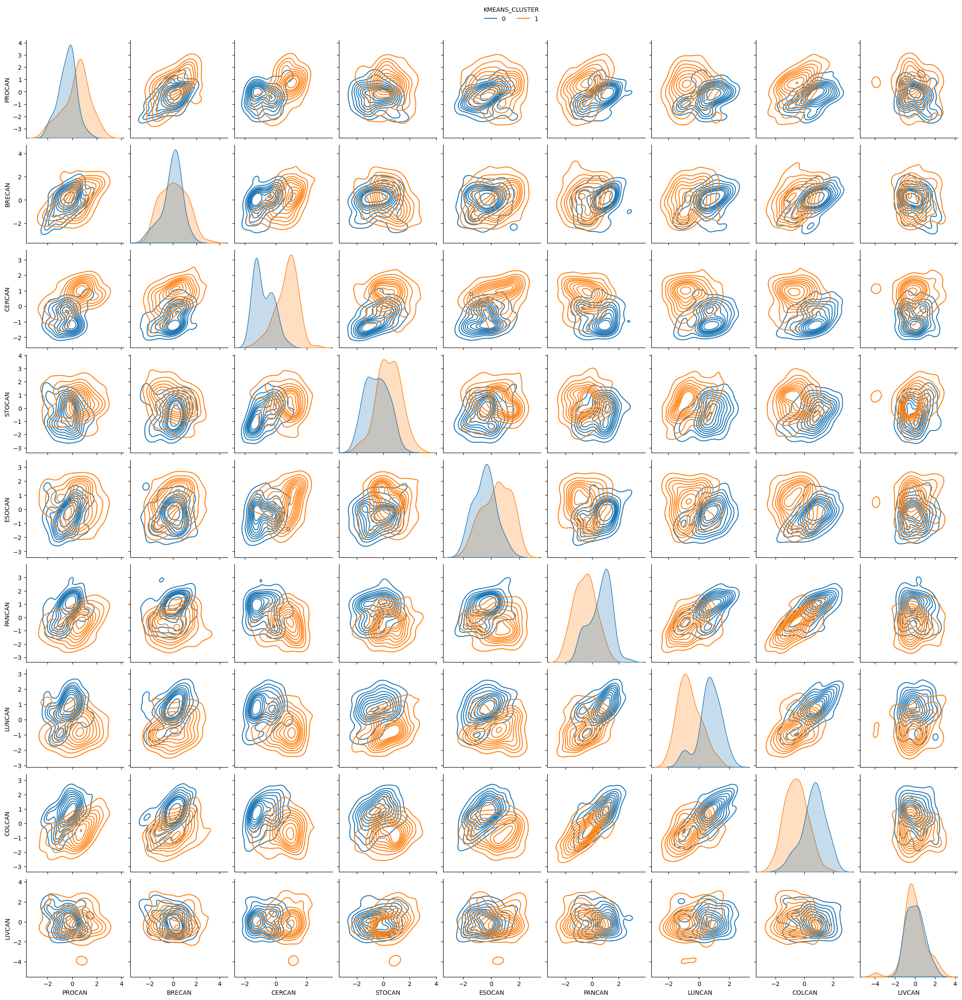

In [146]:
##################################
# Gathering the pairplot for all variables
# labelled using the final K-Means Clustering model
##################################
cancer_death_rate_kmeans_clustering_plot = sns.pairplot(cancer_death_rate_kmeans_clustering,
                                                        kind='kde',
                                                        hue='KMEANS_CLUSTER');
sns.move_legend(cancer_death_rate_kmeans_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=2, title='KMEANS_CLUSTER', frameon=False)
plt.show()

### 1.3.5.3 Bisecting K-Means Clustering <a class="anchor" id="1.3.5.3"></a>

1. The [bisecting k-means clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.BisectingKMeans.html#sklearn.cluster.BisectingKMeans) from the <mark style="background-color: #CCECFF"><b>sklearn.cluster</b></mark> Python library API was implemented. 
2. The model contains 3 hyperparameters:
    * <span style="color: #FF0000">n_clusters</span> = number of clusters to form as well as the number of centroids to generate made to vary between 2 to 9
    * <span style="color: #FF0000">n_init</span> = number of time the inner k-means algorithm will be run with different centroid seeds in each bisection held constant at a value of 1
    * <span style="color: #FF0000">init</span> = method for initialization held constant at a value equal to k-means++
3. Hyperparameter tuning was conducted on the data with optimal model performance using the silhouette score determined for: 
    * <span style="color: #FF0000">n_clusters</span> = 2
    * <span style="color: #FF0000">n_init</span> = 1
    * <span style="color: #FF0000">init</span> = k-means++
4. The 5-fold cross-validated model performance of the optimal model is summarized as follows:
    * **Silhouette Score** = 0.2315
5. To increase coverage for improved interpretability, the apparent model performance of the optimal model with 2 clusters was obtained as follows:
    * **Silhouette Score** = 0.2355
    

In [147]:
##################################
# Preparing the cross-validation data
# and parameters to be evaluated
# for the K-Means Clustering algorithm
##################################
X = cancer_death_rate_premodelling_clustering.copy()
bisecting_kmeans_kfold_cluster_list = range(2, 10)
bisecting_kmeans_kfold_cluster_silhouette_score = []

In [148]:
##################################
# Conducting the 5-fold cross-validation
# using the defined parameters
# for the Bisecting K-Means Clustering algorithm
# for each individual cluster count
##################################
for k in bisecting_kmeans_kfold_cluster_list:
    ##################################
    # Defining the hyperparameters
    ##################################
    bk = BisectingKMeans(n_clusters=k, 
                         random_state=88888888,
                         n_init=1,
                         init='k-means++')
    ##################################
    # Defining the 5-fold groups
    ##################################
    kfold = KFold(n_splits=5, 
                  shuffle=True, 
                  random_state=88888888)
    scores = []

    for train_index, test_index in kfold.split(X):
        ##################################
        # Formulating 5-fold groups
        ##################################
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        ##################################
        # Fitting the Bisecting K-Means Clustering algorithm
        # on the train data
        ##################################
        bk.fit(X_train)
        ##################################
        # Assigning clusters for the test data
        ##################################
        labels = bk.predict(X_test)
        ##################################
        # Computing for the silhouette score
        # on the test data
        ##################################
        score = silhouette_score(X_test, labels)
        scores.append(score)

    ##################################
    # Calculating the average silhouette score
    # for the given cluster count
    ##################################
    average_score = np.mean(scores)
    bisecting_kmeans_kfold_cluster_silhouette_score.append(average_score)

In [149]:
##################################
# Consolidating the model performance metrics
# for the Bisecting K-Means Clustering algorithm
# using a range of K values
##################################
bisecting_kmeans_clustering_kfold_summary = pd.DataFrame(zip(bisecting_kmeans_kfold_cluster_list,
                                                             bisecting_kmeans_kfold_cluster_silhouette_score),
                                               columns=['Bisecting.KMeans.KFold.Cluster.Count',
                                                        'Bisecting.KMeans.KFold.Cluster.Average.Silhouette.Score'])
bisecting_kmeans_clustering_kfold_summary

,Bisecting.KMeans.KFold.Cluster.Count,Bisecting.KMeans.KFold.Cluster.Average.Silhouette.Score
0,2,0.2285
1,3,0.1799
2,4,0.1756
3,5,0.1453
4,6,0.1495
5,7,0.1133
6,8,0.1052
7,9,0.0926


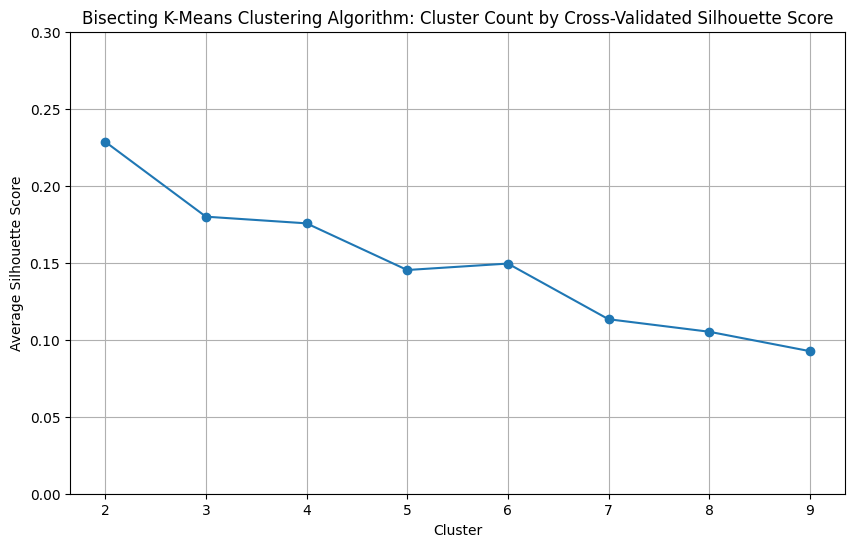

In [150]:
###################################
# Plotting the Average Silhouette Score performance
# by cluster count using the 5-fold results
# for the Bisecting K-Means Clustering algorithm
##################################
bisecting_kmeans_kfold_cluster_count_values = np.array(bisecting_kmeans_clustering_kfold_summary['Bisecting.KMeans.KFold.Cluster.Count'].values)
bisecting_kmeans_kfold_silhouette_score_values = np.array(bisecting_kmeans_clustering_kfold_summary['Bisecting.KMeans.KFold.Cluster.Average.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(bisecting_kmeans_kfold_cluster_count_values, bisecting_kmeans_kfold_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("Bisecting K-Means Clustering Algorithm: Cluster Count by Cross-Validated Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Average Silhouette Score")
plt.show()

In [151]:
##################################
# Fitting the Bisecting K-Means Clustering algorithm
# using a range of K values
# for the complete dataset
##################################
bisecting_kmeans_cluster_list = list()
bisecting_kmeans_cluster_inertia = list()
bisecting_kmeans_cluster_silhouette_score = list()
for cluster_count in range(2,10):
    bk = BisectingKMeans(n_clusters=cluster_count, 
                         random_state=88888888,
                         n_init=1,
                         init='k-means++')
    bk = bk.fit(cancer_death_rate_premodelling_clustering)
    bisecting_kmeans_cluster_list.append(cluster_count)
    bisecting_kmeans_cluster_inertia.append(bk.inertia_)
    bisecting_kmeans_cluster_silhouette_score.append(silhouette_score(cancer_death_rate_premodelling_clustering, 
                                                                      bk.predict(cancer_death_rate_premodelling_clustering), 
                                                                      metric='euclidean'))

In [152]:
##################################
# Consolidating the model performance metrics
# for the Bisecting K-Means Clustering algorithm
# using a range of K values
# for the complete dataset
##################################
bisecting_kmeans_clustering_evaluation_summary = pd.DataFrame(zip(bisecting_kmeans_cluster_list,
                                                                  bisecting_kmeans_cluster_inertia,
                                                                  bisecting_kmeans_cluster_silhouette_score),
                                                              columns=['Bisecting.KMeans.Cluster.Count',
                                                                       'Bisecting.KMeans.Cluster.Inertia',
                                                                       'Bisecting.KMeans.Cluster.Silhouette.Score'])
bisecting_kmeans_clustering_evaluation_summary

,Bisecting.KMeans.Cluster.Count,Bisecting.KMeans.Cluster.Inertia,Bisecting.KMeans.Cluster.Silhouette.Score
0,2,1238.5327,0.2350
1,3,1079.9345,0.2088
2,4,956.9095,0.1859
3,5,902.7490,0.1832
4,6,853.3242,0.1847
5,7,805.8361,0.1454
6,8,788.8381,0.1415
7,9,740.0624,0.1428


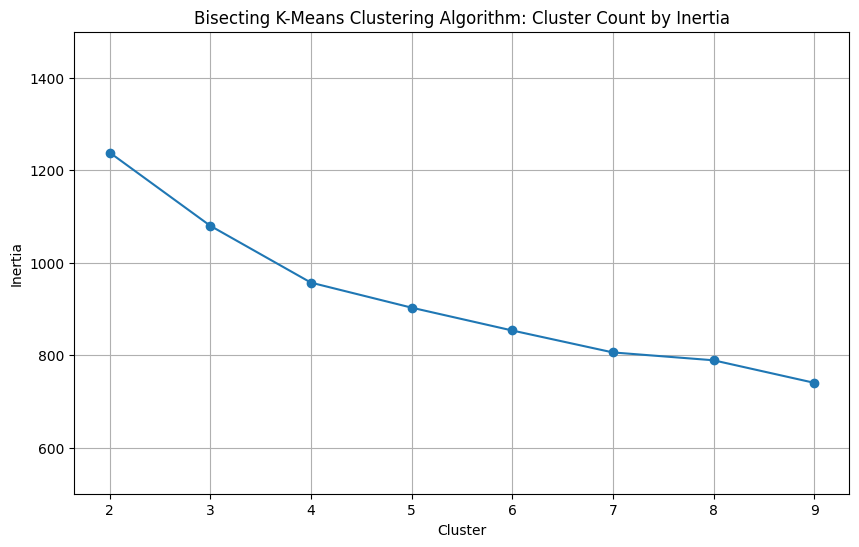

In [153]:
###################################
# Plotting the Inertia performance
# by cluster count using a range of K values
# for the Bisecting K-Means Clustering algorithm
# for the complete dataset
##################################
bisecting_kmeans_cluster_count_values = np.array(bisecting_kmeans_clustering_evaluation_summary['Bisecting.KMeans.Cluster.Count'].values)
bisecting_kmeans_inertia_values = np.array(bisecting_kmeans_clustering_evaluation_summary['Bisecting.KMeans.Cluster.Inertia'].values)
plt.figure(figsize=(10, 6))
plt.plot(bisecting_kmeans_cluster_count_values, bisecting_kmeans_inertia_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(500,1500)
plt.title("Bisecting K-Means Clustering Algorithm: Cluster Count by Inertia")
plt.xlabel("Cluster")
plt.ylabel("Inertia")
plt.show()

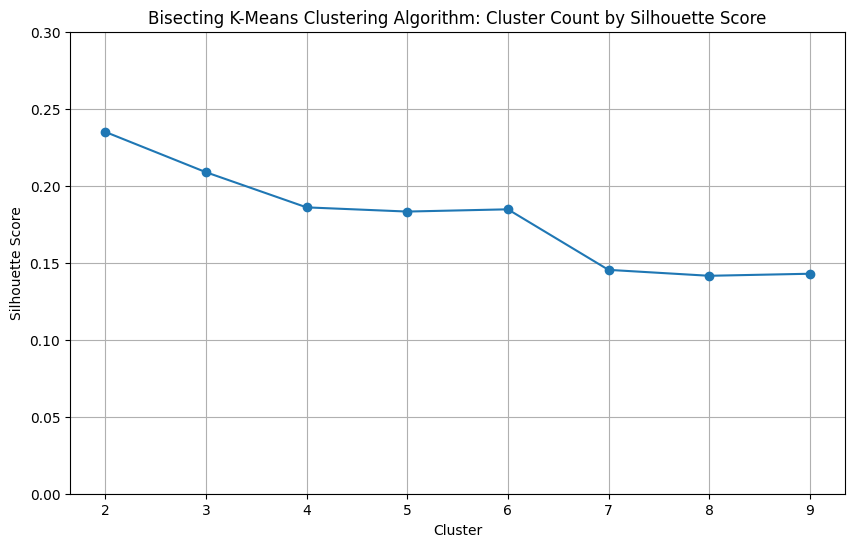

In [154]:
###################################
# Plotting the Silhouette Score performance
# by cluster count using a range of K values
# for the Bisecting K-Means Clustering algorithm
# for the complete dataset
##################################
bisecting_kmeans_cluster_count_values = np.array(bisecting_kmeans_clustering_evaluation_summary['Bisecting.KMeans.Cluster.Count'].values)
bisecting_kmeans_silhouette_score_values = np.array(bisecting_kmeans_clustering_evaluation_summary['Bisecting.KMeans.Cluster.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(bisecting_kmeans_cluster_count_values, bisecting_kmeans_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("Bisecting K-Means Clustering Algorithm: Cluster Count by Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Silhouette Score")
plt.show()

In [155]:
###################################
# Formulating the final Bisecting K-Means Clustering model
# using the optimal cluster count
##################################
bisecting_kmeans_clustering = BisectingKMeans(n_clusters=2, 
                                              random_state=88888888,
                                              n_init=1,
                                              init='k-means++')
bisecting_kmeans_clustering = bisecting_kmeans_clustering.fit(cancer_death_rate_premodelling_clustering)

###################################
# Gathering the Inertia and Silhouette Score
# for the final Bisecting K-Means Clustering model
##################################
bisecting_kmeans_clustering_inertia = bisecting_kmeans_clustering.inertia_
bisecting_kmeans_clustering_silhouette_score = silhouette_score(cancer_death_rate_premodelling_clustering, 
                                                                bisecting_kmeans_clustering.predict(cancer_death_rate_premodelling_clustering), 
                                                                metric='euclidean')

In [156]:
##################################
# Plotting the cluster labels
# for the final Bisecting K-Means Clustering model
##################################
cancer_death_rate_bisecting_kmeans_clustering = cancer_death_rate_premodelling_clustering.copy()
cancer_death_rate_bisecting_kmeans_clustering['BISECTING_KMEANS_CLUSTER'] = bisecting_kmeans_clustering.predict(cancer_death_rate_bisecting_kmeans_clustering)
cancer_death_rate_bisecting_kmeans_clustering.head()

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,BISECTING_KMEANS_CLUSTER
0,-0.6922,-0.4550,-0.1771,2.0964,0.9425,-1.4794,-0.6095,-0.9258,1.4059,1
1,-0.0867,-1.3608,-1.1020,0.3084,-1.4329,0.2506,0.8754,-0.7177,0.8924,0
2,-1.0261,-0.8704,-0.8184,-1.2331,-1.8001,-0.6858,-0.9625,-1.0428,-1.1914,0
3,0.0691,-0.3352,-0.8866,-0.1990,0.0272,1.2933,1.3658,1.5903,1.3091,0
4,0.5801,0.3703,1.0686,-0.0427,1.2150,-1.1052,-0.2718,-0.5826,-0.8379,1


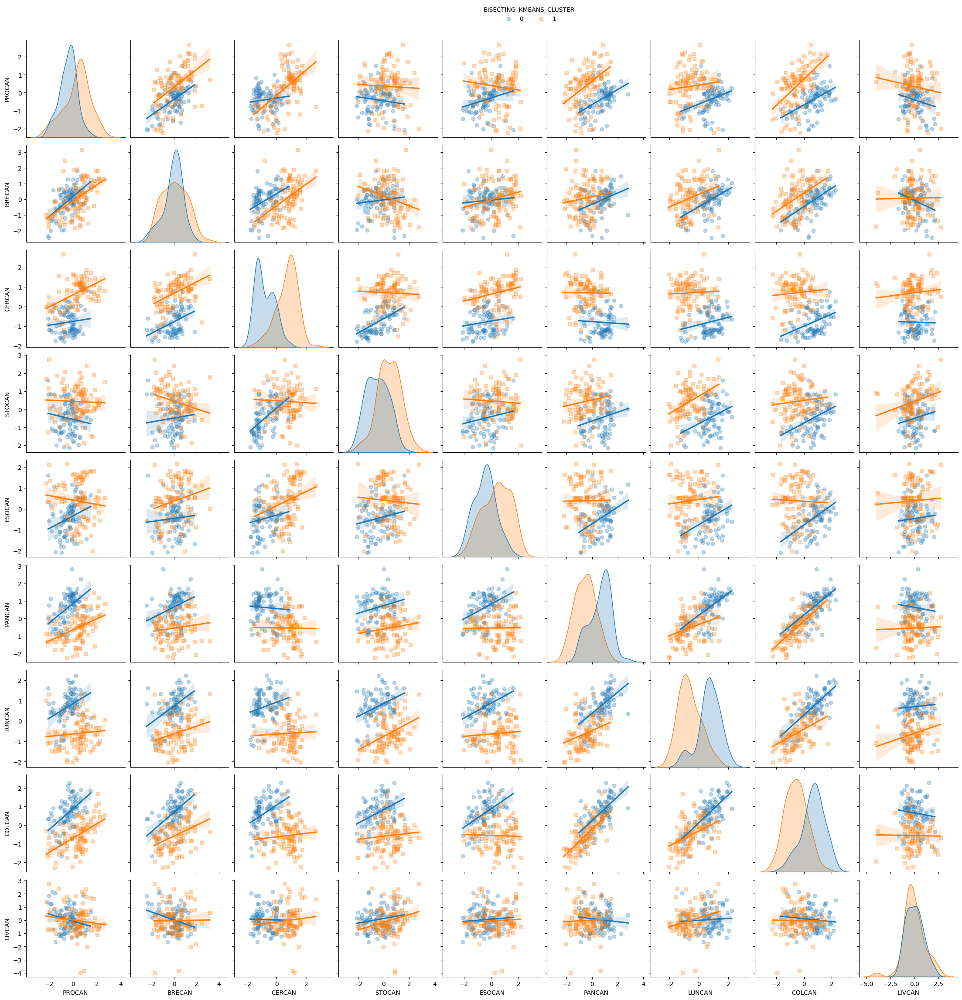

In [157]:
##################################
# Gathering the pairplot for all variables
# labelled using the final Bisecting K-Means Clustering model
##################################
cancer_death_rate_bisecting_kmeans_clustering_plot = sns.pairplot(cancer_death_rate_bisecting_kmeans_clustering,
                                                                  kind='reg',
                                                                  markers=["o", "s"],
                                                                  plot_kws={'scatter_kws': {'alpha': 0.3}},
                                                                  hue='BISECTING_KMEANS_CLUSTER');
sns.move_legend(cancer_death_rate_bisecting_kmeans_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=2, title='BISECTING_KMEANS_CLUSTER', frameon=False)
plt.show()

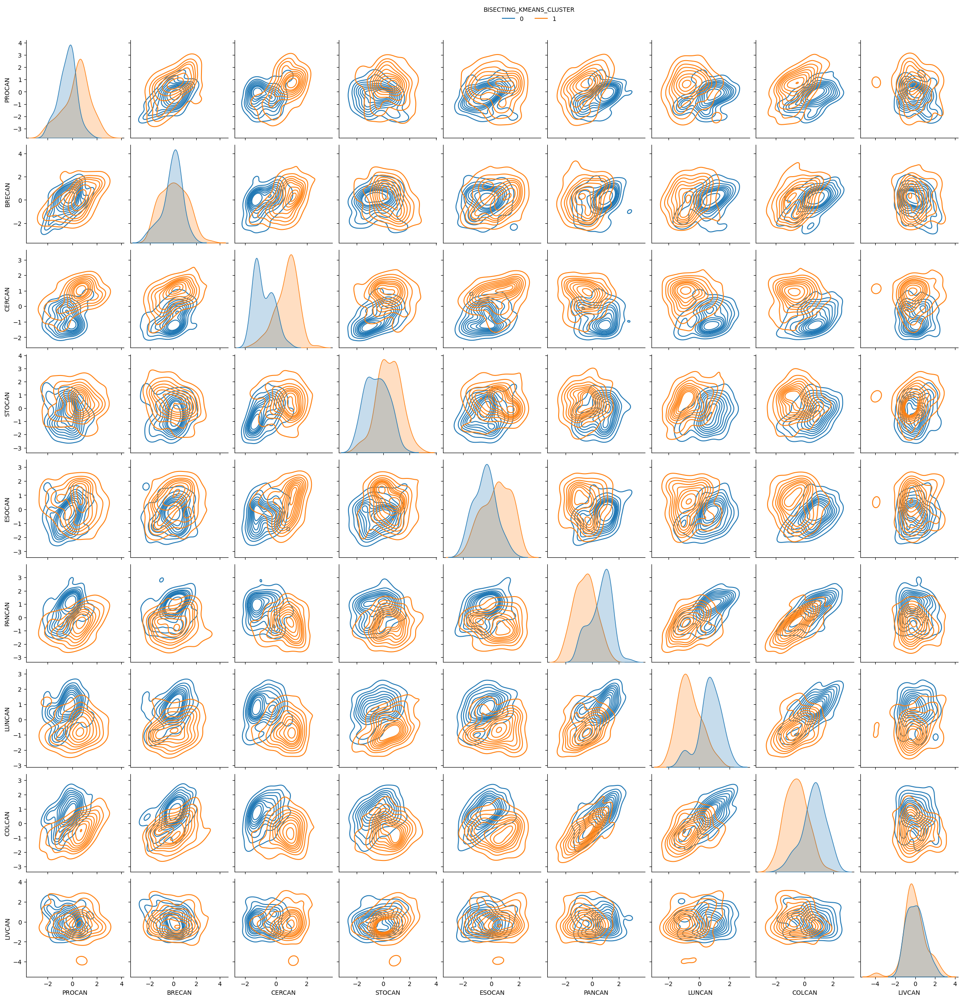

In [158]:
##################################
# Gathering the pairplot for all variables
# labelled using the final Bisecting K-Means Clustering model
##################################
cancer_death_rate_bisecting_kmeans_clustering_plot = sns.pairplot(cancer_death_rate_bisecting_kmeans_clustering,
                                                                  kind='kde',
                                                                  hue='BISECTING_KMEANS_CLUSTER');
sns.move_legend(cancer_death_rate_bisecting_kmeans_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=2, title='BISECTING_KMEANS_CLUSTER', frameon=False)
plt.show()

### 1.3.5.4 Gaussian Mixture Clustering <a class="anchor" id="1.3.5.4"></a>

1. The [gaussian mixture clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.mixture.GaussianMixture.html#sklearn.mixture.GaussianMixture) from the <mark style="background-color: #CCECFF"><b>sklearn.mixture</b></mark> Python library API was implemented. 
2. The model contains 4 hyperparameters:
    * <span style="color: #FF0000">n_components</span> = number of mixture components made to vary between 2 to 9
    * <span style="color: #FF0000">covariance_type</span> = type of covariance parameters to use held constant at a value equal to full (each component has its own general covariance matrix)
    * <span style="color: #FF0000">init_params</span> = method for initialization held constant at a value equal to k-means++
    * <span style="color: #FF0000">tol</span> = convergence threshold held constant at a value of 1e-3
3. Hyperparameter tuning was conducted on the data with optimal model performance using the silhouette score determined for: 
    * <span style="color: #FF0000">n_components</span> = 2
    * <span style="color: #FF0000">covariance_type</span> = full
    * <span style="color: #FF0000">init_params</span> = k-means++
    * <span style="color: #FF0000">tol</span> = 1e-3
4. The 5-fold cross-validated model performance of the optimal model is summarized as follows:
    * **Silhouette Score** = 0.1289
5. To increase coverage for improved interpretability, the apparent model performance of the optimal model with 2 clusters was obtained as follows:
    * **Silhouette Score** = 0.2239
    

In [159]:
##################################
# Preparing the cross-validation data
# and parameters to be evaluated
# for the GMM Clustering algorithm
##################################
X = cancer_death_rate_premodelling_clustering.copy()
gaussian_mixture_kfold_cluster_list = range(2, 10)
gaussian_mixture_kfold_cluster_silhouette_score = []

In [160]:
##################################
# Conducting the 5-fold cross-validation
# using the defined parameters
# for the GMM Clustering algorithm
# for each individual cluster count
##################################
for k in gaussian_mixture_kfold_cluster_list:
    ##################################
    # Defining the hyperparameters
    ##################################
    gm = GaussianMixture(n_components=k,
                         init_params='k-means++',
                         covariance_type='full',
                         tol = 1e-3,
                         random_state=88888888)
    ##################################
    # Defining the 5-fold groups
    ##################################
    kfold = KFold(n_splits=5, 
                  shuffle=True, 
                  random_state=88888888)
    scores = []

    for train_index, test_index in kfold.split(X):
        ##################################
        # Formulating 5-fold groups
        ##################################
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        ##################################
        # Fitting the GMM Clustering algorithm
        # on the train data
        ##################################
        gm.fit(X_train)
        ##################################
        # Assigning clusters for the test data
        ##################################
        labels = gm.predict(X_test)
        ##################################
        # Computing for the silhouette score
        # on the test data
        ##################################
        score = silhouette_score(X_test, labels)
        scores.append(score)

    ##################################
    # Calculating the average silhouette score
    # for the given cluster count
    ##################################
    average_score = np.mean(scores)
    gaussian_mixture_kfold_cluster_silhouette_score.append(average_score)

In [161]:
##################################
# Consolidating the model performance metrics
# for the GMM Clustering algorithm
# using a range of K values
##################################
gaussian_mixture_clustering_kfold_summary = pd.DataFrame(zip(gaussian_mixture_kfold_cluster_list,
                                                             gaussian_mixture_kfold_cluster_silhouette_score),
                                                         columns=['GMM.KFold.Cluster.Count',
                                                                  'GMM.KFold.Cluster.Average.Silhouette.Score'])
gaussian_mixture_clustering_kfold_summary

,GMM.KFold.Cluster.Count,GMM.KFold.Cluster.Average.Silhouette.Score
0,2,0.1482
1,3,0.0830
2,4,0.0368
3,5,0.0653
4,6,0.0287
5,7,0.0303
6,8,0.0317
7,9,0.0160


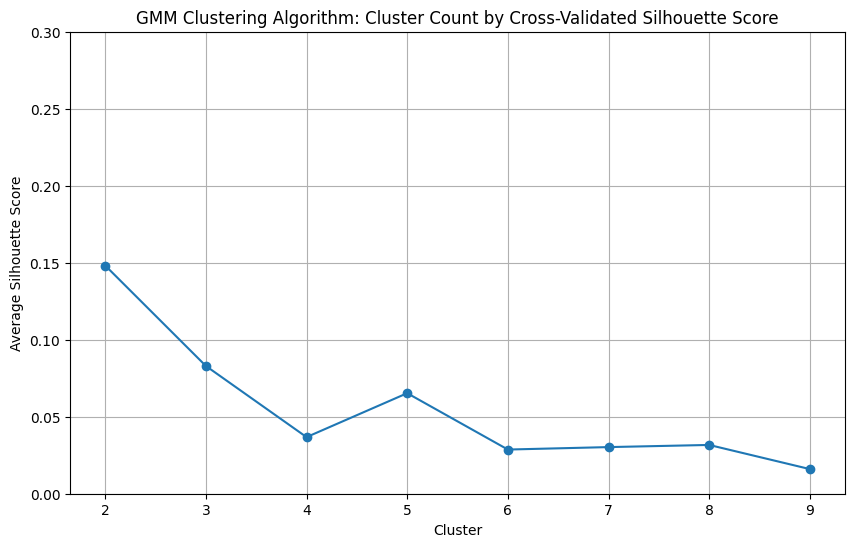

In [162]:
###################################
# Plotting the Average Silhouette Score performance
# by cluster count using the 5-fold results
# for the GMM Clustering algorithm
##################################
gaussian_mixture_kfold_cluster_count_values = np.array(gaussian_mixture_clustering_kfold_summary['GMM.KFold.Cluster.Count'].values)
gaussian_mixture_kfold_silhouette_score_values = np.array(gaussian_mixture_clustering_kfold_summary['GMM.KFold.Cluster.Average.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(gaussian_mixture_kfold_cluster_count_values, gaussian_mixture_kfold_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("GMM Clustering Algorithm: Cluster Count by Cross-Validated Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Average Silhouette Score")
plt.show()

In [163]:
##################################
# Fitting the GMM Clustering algorithm
# using a range of K values
# for the complete dataset
##################################
gaussian_mixture_cluster_list = list()
gaussian_mixture_cluster_silhouette_score = list()
for cluster_count in range(2,10):
    gm = GaussianMixture(n_components=cluster_count,
                         init_params='k-means++',
                         covariance_type='full',
                         tol = 1e-3,
                         random_state=88888888)
    gm = gm.fit(cancer_death_rate_premodelling_clustering)
    gaussian_mixture_cluster_list.append(cluster_count)
    gaussian_mixture_cluster_silhouette_score.append(silhouette_score(cancer_death_rate_premodelling_clustering, 
                                                                      gm.predict(cancer_death_rate_premodelling_clustering), 
                                                                      metric='euclidean'))

In [164]:
##################################
# Consolidating the model performance metrics
# for the GMM Clustering algorithm
# using a range of K values
# for the complete dataset
##################################
gaussian_mixture_clustering_evaluation_summary = pd.DataFrame(zip(gaussian_mixture_cluster_list,
                                                                  gaussian_mixture_cluster_silhouette_score), 
                                                              columns=['GMM.Cluster.Count',
                                                                       'GMM.Cluster.Silhouette.Score'])
gaussian_mixture_clustering_evaluation_summary

,GMM.Cluster.Count,GMM.Cluster.Silhouette.Score
0,2,0.1422
1,3,0.1959
2,4,0.1061
3,5,0.1168
4,6,0.1336
5,7,0.1308
6,8,0.1266
7,9,0.1338


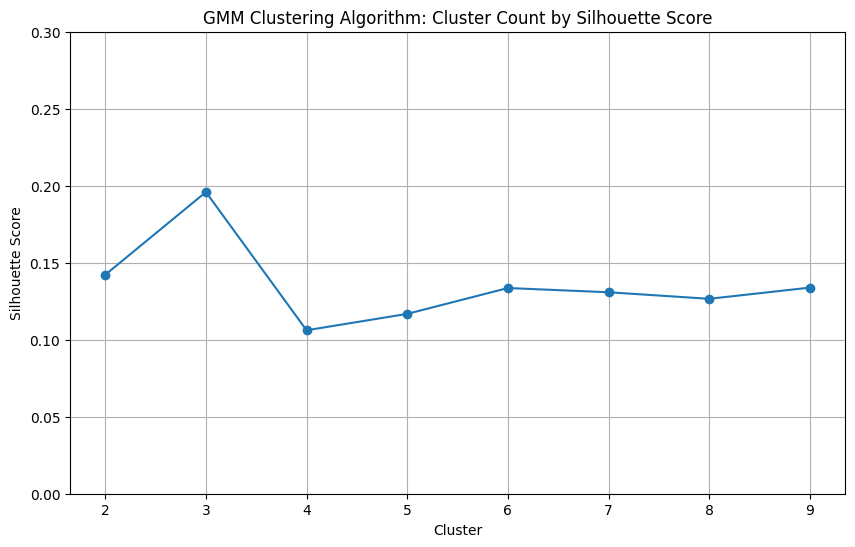

In [165]:
###################################
# Plotting the Silhouette Score performance
# by cluster count using a range of K values
# for the GMM Clustering algorithm
# for the complete dataset
##################################
gaussian_mixture_cluster_count_values = np.array(gaussian_mixture_clustering_evaluation_summary['GMM.Cluster.Count'].values)
gaussian_mixture_silhouette_score_values = np.array(gaussian_mixture_clustering_evaluation_summary['GMM.Cluster.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(gaussian_mixture_cluster_count_values, gaussian_mixture_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("GMM Clustering Algorithm: Cluster Count by Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Silhouette Score")
plt.show()

In [166]:
###################################
# Formulating the final GMM Clustering model
# using the optimal cluster count
##################################
gaussian_mixture_clustering = GaussianMixture(n_components=2,
                                              init_params='k-means++',
                                              random_state=88888888)
gaussian_mixture_clustering = gaussian_mixture_clustering.fit(cancer_death_rate_premodelling_clustering)

###################################
# Gathering the Silhouette Score
# for the final GMM Clustering model
##################################
gaussian_mixture_clustering_silhouette_score = silhouette_score(cancer_death_rate_premodelling_clustering, 
                                                                      gaussian_mixture_clustering.predict(cancer_death_rate_premodelling_clustering), 
                                                                      metric='euclidean')

In [167]:
##################################
# Plotting the cluster labels
# for the final GMM Clustering model
##################################
cancer_death_rate_gaussian_mixture_clustering = cancer_death_rate_premodelling_clustering.copy()
cancer_death_rate_gaussian_mixture_clustering['GMM_CLUSTER'] = gaussian_mixture_clustering.predict(cancer_death_rate_gaussian_mixture_clustering)
cancer_death_rate_gaussian_mixture_clustering.head()

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,GMM_CLUSTER
0,-0.6922,-0.4550,-0.1771,2.0964,0.9425,-1.4794,-0.6095,-0.9258,1.4059,1
1,-0.0867,-1.3608,-1.1020,0.3084,-1.4329,0.2506,0.8754,-0.7177,0.8924,1
2,-1.0261,-0.8704,-0.8184,-1.2331,-1.8001,-0.6858,-0.9625,-1.0428,-1.1914,1
3,0.0691,-0.3352,-0.8866,-0.1990,0.0272,1.2933,1.3658,1.5903,1.3091,0
4,0.5801,0.3703,1.0686,-0.0427,1.2150,-1.1052,-0.2718,-0.5826,-0.8379,0


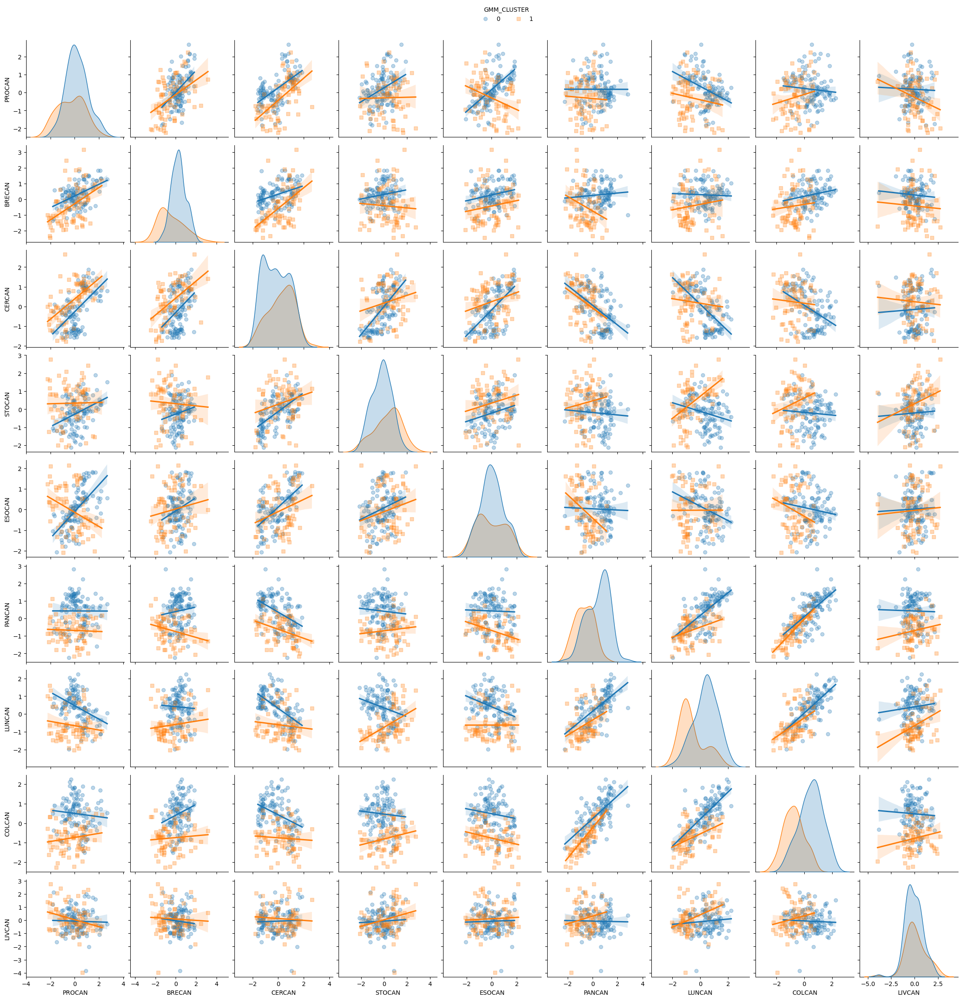

In [168]:
##################################
# Gathering the pairplot for all variables
# labelled using the final GMM Clustering model
##################################
cancer_death_rate_gaussian_mixture_clustering_plot = sns.pairplot(cancer_death_rate_gaussian_mixture_clustering,
                                                                  kind='reg',
                                                                  markers=["o", "s"],
                                                                  plot_kws={'scatter_kws': {'alpha': 0.3}},
                                                                  hue='GMM_CLUSTER');
sns.move_legend(cancer_death_rate_gaussian_mixture_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=2, title='GMM_CLUSTER', frameon=False)
plt.show()

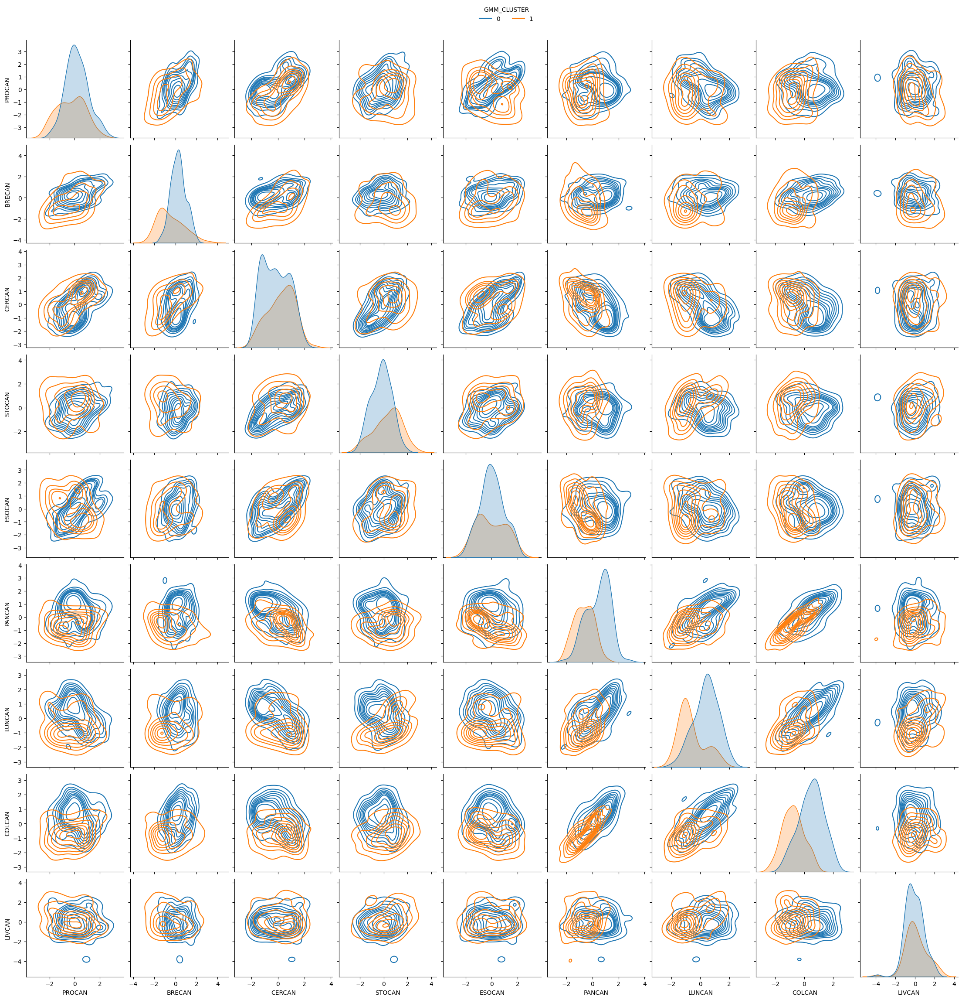

In [169]:
##################################
# Gathering the pairplot for all variables
# labelled using the final GMM Clustering model
##################################
cancer_death_rate_gaussian_mixture_clustering_plot = sns.pairplot(cancer_death_rate_gaussian_mixture_clustering,
                                                                  kind='kde',
                                                                  hue='GMM_CLUSTER');
sns.move_legend(cancer_death_rate_gaussian_mixture_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=2, title='GMM_CLUSTER', frameon=False)
plt.show()

### 1.3.5.5 Agglomerative Clustering <a class="anchor" id="1.3.5.5"></a>

1. The [agglomerative clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html#sklearn.cluster.AgglomerativeClustering) from the <mark style="background-color: #CCECFF"><b>sklearn.cluster</b></mark> Python library API was implemented. 
2. The model contains 2 hyperparameters:
    * <span style="color: #FF0000">n_cluster</span> = number of clusters to find made to vary between 2 to 9
    * <span style="color: #FF0000">linkage</span> = linkage criterion used to determine which distance to use between sets of observation held constant at a value equal to full (minimizes the maximum distance between observations of pairs of clusters)
3. Hyperparameter tuning was conducted on the data with optimal model performance using the silhouette score determined for: 
    * <span style="color: #FF0000">n_cluster</span> = 5
    * <span style="color: #FF0000">linkage</span> = full   
4. The 5-fold cross-validated model performance of the optimal model is summarized as follows:
    * **Silhouette Score** = 0.2339
5. To increase coverage for improved interpretability, the apparent model performance of the optimal model with 2 clusters was obtained as follows:
    * **Silhouette Score** = 0.1629
    

In [170]:
##################################
# Preparing the cross-validation data
# and parameters to be evaluated
# for the Agglomerative Clustering algorithm
##################################
X = cancer_death_rate_premodelling_clustering.copy()
agglomerative_kfold_cluster_list = range(2, 10)
agglomerative_kfold_cluster_silhouette_score = []

In [171]:
##################################
# Conducting the 5-fold cross-validation
# using the defined parameters
# for the Agglomerative Clustering algorithm
# for each individual cluster count
##################################
for k in agglomerative_kfold_cluster_list:
    ##################################
    # Defining the hyperparameters
    ##################################
    ag = AgglomerativeClustering(n_clusters=k, 
                                 linkage='complete')
    ##################################
    # Defining the 5-fold groups
    ##################################
    kfold = KFold(n_splits=5, 
                  shuffle=True, 
                  random_state=88888888)
    scores = []

    for train_index, test_index in kfold.split(X):
        ##################################
        # Formulating 5-fold groups
        ##################################
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        ##################################
        # Fitting the Agglomerative Clustering algorithm
        # on the train data
        ##################################
        ag.fit(X_train)
        ##################################
        # Assigning clusters for the test data
        ##################################
        labels = ag.fit_predict(X_test)
        ##################################
        # Computing for the silhouette score
        # on the test data
        ##################################
        score = silhouette_score(X_test, labels)
        scores.append(score)

    ##################################
    # Calculating the average silhouette score
    # for the given cluster count
    ##################################
    average_score = np.mean(scores)
    agglomerative_kfold_cluster_silhouette_score.append(average_score)

In [172]:
##################################
# Consolidating the model performance metrics
# for the Agglomerative Clustering algorithm
# using a range of K values
##################################
agglomerative_clustering_kfold_summary = pd.DataFrame(zip(agglomerative_kfold_cluster_list,
                                                          agglomerative_kfold_cluster_silhouette_score),
                                                      columns=['Agglomerative.KFold.Cluster.Count',
                                                               'Agglomerative.KFold.Cluster.Average.Silhouette.Score'])
agglomerative_clustering_kfold_summary

,Agglomerative.KFold.Cluster.Count,Agglomerative.KFold.Cluster.Average.Silhouette.Score
0,2,0.2232
1,3,0.2336
2,4,0.2285
3,5,0.2339
4,6,0.2256
5,7,0.2083
6,8,0.2231
7,9,0.2217


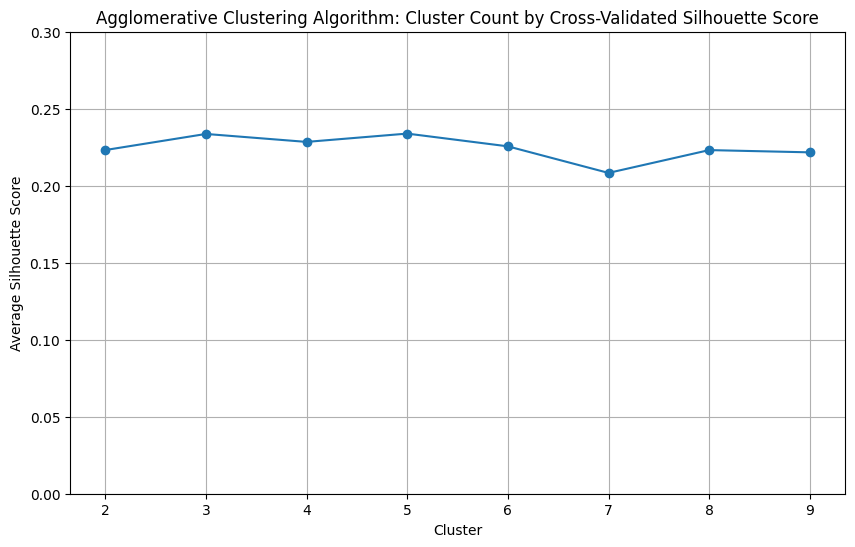

In [173]:
###################################
# Plotting the Average Silhouette Score performance
# by cluster count using the 5-fold results
# for the Agglomerative Clustering algorithm
##################################
agglomerative_kfold_cluster_count_values = np.array(agglomerative_clustering_kfold_summary['Agglomerative.KFold.Cluster.Count'].values)
agglomerative_kfold_silhouette_score_values = np.array(agglomerative_clustering_kfold_summary['Agglomerative.KFold.Cluster.Average.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(agglomerative_kfold_cluster_count_values, agglomerative_kfold_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("Agglomerative Clustering Algorithm: Cluster Count by Cross-Validated Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Average Silhouette Score")
plt.show()

In [174]:
##################################
# Fitting the Agglomerative Clustering algorithm
# using a range of K values
# for the complete dataset
##################################
agglomerative_cluster_list = list()
agglomerative_cluster_silhouette_score = list()
for cluster_count in range(2,10):
    ag = AgglomerativeClustering(n_clusters=cluster_count, 
                                 linkage='complete')
    ag = ag.fit(cancer_death_rate_premodelling_clustering)
    agglomerative_cluster_list.append(cluster_count)
    agglomerative_cluster_silhouette_score.append(silhouette_score(cancer_death_rate_premodelling_clustering, 
                                                                   ag.fit_predict(cancer_death_rate_premodelling_clustering), 
                                                                   metric='euclidean'))

In [175]:
##################################
# Consolidating the model performance metrics
# for the Agglomerative Clustering algorithm
# using a range of K values
# for the complete dataset
##################################
agglomerative_clustering_evaluation_summary = pd.DataFrame(zip(agglomerative_cluster_list,
                                                               agglomerative_cluster_silhouette_score), 
                                                           columns=['Agglomerative.Cluster.Count',
                                                                    'Agglomerative.Cluster.Silhouette.Score'])
agglomerative_clustering_evaluation_summary

,Agglomerative.Cluster.Count,Agglomerative.Cluster.Silhouette.Score
0,2,0.1629
1,3,0.1311
2,4,0.1127
3,5,0.1617
4,6,0.2035
5,7,0.1995
6,8,0.2006
7,9,0.1968


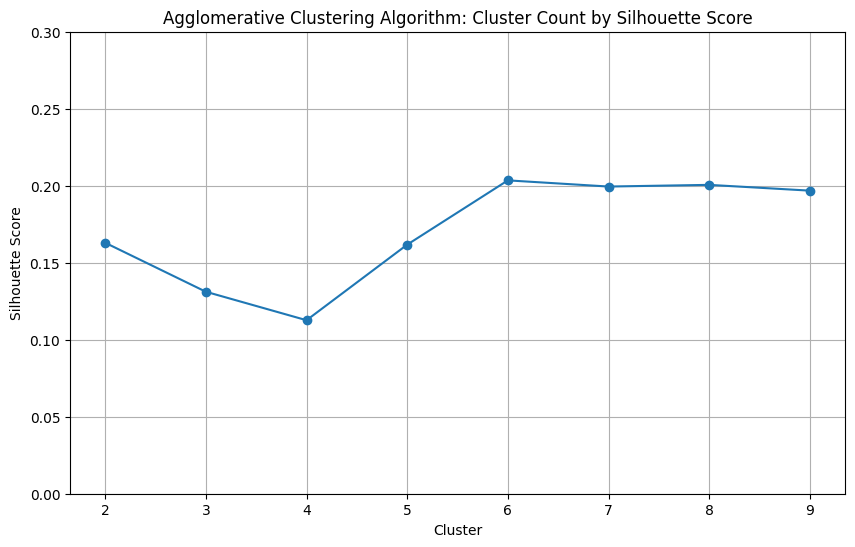

In [176]:
###################################
# Plotting the Silhouette Score performance
# by cluster count using a range of K values
# for the Agglomerative Clustering algorithm
# for the complete dataset
##################################
agglomerative_cluster_count_values = np.array(agglomerative_clustering_evaluation_summary['Agglomerative.Cluster.Count'].values)
agglomerative_silhouette_score_values = np.array(agglomerative_clustering_evaluation_summary['Agglomerative.Cluster.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(agglomerative_cluster_count_values, agglomerative_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("Agglomerative Clustering Algorithm: Cluster Count by Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Silhouette Score")
plt.show()

In [177]:
###################################
# Formulating the final Agglomerative Clustering model
# using the optimal cluster count
##################################
agglomerative_clustering = AgglomerativeClustering(n_clusters=5, 
                                                   linkage='complete')
agglomerative_clustering = agglomerative_clustering.fit(cancer_death_rate_premodelling_clustering)

###################################
# Gathering the Silhouette Score
# for the final K-Means Clustering model
##################################
agglomerative_clustering_silhouette_score = silhouette_score(cancer_death_rate_premodelling_clustering, agglomerative_clustering.labels_, metric='euclidean')

In [178]:
##################################
# Plotting the cluster labels
# for the final Agglomerative Clustering model
##################################
cancer_death_rate_agglomerative_clustering = cancer_death_rate_premodelling_clustering.copy()
cancer_death_rate_agglomerative_clustering['AGGLOMERATIVE_CLUSTER'] = agglomerative_clustering.fit_predict(cancer_death_rate_agglomerative_clustering)
cancer_death_rate_agglomerative_clustering.head()

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,AGGLOMERATIVE_CLUSTER
0,-0.6922,-0.4550,-0.1771,2.0964,0.9425,-1.4794,-0.6095,-0.9258,1.4059,1
1,-0.0867,-1.3608,-1.1020,0.3084,-1.4329,0.2506,0.8754,-0.7177,0.8924,0
2,-1.0261,-0.8704,-0.8184,-1.2331,-1.8001,-0.6858,-0.9625,-1.0428,-1.1914,4
3,0.0691,-0.3352,-0.8866,-0.1990,0.0272,1.2933,1.3658,1.5903,1.3091,0
4,0.5801,0.3703,1.0686,-0.0427,1.2150,-1.1052,-0.2718,-0.5826,-0.8379,2


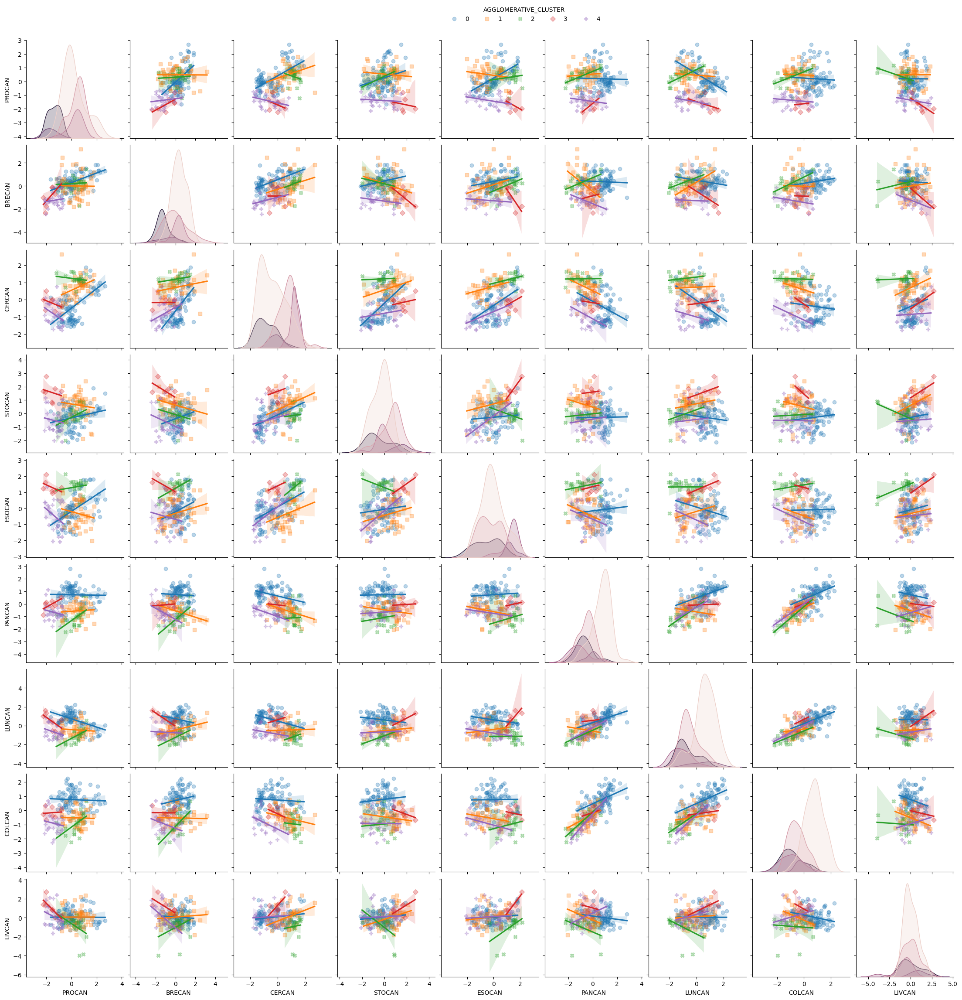

In [179]:
##################################
# Gathering the pairplot for all variables
# labelled using the final Agglomerative Clustering model
##################################
cancer_death_rate_agglomerative_clustering_plot = sns.pairplot(cancer_death_rate_agglomerative_clustering,
                                                               kind='reg',
                                                               markers=['o', 's','X','D','P'],
                                                               plot_kws={'scatter_kws': {'alpha': 0.3}},
                                                               hue='AGGLOMERATIVE_CLUSTER');
sns.move_legend(cancer_death_rate_agglomerative_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=5, title='AGGLOMERATIVE_CLUSTER', frameon=False)
plt.show()

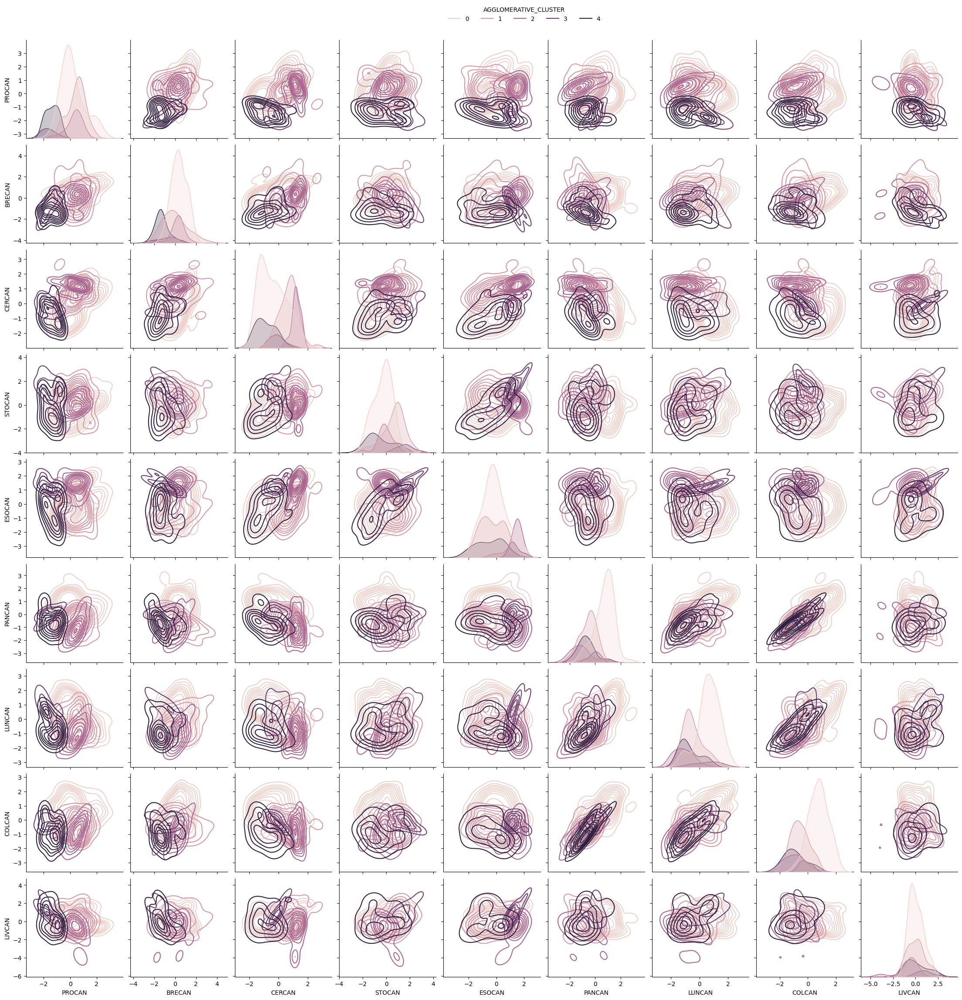

In [180]:
##################################
# Gathering the pairplot for all variables
# labelled using the final Agglomerative Clustering model
##################################
cancer_death_rate_agglomerative_clustering_plot = sns.pairplot(cancer_death_rate_agglomerative_clustering,
                                                               kind='kde',
                                                               hue='AGGLOMERATIVE_CLUSTER');
sns.move_legend(cancer_death_rate_agglomerative_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=5, title='AGGLOMERATIVE_CLUSTER', frameon=False)
plt.show()

### 1.3.5.6 Ward Hierarchical Clustering <a class="anchor" id="1.3.5.6"></a>

1. The [ward hierarchical clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html#sklearn.cluster.AgglomerativeClustering) from the <mark style="background-color: #CCECFF"><b>sklearn.cluster</b></mark> Python library API was implemented. 
2. The model contains 2 hyperparameters:
    * <span style="color: #FF0000">n_cluster</span> = number of clusters to find made to vary between 2 to 9
    * <span style="color: #FF0000">linkage</span> = linkage criterion used to determine which distance to use between sets of observation held constant at a value equal to ward (minimizes the sum of squared differences and variance within all clusters)
3. Hyperparameter tuning was conducted on the data with optimal model performance using the silhouette score determined for: 
    * <span style="color: #FF0000">n_cluster</span> = 9
    * <span style="color: #FF0000">linkage</span> = ward
4. The 5-fold cross-validated model performance of the optimal model is summarized as follows:
    * **Silhouette Score** = 0.2492
5. To increase coverage for improved interpretability, the apparent model performance of the optimal model with 2 clusters was obtained as follows:
    * **Silhouette Score** = 0.2148
    

In [181]:
##################################
# Preparing the cross-validation data
# and parameters to be evaluated
# for the Ward Hierarchical Clustering algorithm
##################################
X = cancer_death_rate_premodelling_clustering.copy()
ward_hierarchical_kfold_cluster_list = range(2, 10)
ward_hierarchical_kfold_cluster_silhouette_score = []

In [182]:
##################################
# Conducting the 5-fold cross-validation
# using the defined parameters
# for the Ward Hierarchical Clustering algorithm
# for each individual cluster count
##################################
for k in ward_hierarchical_kfold_cluster_list:
    ##################################
    # Defining the hyperparameters
    ##################################
    wh = AgglomerativeClustering(n_clusters=k, 
                                 linkage='ward')
    ##################################
    # Defining the 5-fold groups
    ##################################
    kfold = KFold(n_splits=5, 
                  shuffle=True, 
                  random_state=88888888)
    scores = []

    for train_index, test_index in kfold.split(X):
        ##################################
        # Formulating 5-fold groups
        ##################################
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        ##################################
        # Fitting the Ward Hierarchical Clustering algorithm
        # on the train data
        ##################################
        wh.fit(X_train)
        ##################################
        # Assigning clusters for the test data
        ##################################
        labels = wh.fit_predict(X_test)
        ##################################
        # Computing for the silhouette score
        # on the test data
        ##################################
        score = silhouette_score(X_test, labels)
        scores.append(score)

    ##################################
    # Calculating the average silhouette score
    # for the given cluster count
    ##################################
    average_score = np.mean(scores)
    ward_hierarchical_kfold_cluster_silhouette_score.append(average_score)

In [183]:
##################################
# Consolidating the model performance metrics
# for the Ward Hierarchical Clustering algorithm
# using a range of K values
##################################
ward_hierarchical_clustering_kfold_summary = pd.DataFrame(zip(ward_hierarchical_kfold_cluster_list,
                                                              ward_hierarchical_kfold_cluster_silhouette_score),
                                                          columns=['Ward.Hierarchical.KFold.Cluster.Count',
                                                                   'Ward.Hierarchical.KFold.Cluster.Average.Silhouette.Score'])
ward_hierarchical_clustering_kfold_summary

,Ward.Hierarchical.KFold.Cluster.Count,Ward.Hierarchical.KFold.Cluster.Average.Silhouette.Score
0,2,0.2173
1,3,0.2309
2,4,0.2312
3,5,0.2202
4,6,0.2269
5,7,0.2330
6,8,0.2411
7,9,0.2492


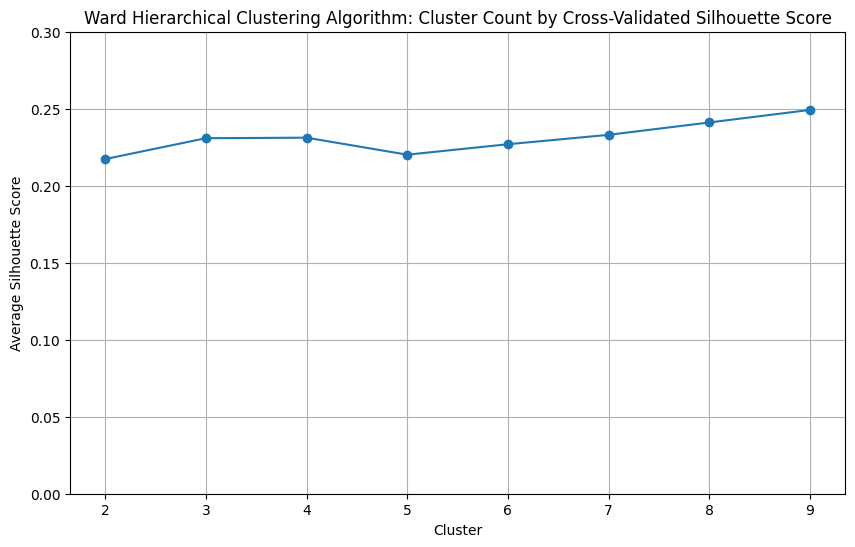

In [184]:
###################################
# Plotting the Average Silhouette Score performance
# by cluster count using the 5-fold results
# for the Ward Hierarchical Clustering algorithm
##################################
ward_hierarchical_kfold_cluster_count_values = np.array(ward_hierarchical_clustering_kfold_summary['Ward.Hierarchical.KFold.Cluster.Count'].values)
ward_hierarchical_kfold_silhouette_score_values = np.array(ward_hierarchical_clustering_kfold_summary['Ward.Hierarchical.KFold.Cluster.Average.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(ward_hierarchical_kfold_cluster_count_values, ward_hierarchical_kfold_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("Ward Hierarchical Clustering Algorithm: Cluster Count by Cross-Validated Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Average Silhouette Score")
plt.show()

In [185]:
##################################
# Fitting the Ward Hierarchical Clustering algorithm
# using a range of K values
##################################
ward_hierarchical_cluster_list = list()
ward_hierarchical_cluster_silhouette_score = list()
for cluster_count in range(2,10):
    wh = AgglomerativeClustering(n_clusters=cluster_count, 
                                 linkage='ward')
    wh = wh.fit(cancer_death_rate_premodelling_clustering)
    ward_hierarchical_cluster_list.append(cluster_count)
    ward_hierarchical_cluster_silhouette_score.append(silhouette_score(cancer_death_rate_premodelling_clustering, 
                                                                       wh.fit_predict(cancer_death_rate_premodelling_clustering), 
                                                                       metric='euclidean'))

In [186]:
##################################
# Consolidating the model performance metrics
# for the Ward Hierarchical Clustering algorithm
# using a range of K values
##################################
ward_hierarchical_clustering_evaluation_summary = pd.DataFrame(zip(ward_hierarchical_cluster_list,
                                                                   ward_hierarchical_cluster_silhouette_score), 
                                                           columns=['Ward.Hierarchical.Cluster.Count',
                                                                    'Ward.Hierarchical.Cluster.Silhouette.Score'])
ward_hierarchical_clustering_evaluation_summary

,Ward.Hierarchical.Cluster.Count,Ward.Hierarchical.Cluster.Silhouette.Score
0,2,0.2148
1,3,0.1924
2,4,0.1840
3,5,0.1714
4,6,0.1858
5,7,0.1803
6,8,0.1595
7,9,0.1689


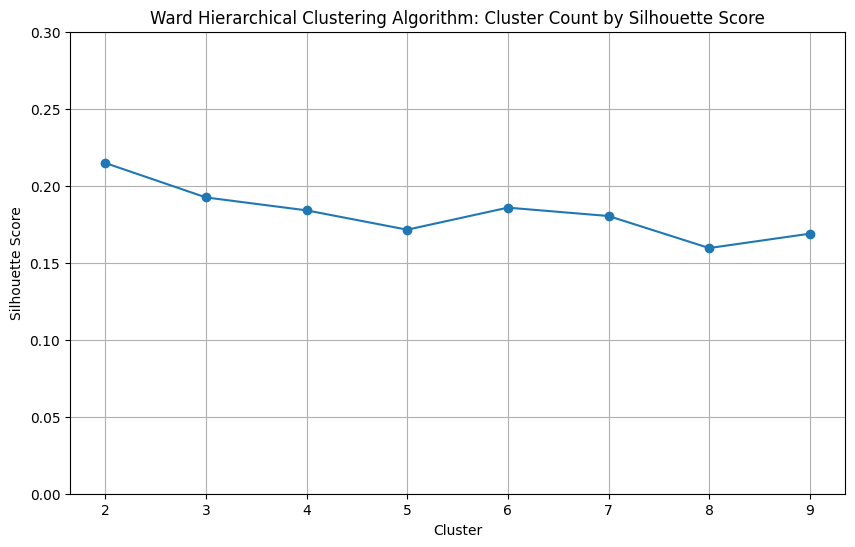

In [187]:
###################################
# Plotting the Silhouette Score performance
# by cluster count using a range of K values
# for the Ward Hierarchical Clustering algorithm
##################################
ward_hierarchical_cluster_count_values = np.array(ward_hierarchical_clustering_evaluation_summary['Ward.Hierarchical.Cluster.Count'].values)
ward_hierarchical_silhouette_score_values = np.array(ward_hierarchical_clustering_evaluation_summary['Ward.Hierarchical.Cluster.Silhouette.Score'].values)
plt.figure(figsize=(10, 6))
plt.plot(ward_hierarchical_cluster_count_values, ward_hierarchical_silhouette_score_values, marker='o',ls='-')
plt.grid(True)
plt.ylim(0,0.3)
plt.title("Ward Hierarchical Clustering Algorithm: Cluster Count by Silhouette Score")
plt.xlabel("Cluster")
plt.ylabel("Silhouette Score")
plt.show()

In [188]:
###################################
# Formulating the final Ward Hierarchical Clustering model
# using the optimal cluster count
##################################
ward_hierarchical_clustering = AgglomerativeClustering(n_clusters=9, 
                                                       linkage='ward')
ward_hierarchical_clustering = ward_hierarchical_clustering.fit(cancer_death_rate_premodelling_clustering)

###################################
# Gathering the Silhouette Score
# for the final Ward Hierarchical model
##################################
ward_hierarchical_clustering_silhouette_score = silhouette_score(cancer_death_rate_premodelling_clustering, ward_hierarchical_clustering.labels_, metric='euclidean')

In [189]:
##################################
# Plotting the cluster labels
# for the final Ward Hierarchical Clustering model
##################################
cancer_death_rate_ward_hierarchical_clustering = cancer_death_rate_premodelling_clustering.copy()
cancer_death_rate_ward_hierarchical_clustering['WARD_HIERARCHICAL_CLUSTER'] = ward_hierarchical_clustering.fit_predict(cancer_death_rate_ward_hierarchical_clustering)
cancer_death_rate_ward_hierarchical_clustering.head()

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,WARD_HIERARCHICAL_CLUSTER
0,-0.6922,-0.4550,-0.1771,2.0964,0.9425,-1.4794,-0.6095,-0.9258,1.4059,4
1,-0.0867,-1.3608,-1.1020,0.3084,-1.4329,0.2506,0.8754,-0.7177,0.8924,0
2,-1.0261,-0.8704,-0.8184,-1.2331,-1.8001,-0.6858,-0.9625,-1.0428,-1.1914,0
3,0.0691,-0.3352,-0.8866,-0.1990,0.0272,1.2933,1.3658,1.5903,1.3091,7
4,0.5801,0.3703,1.0686,-0.0427,1.2150,-1.1052,-0.2718,-0.5826,-0.8379,1


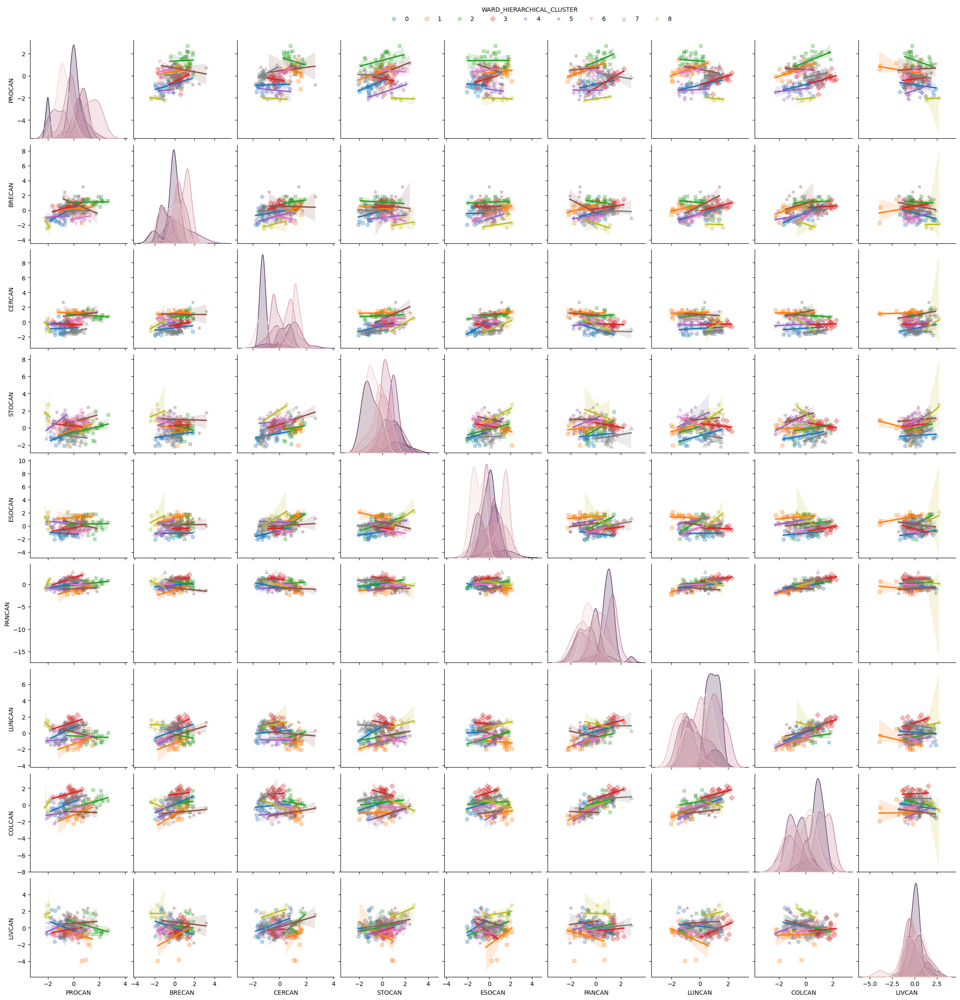

In [190]:
##################################
# Gathering the pairplot for all variables
# labelled using the final Ward Hierarchical Clustering model
##################################
cancer_death_rate_ward_hierarchical_clustering_plot = sns.pairplot(cancer_death_rate_ward_hierarchical_clustering,
                                                                   kind='reg',
                                                                   markers=['o', 's','X','D','P','*','v','^','h'],
                                                                   plot_kws={'scatter_kws': {'alpha': 0.3}},
                                                                   hue='WARD_HIERARCHICAL_CLUSTER');
sns.move_legend(cancer_death_rate_ward_hierarchical_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=9, title='WARD_HIERARCHICAL_CLUSTER', frameon=False)
plt.show()

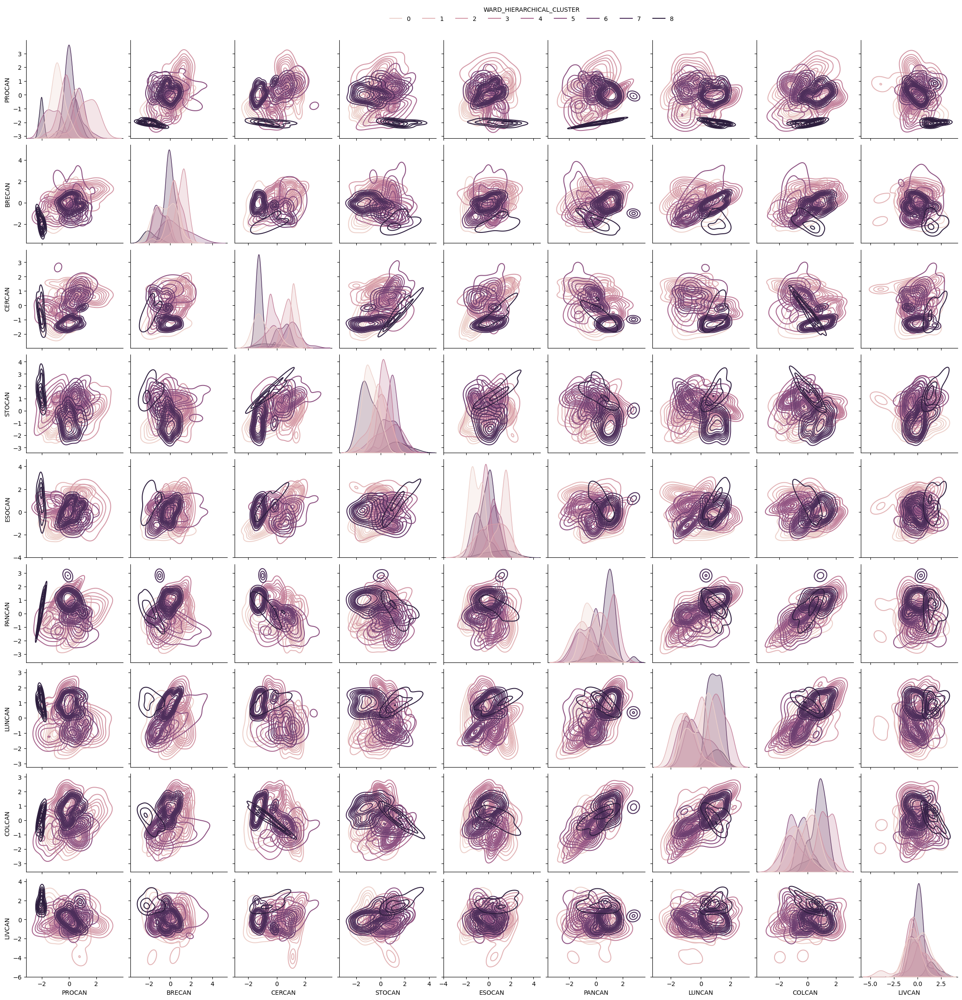

In [191]:
##################################
# Gathering the pairplot for all variables
# labelled using the final Ward Hierarchical Clustering model
##################################
cancer_death_rate_ward_hierarchical_clustering_plot = sns.pairplot(cancer_death_rate_ward_hierarchical_clustering,
                                                                   kind='kde',
                                                                   hue='WARD_HIERARCHICAL_CLUSTER');
sns.move_legend(cancer_death_rate_ward_hierarchical_clustering_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=9, title='WARD_HIERARCHICAL_CLUSTER', frameon=False)
plt.show()

### 1.3.6 Model Selection <a class="anchor" id="1.3.10"></a>

1. Among the range of cluster counts evaluated, the [k-means clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans) with 2 clusters provided the most compact intra-cluster and differential inter-cluster segmentation of countries based on cross-validation:
    * **K-Means Clustering Cross-Validated Silhouette Score** = 0.2315
2. Among the range of cluster counts evaluated, the [bisecting k-means clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.BisectingKMeans.html#sklearn.cluster.BisectingKMeans) with 2 clusters provided the most compact intra-cluster and differential inter-cluster segmentation of countries based on cross-validation:
    * **Bisecting K-Means Clustering Cross-Validated  Silhouette Score** = 0.2315
3. Among the range of cluster counts evaluated, the [gaussian mixture clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.mixture.GaussianMixture.html#sklearn.mixture.GaussianMixture) with 2 clusters provided the most compact intra-cluster and differential inter-cluster segmentation of countries based on cross-validation:
    * **Gaussian Mixture Clustering Cross-Validated  Silhouette Score** = 0.1289
4. Among the range of cluster counts evaluated, the [agglomerative clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html#sklearn.cluster.AgglomerativeClustering) with 5 clusters provided the most compact intra-cluster and differential inter-cluster segmentation of countries based on cross-validation:
    * **Agglomerative Clustering Cross-Validated  Silhouette Score** = 0.2339
5. Among the range of cluster counts evaluated, the [ward hierarchical clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html#sklearn.cluster.AgglomerativeClustering) with 9 clusters provided the most compact intra-cluster and differential inter-cluster segmentation of countries based on cross-validation:
    * **Ward Hierarchical Clustering Cross-Validated Silhouette Score** = 0.2412    
6. To increase coverage for improved interpretability, all clustering models were re-evaluated on the original data with 2 clusters for an objective comparison, with results as follows:
    * **K-Means Clustering Apparent Silhouette Score** = 0.2355 
    * **Bisecting K-Means Clustering Apparent Silhouette Score** = 0.2355 
    * **Gaussian Mixture Clustering Apparent Silhouette Score** = 0.2239
    * **Agglomerative Clustering Apparent Silhouette Score** = 0.1629 
    * **Ward Hierarchical Clustering Apparent Silhouette Score** = 0.2148 
6. Comparing all results from the clustering models formulated, the [k-means clustering model](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans) which demonstrated the highest silhouette score was selected as the final model for segmenting the countries based on similar characteristics. 
    * **K-Means Clustering Cross-Validated Silhouette Score** = 0.2315
    * **K-Means Clustering Apparent Silhouette Score** = 0.2355   
        

In [192]:
##################################
# Consolidating all the
# model performance measures
##################################
clustering_silhouette_score_list = [kmeans_clustering_silhouette_score,
                                    bisecting_kmeans_clustering_silhouette_score,
                                    gaussian_mixture_clustering_silhouette_score,
                                    agglomerative_clustering_silhouette_score,
                                    ward_hierarchical_clustering_silhouette_score]
clustering_silhouette_algorithm_list = ['kmeans_clustering',
                                        'bisecting_kmeans_clustering',
                                        'gaussian_mixture_clustering',
                                        'agglomerative_clustering',
                                        'ward_hierarchical_clustering']
performance_comparison_silhouette_score = pd.DataFrame(zip(clustering_silhouette_algorithm_list,
                                                           clustering_silhouette_score_list), 
                                                       columns=['Clustering.Algorithm',
                                                                'Silhouette.Score'])
print('Consolidated Model Performance: ')
display(performance_comparison_silhouette_score)

Consolidated Model Performance: 


,Clustering.Algorithm,Silhouette.Score
0,kmeans_clustering,0.2350
1,bisecting_kmeans_clustering,0.2350
2,gaussian_mixture_clustering,0.1422
3,agglomerative_clustering,0.1617
4,ward_hierarchical_clustering,0.1689


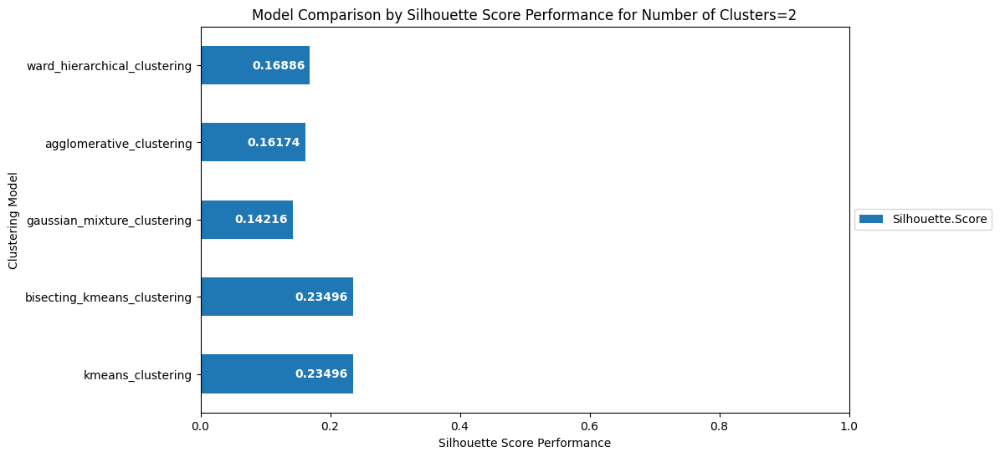

In [193]:
##################################
# Plotting all the Silhouette Score
# model performance measures
##################################
performance_comparison_silhouette_score.set_index('Clustering.Algorithm', inplace=True)
performance_comparison_silhouette_score_plot = performance_comparison_silhouette_score.plot.barh(figsize=(10, 6))
performance_comparison_silhouette_score_plot.set_xlim(0.00,1.00)
performance_comparison_silhouette_score_plot.set_title("Model Comparison by Silhouette Score Performance for Number of Clusters=2")
performance_comparison_silhouette_score_plot.set_xlabel("Silhouette Score Performance")
performance_comparison_silhouette_score_plot.set_ylabel("Clustering Model")
performance_comparison_silhouette_score_plot.grid(False)
performance_comparison_silhouette_score_plot.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
for container in performance_comparison_silhouette_score_plot.containers:
    performance_comparison_silhouette_score_plot.bar_label(container, fmt='%.5f', padding=-50, color='white', fontweight='bold')

### 1.3.7 Model Presentation <a class="anchor" id="1.3.7"></a>

#### 1.3.7.1 Clustering Visualization Plots <a class="anchor" id="1.3.7.1"></a>

1. Given the final **K-Means Clustering** model with 2 clusters, the following segmented groupings were observed from the formulated clusters as evaluated using pair plots, heat maps and geographic maps:  
    * **Cluster 0: HIGH_PAN_LUN_COL_LIV_CAN** composed of countries characterized by:
        * Higher death rates for pancreatic, lung, colon and liver cancers
        * Lower death rates for prostate, breast, cervical, stomach and esophageal cancers
        * Higher smoking prevalence, overweight prevalence and alcohol consumption
        * Predominantly from North America, Europe, West Asia, Central Asia, East Asia, Southeast Asia and Australia regions
    * **Cluster 1: HIGH_PRO_BRE_CER_STO_ESO_CAN** composed of countries characterized by:
        * Higher death rates for prostate, breast, cervical, stomach and esophageal cancers
        * Lower death rates for pancreatic, lung, colon and liver cancers
        * Lower smoking prevalence, overweight prevalence and alcohol consumption
        * Predominantly from South America, South Asia and Africa regions
        

In [194]:
##################################
# Exploring the selected final model
# using the clustering descriptors
# and K-Means clusters
##################################
cancer_death_rate_kmeans_clustering_descriptor = cancer_death_rate_kmeans_clustering.copy()
cancer_death_rate_kmeans_clustering_descriptor.head()

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,KMEANS_CLUSTER
0,-0.6922,-0.4550,-0.1771,2.0964,0.9425,-1.4794,-0.6095,-0.9258,1.4059,1
1,-0.0867,-1.3608,-1.1020,0.3084,-1.4329,0.2506,0.8754,-0.7177,0.8924,0
2,-1.0261,-0.8704,-0.8184,-1.2331,-1.8001,-0.6858,-0.9625,-1.0428,-1.1914,0
3,0.0691,-0.3352,-0.8866,-0.1990,0.0272,1.2933,1.3658,1.5903,1.3091,0
4,0.5801,0.3703,1.0686,-0.0427,1.2150,-1.1052,-0.2718,-0.5826,-0.8379,1


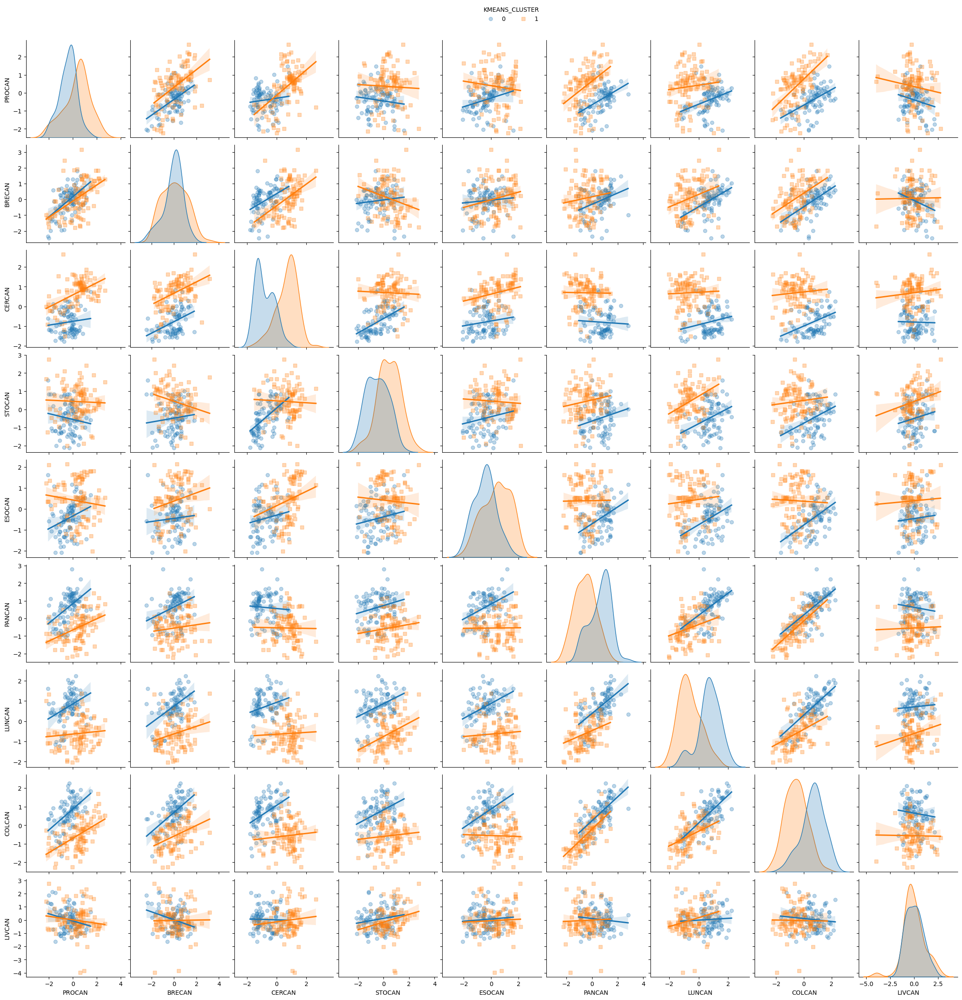

In [195]:
##################################
# Gathering the pairplot for all variables
# labelled using the final K-Means Clustering model
##################################
cancer_death_rate_kmeans_clustering_descriptor_plot = sns.pairplot(cancer_death_rate_kmeans_clustering_descriptor,
                                                        kind='reg',
                                                        markers=["o", "s"],
                                                        plot_kws={'scatter_kws': {'alpha': 0.3}},
                                                        hue='KMEANS_CLUSTER');
sns.move_legend(cancer_death_rate_kmeans_clustering_descriptor_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=2, title='KMEANS_CLUSTER', frameon=False)
plt.show()

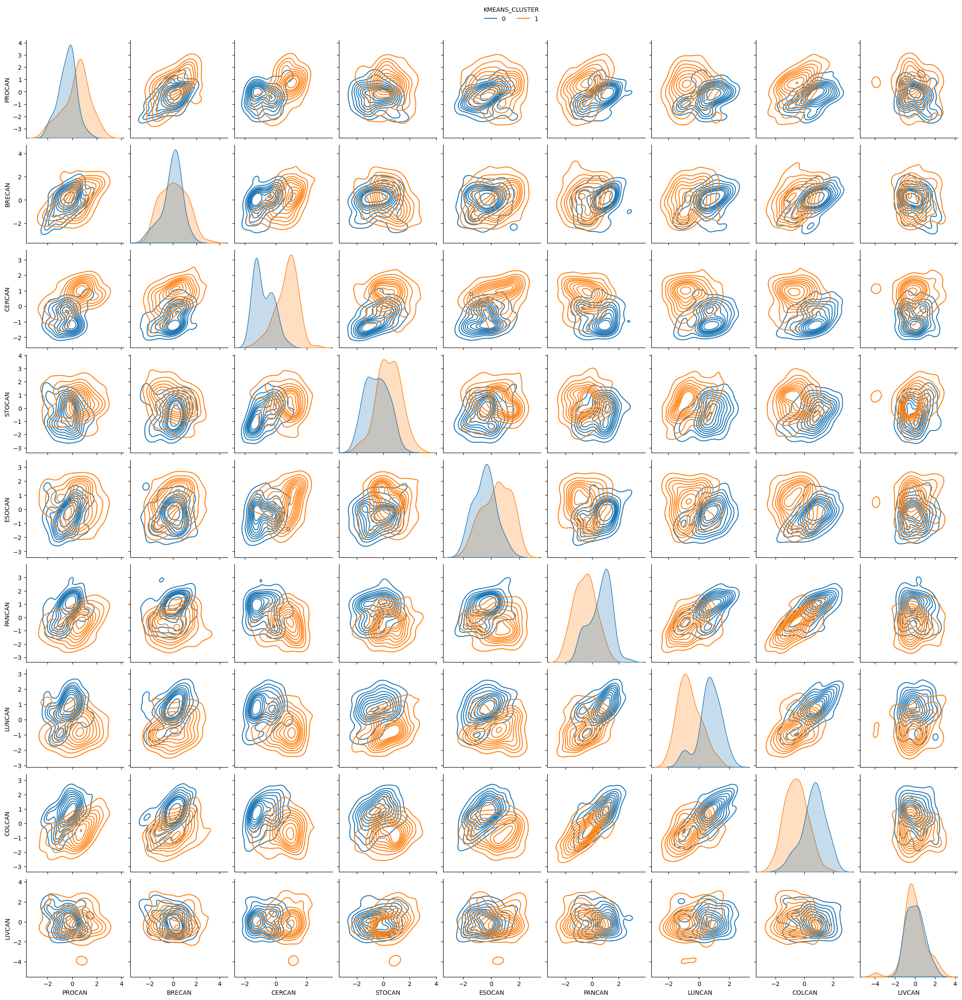

In [196]:
##################################
# Gathering the pairplot for all variables
# labelled using the final K-Means Clustering model
##################################
cancer_death_rate_kmeans_clustering_descriptor_plot = sns.pairplot(cancer_death_rate_kmeans_clustering_descriptor,
                                                        kind='kde',
                                                        hue='KMEANS_CLUSTER');
sns.move_legend(cancer_death_rate_kmeans_clustering_descriptor_plot, 
                "lower center",
                bbox_to_anchor=(.5, 1), ncol=2, title='KMEANS_CLUSTER', frameon=False)
plt.show()

In [197]:
##################################
# Computing the average descriptors
# for each K-Means Cluster
##################################
cancer_death_rate_kmeans_clustering_descriptor['KMEANS_CLUSTER'] = np.where(cancer_death_rate_kmeans_clustering_descriptor['KMEANS_CLUSTER']== 0,'HIGH_PAN_LUN_COL_LIV_CAN','HIGH_PRO_BRE_CER_STO_ESO_CAN')
cancer_death_rate_kmeans_descriptor_clustered = cancer_death_rate_kmeans_clustering_descriptor.groupby('KMEANS_CLUSTER').mean()
display(cancer_death_rate_kmeans_descriptor_clustered)

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN
KMEANS_CLUSTER,,,,,,,,,
HIGH_PAN_LUN_COL_LIV_CAN,-0.4007,-0.0831,-0.7966,-0.4951,-0.4531,0.6261,0.7090,0.6517,0.0372
HIGH_PRO_BRE_CER_STO_ESO_CAN,0.3475,0.0720,0.6910,0.4294,0.3930,-0.5431,-0.6150,-0.5653,-0.0322


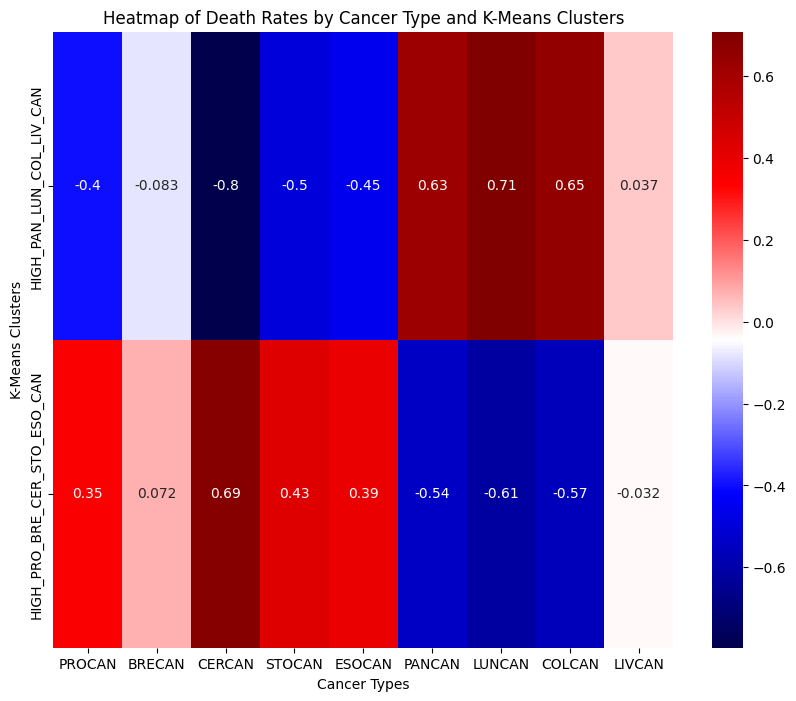

In [198]:
##################################
# Computing the average of the 
# clustering descriptors
# for each K-Means Cluster
##################################
plt.figure(figsize=(10, 8))
sns.heatmap(cancer_death_rate_kmeans_descriptor_clustered, annot=True, cmap="seismic")
plt.xlabel('Cancer Types')
plt.ylabel('K-Means Clusters')
plt.title('Heatmap of Death Rates by Cancer Type and K-Means Clusters')
plt.show()

In [199]:
##################################
# Exploring the selected final model
# using the target descriptors
# and K-Means clusters
##################################
cancer_death_rate_kmeans_clustering_target = pd.concat([cancer_death_rate_kmeans_clustering[['KMEANS_CLUSTER']],cancer_death_rate_preprocessed[['SMPREV','OWPREV','ACSHAR']]], axis=1, join='inner')
cancer_death_rate_kmeans_clustering_target['KMEANS_CLUSTER'] = np.where(cancer_death_rate_kmeans_clustering_target['KMEANS_CLUSTER']== 0,'HIGH_PAN_LUN_COL_LIV_CAN','HIGH_PRO_BRE_CER_STO_ESO_CAN')
cancer_death_rate_kmeans_clustering_target.head()

,KMEANS_CLUSTER,SMPREV,OWPREV,ACSHAR
0,HIGH_PRO_BRE_CER_STO_ESO_CAN,-0.5405,-1.4979,-1.6782
1,HIGH_PAN_LUN_COL_LIV_CAN,0.5329,0.6090,0.4008
2,HIGH_PAN_LUN_COL_LIV_CAN,-0.6438,0.9033,-1.3345
3,HIGH_PAN_LUN_COL_LIV_CAN,1.1517,1.0213,1.1371
4,HIGH_PRO_BRE_CER_STO_ESO_CAN,-1.0431,-1.2574,0.3520


In [200]:
##################################
# Computing the target descriptors
# for each K-Means Cluster
##################################
cancer_death_rate_kmeans_target_clustered = cancer_death_rate_kmeans_clustering_target.groupby('KMEANS_CLUSTER').mean()
display(cancer_death_rate_kmeans_target_clustered)

,SMPREV,OWPREV,ACSHAR
KMEANS_CLUSTER,,,
HIGH_PAN_LUN_COL_LIV_CAN,0.6337,0.4565,0.3360
HIGH_PRO_BRE_CER_STO_ESO_CAN,-0.5496,-0.3959,-0.2914


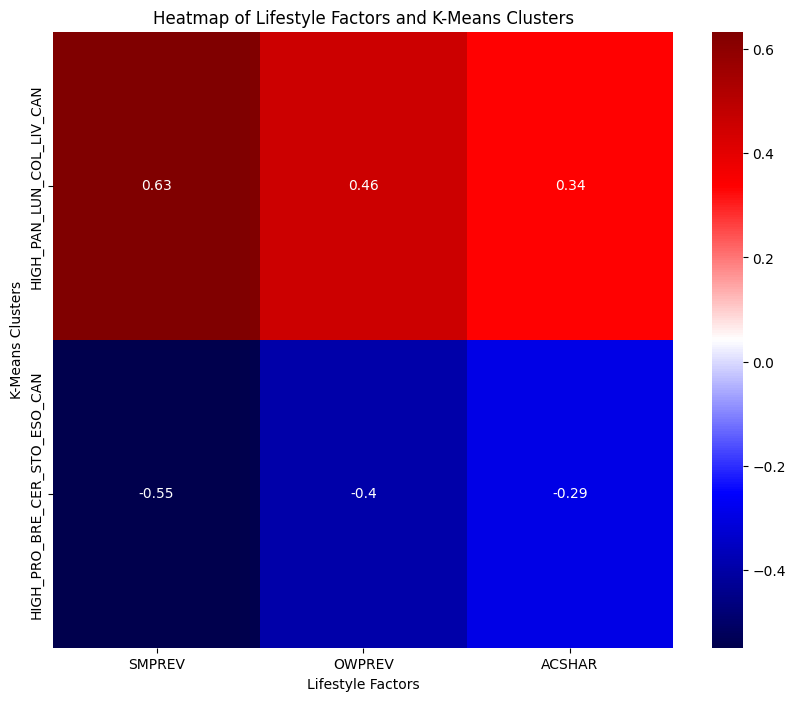

In [201]:
##################################
# Computing the average of the 
# target descriptors
# for each K-Means Cluster
##################################
plt.figure(figsize=(10, 8))
sns.heatmap(cancer_death_rate_kmeans_target_clustered, annot=True, cmap="seismic")
plt.xlabel('Lifestyle Factors')
plt.ylabel('K-Means Clusters')
plt.title('Heatmap of Lifestyle Factors and K-Means Clusters')
plt.show()

In [202]:
##################################
# Exploring the selected final model
# using the location data
# and K-Means clusters
##################################
cancer_death_rate_kmeans_cluster_map = pd.concat([cancer_death_rate_kmeans_clustering_target[['KMEANS_CLUSTER']],cancer_death_rate_filtered_row[['CODE']]], axis=1, join='inner')
cancer_death_rate_kmeans_cluster_map.head()

,KMEANS_CLUSTER,CODE
0,HIGH_PRO_BRE_CER_STO_ESO_CAN,AFG
1,HIGH_PAN_LUN_COL_LIV_CAN,ALB
2,HIGH_PAN_LUN_COL_LIV_CAN,DZA
3,HIGH_PAN_LUN_COL_LIV_CAN,AND
4,HIGH_PRO_BRE_CER_STO_ESO_CAN,AGO


In [203]:
##################################
# Loading the globalmap shape file 
##################################
world = gpd.read_file(os.path.join("..", REFERENCES_PATH, "custom.geo.json"))

In [204]:
##################################
# Merging the GeoDataFrame 
# with world map using country codes
##################################
world_cluster = world.merge(cancer_death_rate_kmeans_cluster_map, left_on='gu_a3', right_on='CODE', how='left')

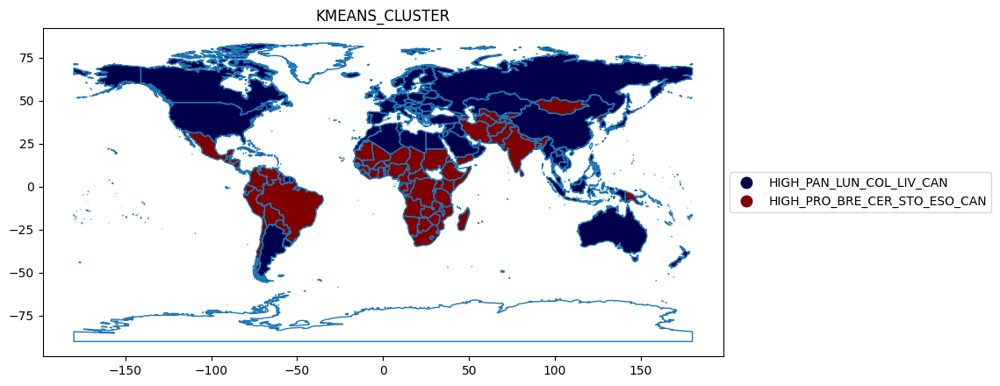

In [205]:
##################################
# Plotting the map by K-Means cluster
##################################
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
world_cluster.boundary.plot(ax=ax, linewidth=1) 
world_cluster.plot(column='KMEANS_CLUSTER', cmap="seismic", legend=True, ax=ax, legend_kwds={"loc": "center left", "bbox_to_anchor": (1, 0.5)})
plt.title('KMEANS_CLUSTER')
plt.show()

In [206]:
##################################
# Plotting the map by K-Means descriptors
##################################
cancer_death_rate_kmeans_descriptor_map = pd.concat([cancer_death_rate_kmeans_clustering_descriptor,cancer_death_rate_filtered_row[['CODE']]], axis=1, join='inner')
cancer_death_rate_kmeans_descriptor_map.head()

,PROCAN,BRECAN,CERCAN,STOCAN,ESOCAN,PANCAN,LUNCAN,COLCAN,LIVCAN,KMEANS_CLUSTER,CODE
0,-0.6922,-0.4550,-0.1771,2.0964,0.9425,-1.4794,-0.6095,-0.9258,1.4059,HIGH_PRO_BRE_CER_STO_ESO_CAN,AFG
1,-0.0867,-1.3608,-1.1020,0.3084,-1.4329,0.2506,0.8754,-0.7177,0.8924,HIGH_PAN_LUN_COL_LIV_CAN,ALB
2,-1.0261,-0.8704,-0.8184,-1.2331,-1.8001,-0.6858,-0.9625,-1.0428,-1.1914,HIGH_PAN_LUN_COL_LIV_CAN,DZA
3,0.0691,-0.3352,-0.8866,-0.1990,0.0272,1.2933,1.3658,1.5903,1.3091,HIGH_PAN_LUN_COL_LIV_CAN,AND
4,0.5801,0.3703,1.0686,-0.0427,1.2150,-1.1052,-0.2718,-0.5826,-0.8379,HIGH_PRO_BRE_CER_STO_ESO_CAN,AGO


In [207]:
##################################
# Merging the GeoDataFrame 
# with world map using country codes
##################################
world_descriptor = world.merge(cancer_death_rate_kmeans_descriptor_map, left_on='gu_a3', right_on='CODE', how='left')

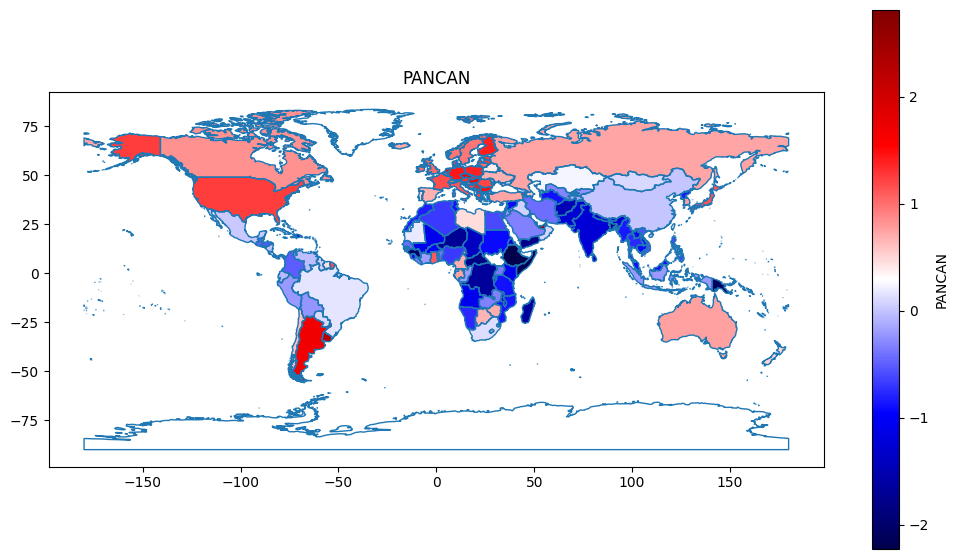

In [208]:
##################################
# Plotting the map by Pancreatic Cancer Death Rate
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7))
world_descriptor.boundary.plot(ax=ax, linewidth=1) 
world_descriptor.plot(column='PANCAN', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "PANCAN"})
plt.title('PANCAN')
plt.show()

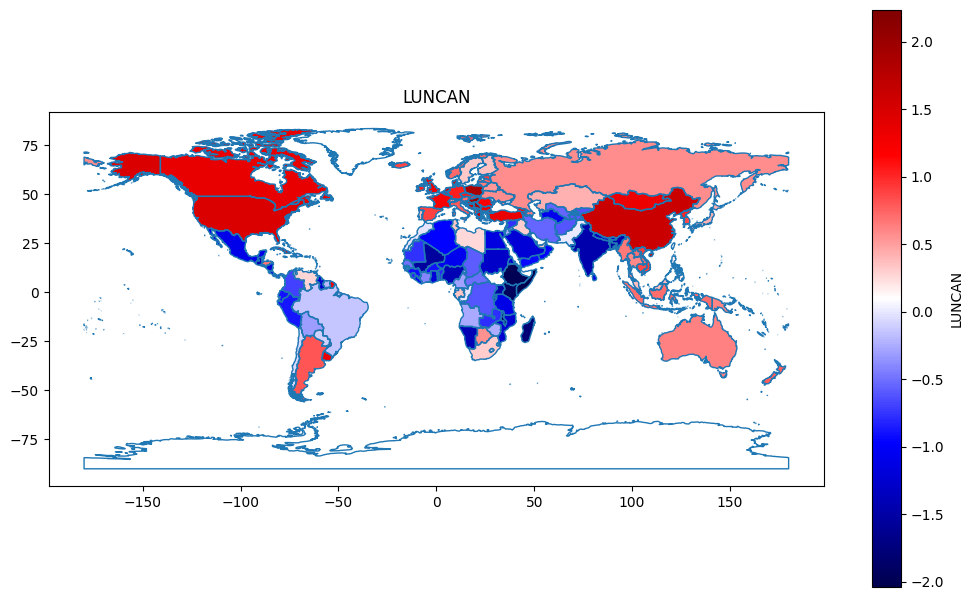

In [209]:
##################################
# Plotting the map by Lung Cancer Death Rate
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7.5))
world_descriptor.boundary.plot(ax=ax, linewidth=1) 
world_descriptor.plot(column='LUNCAN', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "LUNCAN"})
plt.title('LUNCAN')
plt.show()

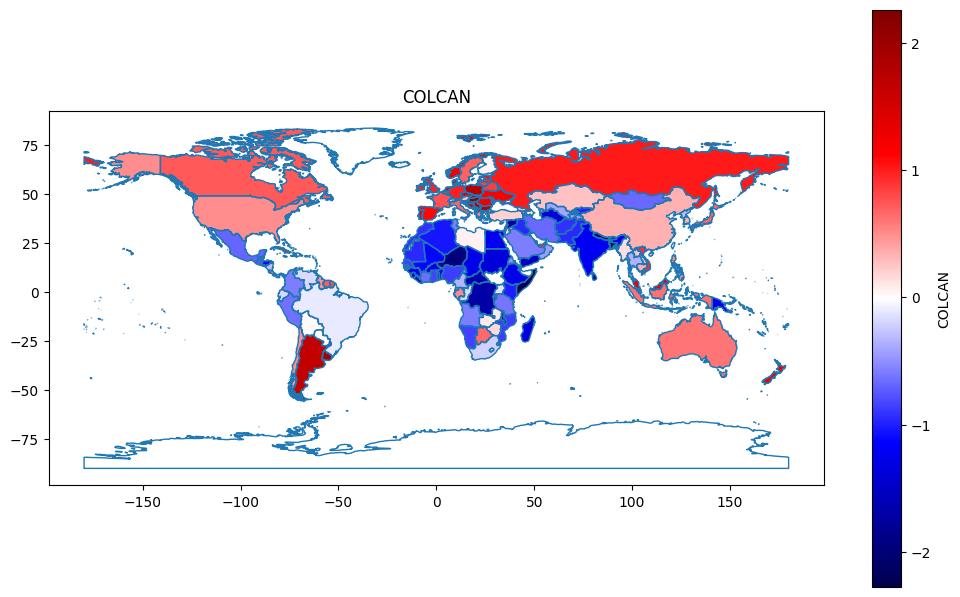

In [210]:
##################################
# Plotting the map by Colon Cancer Death Rate
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7.5))
world_descriptor.boundary.plot(ax=ax, linewidth=1) 
world_descriptor.plot(column='COLCAN', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "COLCAN"})
plt.title('COLCAN')
plt.show()

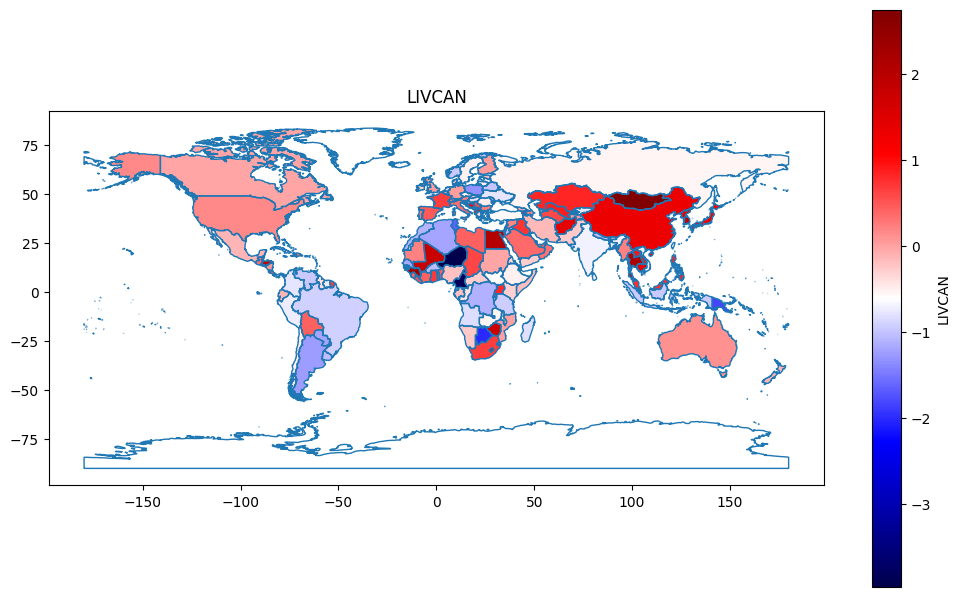

In [211]:
##################################
# Plotting the map by Liver Cancer Death Rate
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7.5))
world_descriptor.boundary.plot(ax=ax, linewidth=1) 
world_descriptor.plot(column='LIVCAN', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "LIVCAN"})
plt.title('LIVCAN')
plt.show()

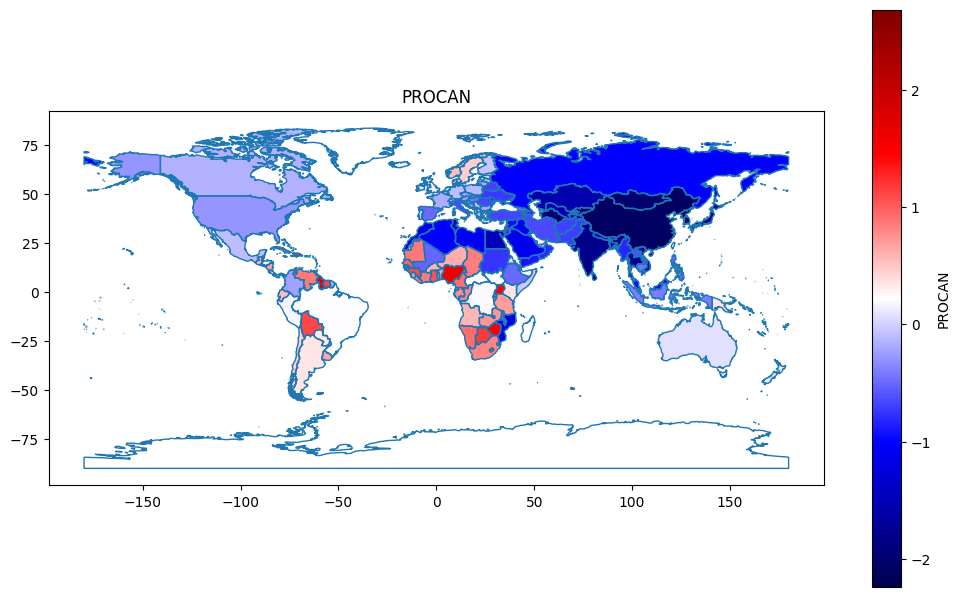

In [212]:
##################################
# Plotting the map by Prostate Cancer Death Rate
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7.5))
world_descriptor.boundary.plot(ax=ax, linewidth=1) 
world_descriptor.plot(column='PROCAN', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "PROCAN"})
plt.title('PROCAN')
plt.show()

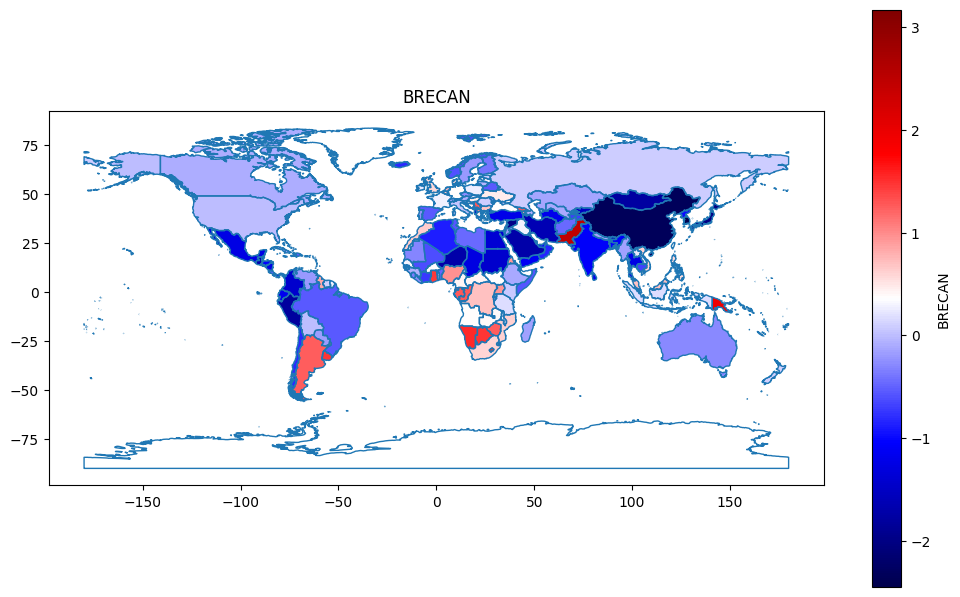

In [213]:
##################################
# Plotting the map by Breast Cancer Death Rate
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7.5))
world_descriptor.boundary.plot(ax=ax, linewidth=1) 
world_descriptor.plot(column='BRECAN', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "BRECAN"})
plt.title('BRECAN')
plt.show()

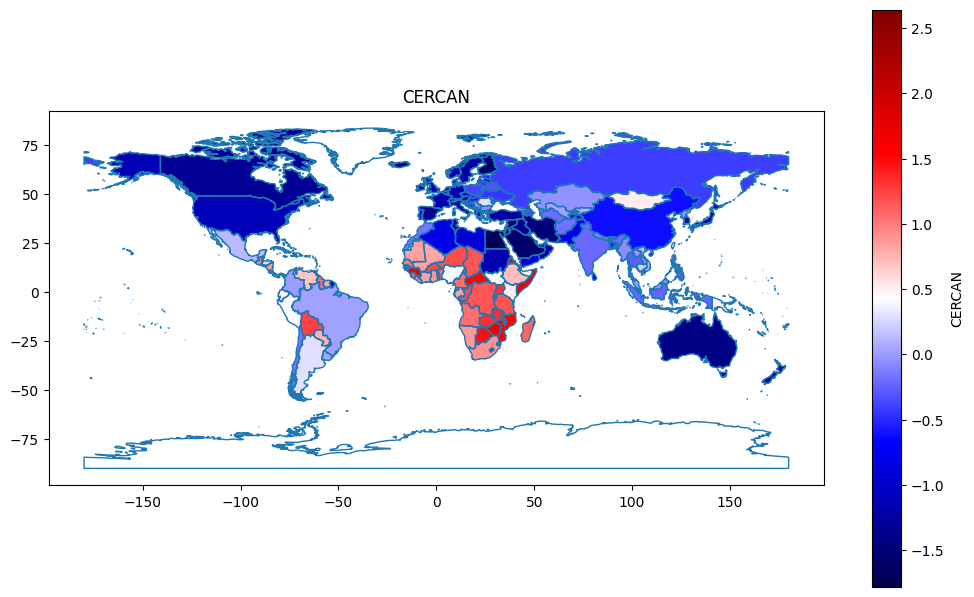

In [214]:
##################################
# Plotting the map by Cervical Cancer Death Rate
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7.5))
world_descriptor.boundary.plot(ax=ax, linewidth=1) 
world_descriptor.plot(column='CERCAN', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "CERCAN"})
plt.title('CERCAN')
plt.show()

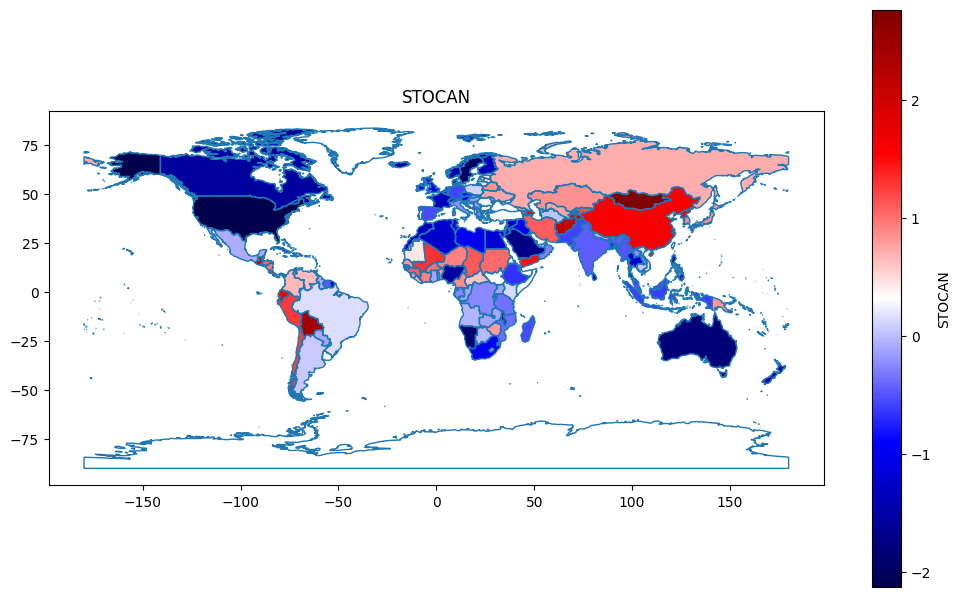

In [215]:
##################################
# Plotting the map by Stomach Cancer Death Rate
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7.5))
world_descriptor.boundary.plot(ax=ax, linewidth=1) 
world_descriptor.plot(column='STOCAN', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "STOCAN"})
plt.title('STOCAN')
plt.show()

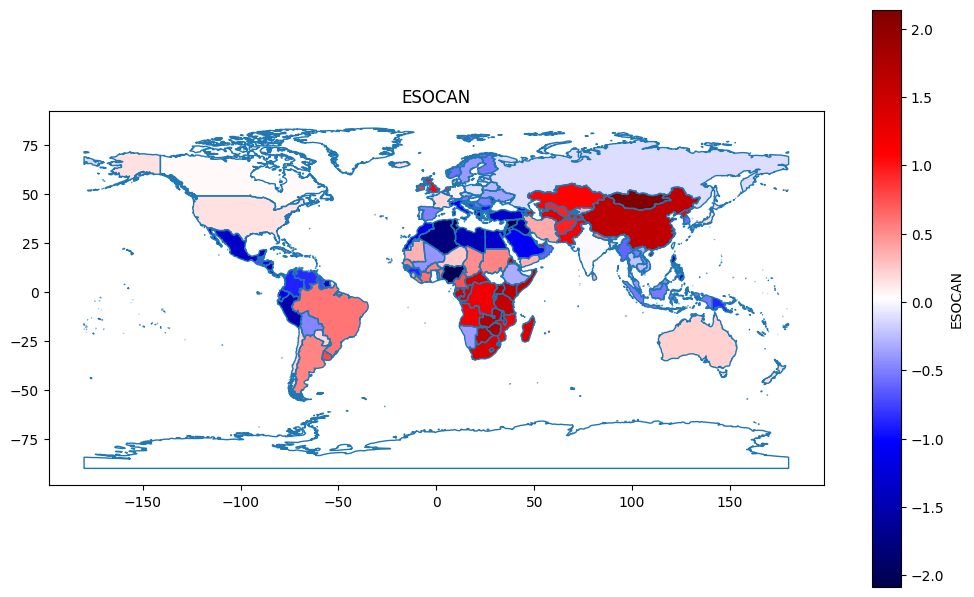

In [216]:
##################################
# Plotting the map by Esophagus Cancer Death Rate
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7.5))
world_descriptor.boundary.plot(ax=ax, linewidth=1) 
world_descriptor.plot(column='ESOCAN', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "ESOCAN"})
plt.title('ESOCAN')
plt.show()

In [217]:
##################################
# Plotting the map by K-Means target
##################################
cancer_death_rate_kmeans_target_map = pd.concat([cancer_death_rate_kmeans_clustering_target,cancer_death_rate_filtered_row[['CODE']]], axis=1, join='inner')
cancer_death_rate_kmeans_target_map.head()

,KMEANS_CLUSTER,SMPREV,OWPREV,ACSHAR,CODE
0,HIGH_PRO_BRE_CER_STO_ESO_CAN,-0.5405,-1.4979,-1.6782,AFG
1,HIGH_PAN_LUN_COL_LIV_CAN,0.5329,0.6090,0.4008,ALB
2,HIGH_PAN_LUN_COL_LIV_CAN,-0.6438,0.9033,-1.3345,DZA
3,HIGH_PAN_LUN_COL_LIV_CAN,1.1517,1.0213,1.1371,AND
4,HIGH_PRO_BRE_CER_STO_ESO_CAN,-1.0431,-1.2574,0.3520,AGO


In [218]:
##################################
# Merging the GeoDataFrame 
# with world map using country codes
##################################
world_target = world.merge(cancer_death_rate_kmeans_target_map, left_on='gu_a3', right_on='CODE', how='left')

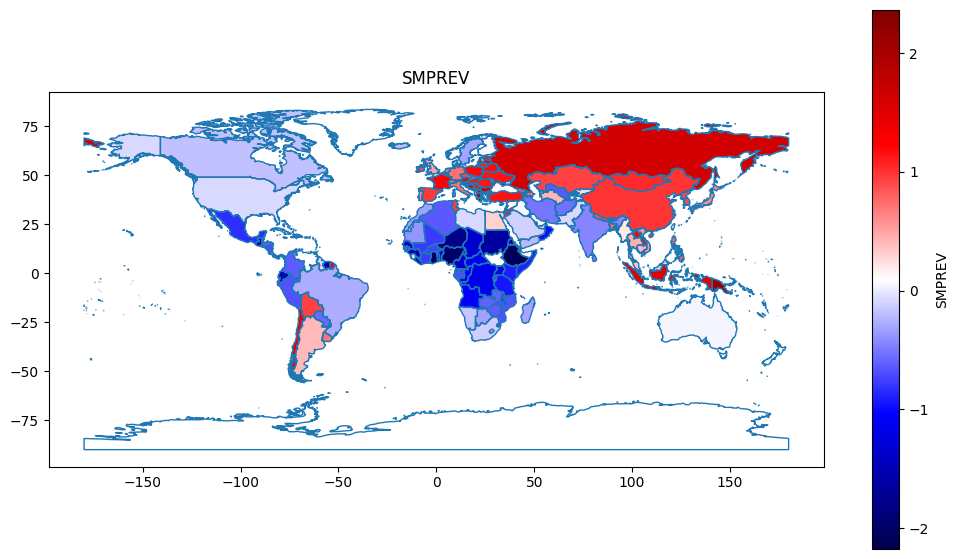

In [219]:
##################################
# Plotting the map by Smoking Prevalence
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7))
world_target.boundary.plot(ax=ax, linewidth=1) 
world_target.plot(column='SMPREV', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "SMPREV"})
plt.title('SMPREV')
plt.show()

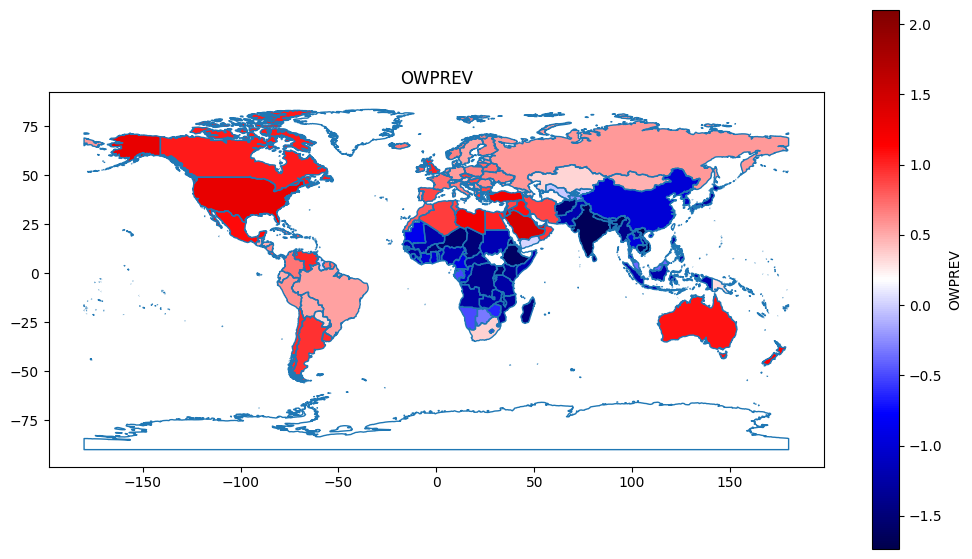

In [220]:
##################################
# Plotting the map by Overweight Prevalence
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7))
world_target.boundary.plot(ax=ax, linewidth=1) 
world_target.plot(column='OWPREV', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "OWPREV"})
plt.title('OWPREV')
plt.show()

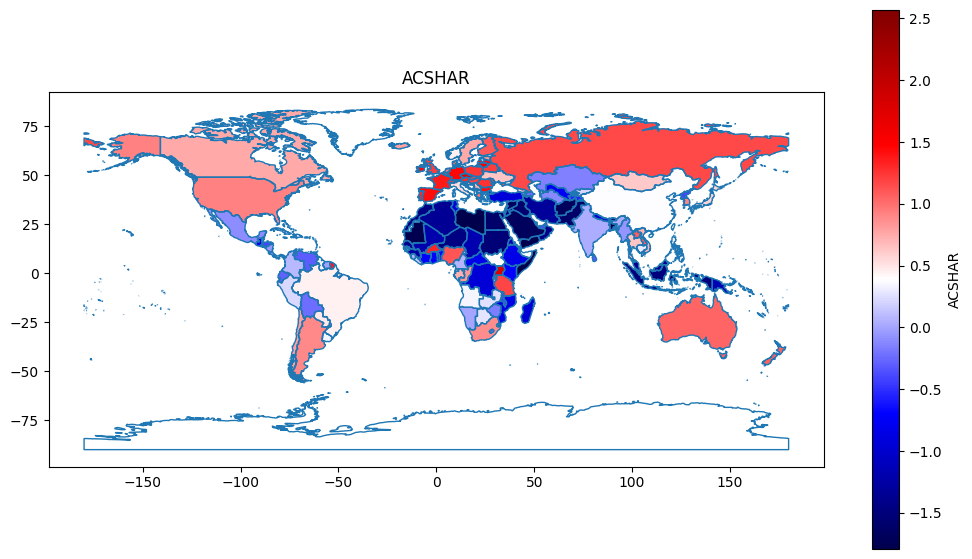

In [221]:
##################################
# Plotting the map by Alcohol Consumption
##################################
fig, ax = plt.subplots(1, 1, figsize=(12.5, 7))
world_target.boundary.plot(ax=ax, linewidth=1) 
world_target.plot(column='ACSHAR', cmap="seismic", legend=True, ax=ax, legend_kwds={'label': "ACSHAR"})
plt.title('ACSHAR')
plt.show()

# 2. Summary <a class="anchor" id="Summary"></a>

**A k-means clustering model with 2 clusters enabled the efficient segmentation of countries into distinct groups and provided a more granular view of relationships across different cancer mortality rates (pancreatic cancer, lung cancer, colorectal cancer, liver cancer, prostate cancer, breast cancer, cervical cancer, stomach cancer, esophageal cancer), lifestyle factors (smoking prevalence, overweight prevalence, alcohol consumption) and geographical information (region) – with characteristics described as follows:**

* **Cluster 0 : HIGH_PAN_LUN_COL_LIV_CAN composed of countries characterized by:**
    * **Higher death rates for pancreatic, lung, colon and liver cancers**
    * **Lower death rates for prostate, breast, cervical, stomach and esophageal cancers**
    * **Higher smoking prevalence, overweight prevalence and alcohol consumption**
    * **Predominantly from North America, Europe, Central | Southeast | East | West Asia and Australia**
* **Cluster 1: HIGH_PRO_BRE_CER_STO_ESO_CAN composed of countries characterized by:**
    * **Higher death rates for prostate, breast, cervical, stomach and esophageal cancers**
    * **Lower death rates for pancreatic, lung, colon and liver cancers**
    * **Lower smoking prevalence, overweight prevalence and alcohol consumption**
    * **Predominantly from Central | South America, South Asia and Africa**

**Overall, disparities in cancer mortality were observed among groups of countries with contrasting lifestyle choices and geographic locations. Shared risk factors, socio-economic demographics and genetic predisposition may be potential drivers to the observed associations between death rates among certain cancer types. Unhealthy lifestyle choices, including smoking, obesity, and excessive alcohol consumption, may be well-established risk factors for cancer through direct and indirect effects on cellular processes, inflammation, DNA damage, and hormonal regulation. Additionally, the geographic locations of countries can have a substantial impact on cancer mortality rates driven by a complex interplay of various effects, encompassing differences in healthcare infrastructure, socio-economic conditions, cultural dissimilarities, environmental exposures, access to screening and early detection, among others.**

* From an initial dataset comprised of 208 observations and 16 descriptors, an optimal subset of **183 observations and 16 descriptors** representing cancer mortality, lifestyle factors and geolocation descriptors were determined after conducting data quality assessment, excluding cases noted with irregularities and applying preprocessing operations most suitable for the downstream analysis. All data quality issues were addressed without the need to eliminate existing descriptors in the study

* Multiple clustering modelling algorithms with various cluster counts were formulated using **K-Means**, **Bisecting K-Means**, **Gaussian Mixture Model**, **Agglomerative** and **Ward Hierarchical** methods. The best model with optimized hyperparameters from each algorithm was determined through internal resampling validation using **5-Fold Cross Validation** using the **Silhouette Score** used as the primary performance metric. Due to the unsupervised learning nature of the analysis, all candidate models were compared based on internal validation and apparent performance.

* The final model selected among candidates used **K-Means Clustering** with optimal hyperparameters: **number of clusters to form and centroids to generate (n_clusters=2)**, **number of times the k-means algorithm is run with different centroid seeds(n_init=auto equivalent to 1)**, **method for initialization (init=k-means++ equivalent to selecting initial cluster centroids using sampling based on an empirical probability distribution of the points’ contribution to the overall inertia)**. This model demonstrated the best cross-validated (**Silhouette Score=0.23**) and apparent Silhouette Scores (**Silhouette Score=0.24**) under an assumption of 2 optimal clusters reflecting a moderate quality of the formulated clusters.

* Post-hoc exploration of the model results involved clustering visualization methods using **Pair Plots**, **Heat Maps** and **Geographic Maps** - providing an intuitive method to investigate and understand the characteristics of the two discovered cancer clusters (**Cluster 0 : HIGH_PAN_LUN_COL_LIV_CAN** and **Cluster 1: HIGH_PRO_BRE_CER_STO_ESO_CAN**) across countries in terms of death rates, lifestyle factors and geolocation. These findings aided in the formulation of insights on the relationship and association of the various descriptors for the clusters identified.

**The current results have limitations which can be further addressed by extending the study to include the following actions:**
* Conducting sensitivity analysis to assess the robustness of the clustering results to variations in hyperparameters, distance metrics, or preprocessing techniques
* Considering other clustering performance measures to externally validate the clustering algorithm results and assess performance relative to external criteria
* Establishing a baseline performance by running each algorithm with default parameters to serve as a reference point for evaluating the effectiveness of parameter tuning and algorithm selection
* Exploring ensemble methods to combine results from multiple clustering algorithms which can improve robustness and stability by reducing the impact of algorithmic biases
* Applying dimensionality reduction techniques such as PCA, t-SNE, or UMAP before visualization to reduce the data to a manageable number of dimensions.


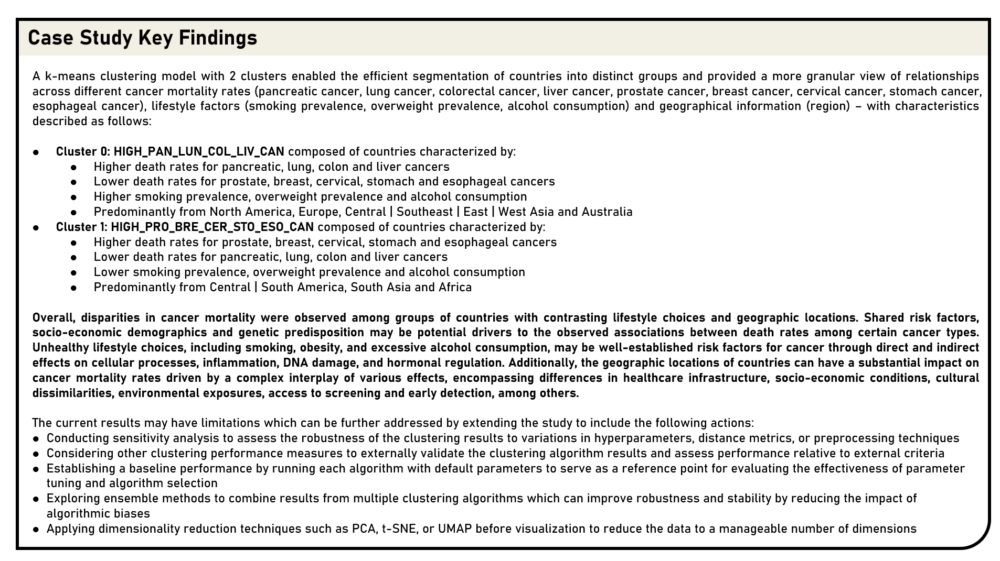

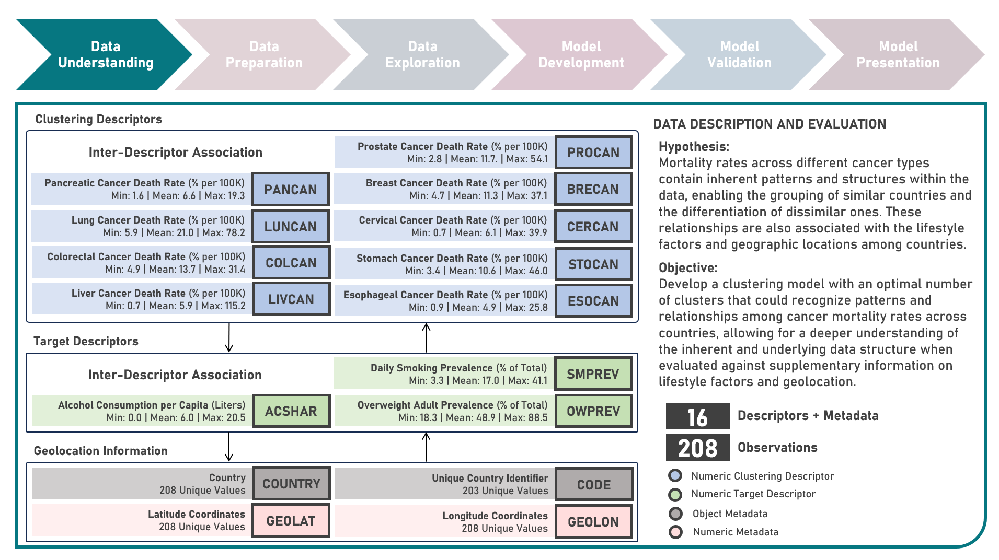

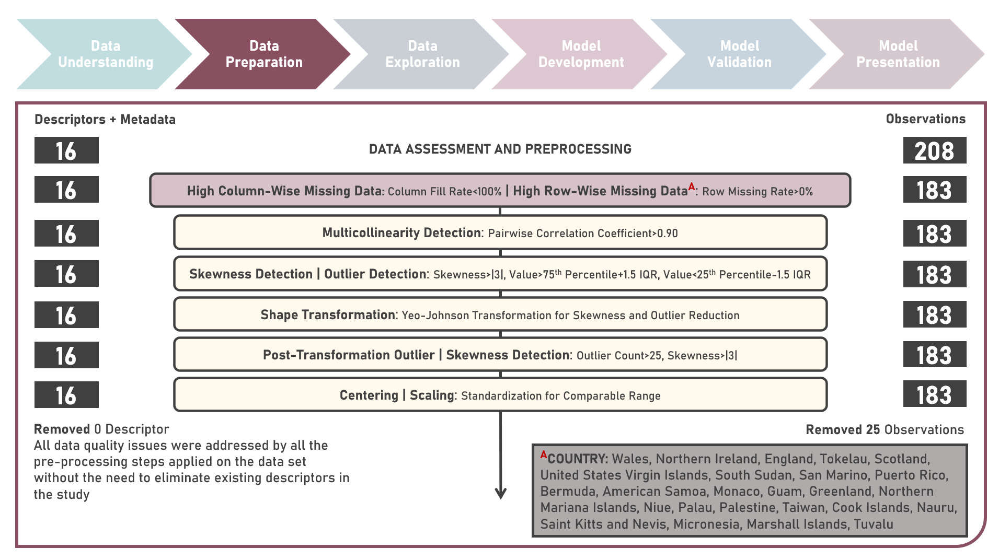

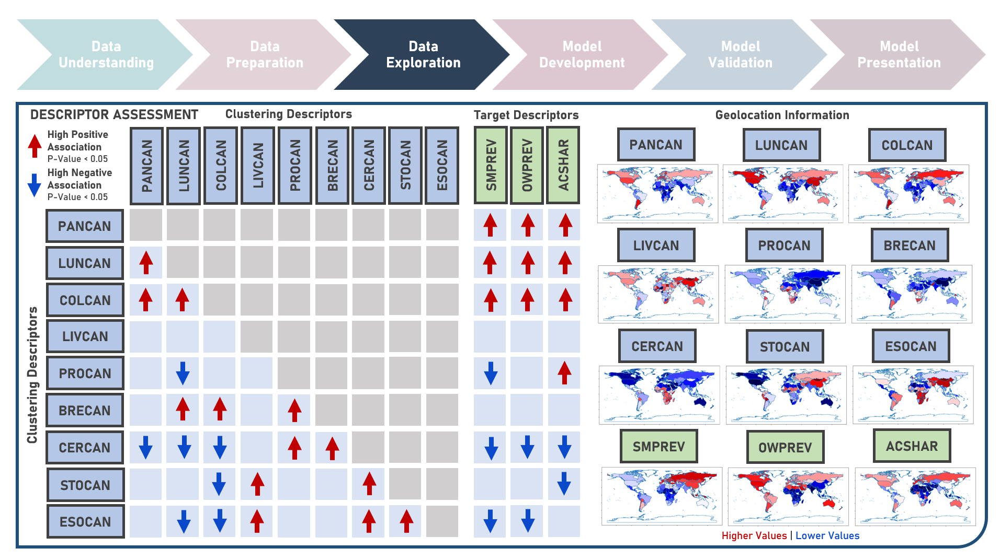

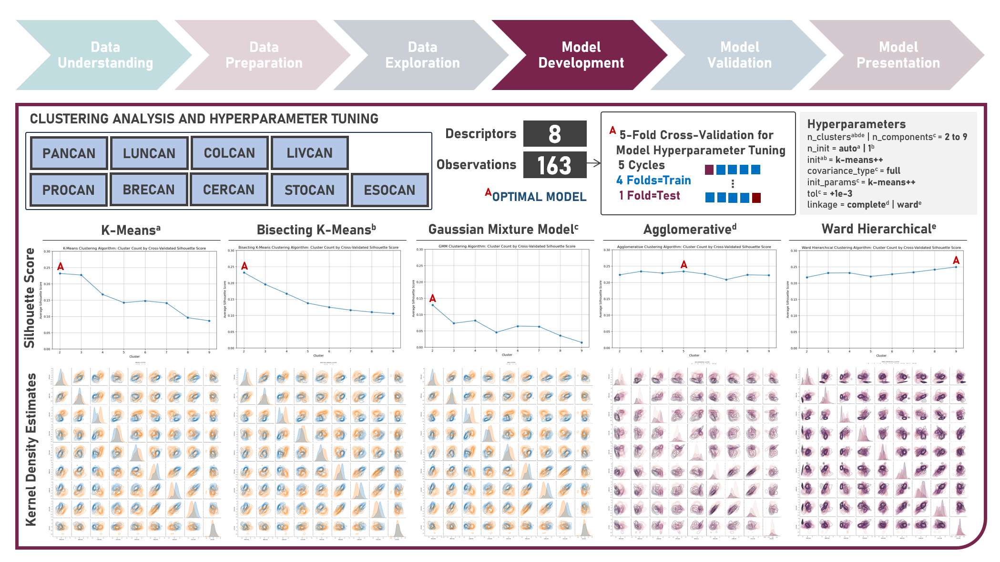

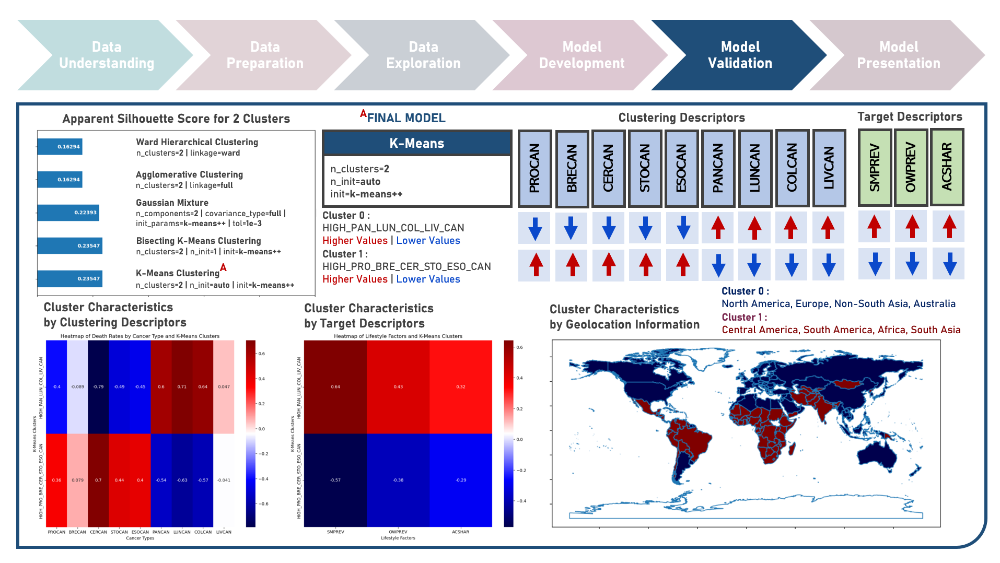

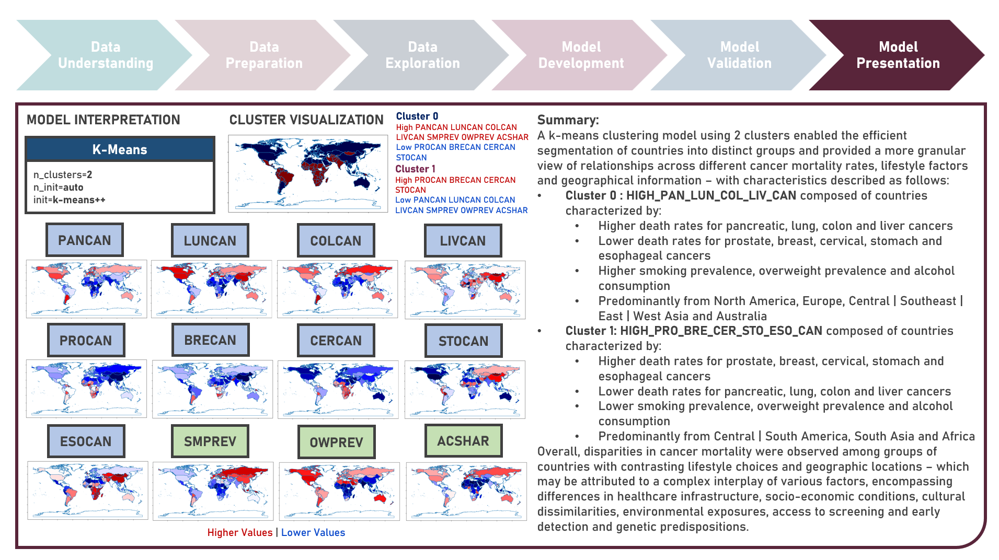

# 3. References <a class="anchor" id="References"></a>
* **[Book]** [Data Preparation for Machine Learning: Data Cleaning, Feature Selection, and Data Transforms in Python](https://machinelearningmastery.com/data-preparation-for-machine-learning/) by Jason Brownlee
* **[Book]** [Feature Engineering and Selection: A Practical Approach for Predictive Models](http://www.feat.engineering/) by Max Kuhn and Kjell Johnson
* **[Book]** [Feature Engineering for Machine Learning](https://www.oreilly.com/library/view/feature-engineering-for/9781491953235/) by Alice Zheng and Amanda Casari
* **[Book]** [Applied Predictive Modeling](https://link.springer.com/book/10.1007/978-1-4614-6849-3?page=1) by Max Kuhn and Kjell Johnson
* **[Book]** [Data Mining: Practical Machine Learning Tools and Techniques](https://www.sciencedirect.com/book/9780123748560/data-mining-practical-machine-learning-tools-and-techniques?via=ihub=) by Ian Witten, Eibe Frank, Mark Hall and Christopher Pal 
* **[Book]** [Data Cleaning](https://dl.acm.org/doi/book/10.1145/3310205) by Ihab Ilyas and Xu Chu
* **[Book]** [Data Wrangling with Python](https://www.oreilly.com/library/view/data-wrangling-with/9781491948804/) by Jacqueline Kazil and Katharine Jarmul
* **[Book]** [Finding Groups in Data: An Introduction to Cluster Analysis](https://onlinelibrary.wiley.com/doi/book/10.1002/9780470316801) by Leonard Kaufman and Peter Rousseeuw
* **[Book]** [The Elements of Statistical Learning](https://link.springer.com/book/10.1007/978-0-387-84858-7) by Trevor Hastie, Robert Tibshirani and Jerome Friedman
* **[Book]** [Training Systems using Python Statistical Modeling](https://www.packtpub.com/product/training-systems-using-python-statistical-modeling/9781838823733) by Curtis Miller
* **[Book]** [Python Data Science Handbook](https://www.oreilly.com/library/view/python-data-science/9781098121211/) by Jake VanderPlas
* **[Book]** [Theory of Agglomerative Hierarchical Clustering](https://link.springer.com/book/10.1007/978-981-19-0420-2) by Sadaaki Miyamoto
* **[Python Library API]** [NumPy](https://numpy.org/doc/) by NumPy Team
* **[Python Library API]** [pandas](https://pandas.pydata.org/docs/) by Pandas Team
* **[Python Library API]** [seaborn](https://seaborn.pydata.org/) by Seaborn Team
* **[Python Library API]** [matplotlib.pyplot](https://matplotlib.org/3.5.3/api/_as_gen/matplotlib.pyplot.html) by MatPlotLib Team
* **[Python Library API]** [itertools](https://docs.python.org/3/library/itertools.html) by Python Team
* **[Python Library API]** [operator](https://docs.python.org/3/library/operator.html) by Python Team
* **[Python Library API]** [sklearn.preprocessing](https://scikit-learn.org/stable/modules/classes.html#module-sklearn.preprocessing) by Scikit-Learn Team
* **[Python Library API]** [sklearn.metrics](https://scikit-learn.org/stable/modules/model_evaluation.html) by Scikit-Learn Team
* **[Python Library API]** [sklearn.cluster](https://scikit-learn.org/stable/modules/clustering.html) by Scikit-Learn Team
* **[Python Library API]** [sklearn.mixture](https://scikit-learn.org/stable/modules/mixture.html) by Scikit-Learn Team
* **[Python Library API]** [SciPy](https://docs.scipy.org/doc/scipy/) by SciPy Team
* **[Python Library API]** [GeoPandas](https://geopandas.org/en/stable/docs.html) by GeroPandas Team
* **[Article]** [Step-by-Step Exploratory Data Analysis (EDA) using Python](https://www.analyticsvidhya.com/blog/2022/07/step-by-step-exploratory-data-analysis-eda-using-python/#:~:text=Exploratory%20Data%20Analysis%20(EDA)%20with,distributions%20using%20Python%20programming%20language.) by Malamahadevan Mahadevan (Analytics Vidhya)
* **[Article]** [Exploratory Data Analysis in Python — A Step-by-Step Process](https://towardsdatascience.com/exploratory-data-analysis-in-python-a-step-by-step-process-d0dfa6bf94ee) by Andrea D'Agostino (Towards Data Science)
* **[Article]** [Exploratory Data Analysis with Python](https://medium.com/@douglas.rochedo/exploratory-data-analysis-with-python-78b6c1d479cc) by Douglas Rocha (Medium)
* **[Article]** [4 Ways to Automate Exploratory Data Analysis (EDA) in Python](https://builtin.com/data-science/EDA-python) by Abdishakur Hassan (BuiltIn)
* **[Article]** [10 Things To Do When Conducting Your Exploratory Data Analysis (EDA)](https://www.analyticsvidhya.com) by Alifia Harmadi (Medium)
* **[Article]** [How to Handle Missing Data with Python](https://machinelearningmastery.com/handle-missing-data-python/) by Jason Brownlee (Machine Learning Mastery)
* **[Article]** [Statistical Imputation for Missing Values in Machine Learning](https://machinelearningmastery.com/statistical-imputation-for-missing-values-in-machine-learning/) by Jason Brownlee (Machine Learning Mastery)
* **[Article]** [Imputing Missing Data with Simple and Advanced Techniques](https://towardsdatascience.com/imputing-missing-data-with-simple-and-advanced-techniques-f5c7b157fb87) by Idil Ismiguzel (Towards Data Science)
* **[Article]** [Missing Data Imputation Approaches | How to handle missing values in Python](https://www.machinelearningplus.com/machine-learning/missing-data-imputation-how-to-handle-missing-values-in-python/) by Selva Prabhakaran (Machine Learning +)
* **[Article]** [Master The Skills Of Missing Data Imputation Techniques In Python(2022) And Be Successful](https://medium.com/analytics-vidhya/a-quick-guide-on-missing-data-imputation-techniques-in-python-2020-5410f3df1c1e) by Mrinal Walia (Analytics Vidhya)
* **[Article]** [How to Preprocess Data in Python](https://builtin.com/machine-learning/how-to-preprocess-data-python) by Afroz Chakure (BuiltIn)
* **[Article]** [Easy Guide To Data Preprocessing In Python](https://www.kdnuggets.com/2020/07/easy-guide-data-preprocessing-python.html) by Ahmad Anis (KDNuggets)
* **[Article]** [Data Preprocessing in Python](https://towardsdatascience.com/data-preprocessing-in-python-b52b652e37d5) by Tarun Gupta (Towards Data Science)
* **[Article]** [Data Preprocessing using Python](https://medium.com/@suneet.bhopal/data-preprocessing-using-python-1bfee9268fb3) by Suneet Jain (Medium)
* **[Article]** [Data Preprocessing in Python](https://medium.com/@abonia/data-preprocessing-in-python-1f90d95d44f4) by Abonia Sojasingarayar (Medium)
* **[Article]** [Data Preprocessing in Python](https://medium.datadriveninvestor.com/data-preprocessing-3cd01eefd438) by Afroz Chakure (Medium)
* **[Article]** [Detecting and Treating Outliers | Treating the Odd One Out!](https://www.analyticsvidhya.com/blog/2021/05/detecting-and-treating-outliers-treating-the-odd-one-out/) by Harika Bonthu (Analytics Vidhya)
* **[Article]** [Outlier Treatment with Python](https://medium.com/analytics-vidhya/outlier-treatment-9bbe87384d02) by Sangita Yemulwar (Analytics Vidhya)
* **[Article]** [A Guide to Outlier Detection in Python](https://builtin.com/data-science/outlier-detection-python) by Sadrach Pierre (BuiltIn)
* **[Article]** [How To Find Outliers in Data Using Python (and How To Handle Them)](https://careerfoundry.com/en/blog/data-analytics/how-to-find-outliers/) by Eric Kleppen (Career Foundry)
* **[Article]** [Statistics in Python — Collinearity and Multicollinearity](https://towardsdatascience.com/statistics-in-python-collinearity-and-multicollinearity-4cc4dcd82b3f) by Wei-Meng Lee (Towards Data Science)
* **[Article]** [Understanding Multicollinearity and How to Detect it in Python](https://towardsdatascience.com/everything-you-need-to-know-about-multicollinearity-2f21f082d6dc) by Terence Shin (Towards Data Science)
* **[Article]** [A Python Library to Remove Collinearity](https://www.yourdatateacher.com/2021/06/28/a-python-library-to-remove-collinearity/) by Gianluca Malato (Your Data Teacher)
* **[Article]** [8 Best Data Transformation in Pandas](https://ai.plainenglish.io/data-transformation-in-pandas-29b2b3c61b34) by Tirendaz AI (Medium)
* **[Article]** [Data Transformation Techniques with Python: Elevate Your Data Game!](https://medium.com/@siddharthverma.er.cse/data-transformation-techniques-with-python-elevate-your-data-game-21fcc7442cc2) by Siddharth Verma (Medium)
* **[Article]** [Data Scaling with Python](https://www.kdnuggets.com/2023/07/data-scaling-python.html) by Benjamin Obi Tayo (KDNuggets)
* **[Article]** [How to Use StandardScaler and MinMaxScaler Transforms in Python](https://machinelearningmastery.com/standardscaler-and-minmaxscaler-transforms-in-python/) by Jason Brownlee (Machine Learning Mastery)
* **[Article]** [Feature Engineering: Scaling, Normalization, and Standardization](https://www.analyticsvidhya.com/blog/2020/04/feature-scaling-machine-learning-normalization-standardization/) by Aniruddha Bhandari  (Analytics Vidhya)
* **[Article]** [How to Normalize Data Using scikit-learn in Python](https://www.digitalocean.com/community/tutorials/normalize-data-in-python) by Jayant Verma (Digital Ocean)
* **[Article]** [What are Categorical Data Encoding Methods | Binary Encoding](https://www.analyticsvidhya.com/blog/2020/08/types-of-categorical-data-encoding/) by Shipra Saxena  (Analytics Vidhya)
* **[Article]** [Guide to Encoding Categorical Values in Python](https://pbpython.com/categorical-encoding.html) by Chris Moffitt (Practical Business Python)
* **[Article]** [Categorical Data Encoding Techniques in Python: A Complete Guide](https://soumenatta.medium.com/categorical-data-encoding-techniques-in-python-a-complete-guide-a913aae19a22) by Soumen Atta (Medium)
* **[Article]** [Categorical Feature Encoding Techniques](https://towardsdatascience.com/categorical-encoding-techniques-93ebd18e1f24) by Tara Boyle (Medium)
* **[Article]** [Ordinal and One-Hot Encodings for Categorical Data](https://machinelearningmastery.com/one-hot-encoding-for-categorical-data/) by Jason Brownlee (Machine Learning Mastery)
* **[Article]** [Hypothesis Testing with Python: Step by Step Hands-On Tutorial with Practical Examples](https://towardsdatascience.com/hypothesis-testing-with-python-step-by-step-hands-on-tutorial-with-practical-examples-e805975ea96e) by Ece Işık Polat (Towards Data Science)
* **[Article]** [17 Statistical Hypothesis Tests in Python (Cheat Sheet)](https://machinelearningmastery.com/statistical-hypothesis-tests-in-python-cheat-sheet/) by Jason Brownlee (Machine Learning Mastery)
* **[Article]** [A Step-by-Step Guide to Hypothesis Testing in Python using Scipy](https://medium.com/@gabriel_renno/a-step-by-step-guide-to-hypothesis-testing-in-python-using-scipy-8eb5b696ab07) by Gabriel Rennó (Medium)
* **[Article]** [10 Clustering Algorithms With Python](https://machinelearningmastery.com/clustering-algorithms-with-python/) by Jason Brownlee (Machine Learning Mastery)
* **[Article]** [Elbow Method for Optimal Value of K in KMeans](https://www.geeksforgeeks.org/elbow-method-for-optimal-value-of-k-in-kmeans/) by Geeks For Geeks Team (Geeks For Geeks)
* **[Article]** [How to Use the Elbow Method in Python to Find Optimal Clusters](https://www.statology.org/elbow-method-in-python/) by Statology Team (Statology)
* **[Article]** [Tutorial: How to Determine the Optimal Number of Clusters for K-Means Clustering](https://blog.cambridgespark.com/how-to-determine-the-optimal-number-of-clusters-for-k-means-clustering-14f27070048f) by Tola Alade (Cambridge Spark)
* **[Article]** [Optimizing Cluster Hyperparameters: Elbow and Silhouette Method](https://eightify.app/summary/data-science-and-analytics/optimizing-cluster-hyperparameters-elbow-silhouette-method) by Lucas Parisi (Eightify)
* **[Article]** [Clustering Metrics Better Than the Elbow Method](https://www.kdnuggets.com/2019/10/clustering-metrics-better-elbow-method.html) by Tirthajyoti Sarkar (KD Nuggets)
* **[Article]** [Practical Implementation Of K-means, Hierarchical, and DBSCAN Clustering On Dataset With Hyperparameter Optimization](https://medium.com/analytics-vidhya/practical-implementation-of-k-means-hierarchical-and-dbscan-clustering-on-dataset-with-bd7f3d13ef7f) by Janibasha Shaik (Towards Data Science)
* **[Article]** [KMeans Hyper-parameters Explained with Examples](https://towardsdatascience.com/kmeans-hyper-parameters-explained-with-examples-c93505820cd3) by Sujeewa Kumaratunga (Towards Data Science)
* **[Article]** [KMeans Silhouette Score Python Examples](https://vitalflux.com/kmeans-silhouette-score-explained-with-python-example/#google_vignette) by Ajitesh Kumar (Analytics Yogi)
* **[Publication]** [A Comparison of Document Clustering Techniques](https://www.semanticscholar.org/paper/A-Comparison-of-Document-Clustering-Techniques-Steinbach-Karypis/9378a3797d5f815babe7b392a199ea9d8d4f1dcf) by Michael Steinbach, George Karypis and Vipin Kumar (Computer Science)
* **[Course]** [IBM Data Analyst Professional Certificate](https://www.coursera.org/professional-certificates/ibm-data-analyst) by IBM Team (Coursera)
* **[Course]** [IBM Data Science Professional Certificate](https://www.coursera.org/professional-certificates/ibm-data-science) by IBM Team (Coursera)
* **[Course]** [IBM Machine Learning Professional Certificate](https://www.coursera.org/professional-certificates/ibm-machine-learning) by IBM Team (Coursera)


In [222]:
from IPython.display import display, HTML
display(HTML("<style>.rendered_html { font-size: 15px; font-family: 'Trebuchet MS'; }</style>"))

***